<a href="https://colab.research.google.com/github/dannygallagher/Covid-Segmentation-of-CT-Scans/blob/main/CIS_522_Final_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install nibabel

In [ ]:
!pip install torchio
!pip install torchio[plot]

     |████████████████████████████████| 165 kB 5.1 MB/s 
     |████████████████████████████████| 48.4 MB 27 kB/s 


In [ ]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Sat Apr 30 03:42:02 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   34C    P0    29W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

# Data Loading

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# imports
import random
import pathlib

import torch
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import torchvision.transforms as transforms
from torchvision.datasets import ImageFolder
import torchvision.datasets as datasets
from torch.utils.data import Dataset, DataLoader, TensorDataset
from torchvision.utils import make_grid
from IPython.display import HTML, display

from tqdm.notebook import tqdm, trange
from time import sleep

#library for loading our image data from .nii.gz format
import nibabel as nib

#library for transformations that is supposed to be significantly faster than native Pytorch Transforms
import albumentations as A
import torchio as tio

from tqdm import tqdm
import os

## Creating a Custom Dataset and performing one-hot encoding and binarization

We will create our own custom dataset, since using the mask as a label is a bit more complicated than assigning a single number to each image file. Each item in the dataset returns an image, a mask, a one-hot encoded mask, and a binarized mask, since we are interested in both the multi-class and binary classification problems.

The dataset also differentiates between spatial and non-spatial transformations for image augmentation. This is because spatial transformations can (and should) be applied to the mask without fundamentally altering the meaning of the labels, whereas transformations like color and noise cannot.

Our image data has already been partially preprocessed according to https://medium.com/@hbjenssen/covid-19-radiology-data-collection-and-preparation-for-artificial-intelligence-4ecece97bb5b. Perhaps the most important steps of this procedure were to resize all of the images to 512x512 and to normalize the images to the unified Hounsfield-Unit scale (HU), which helps distinguish between air and fat (tissue) on the CT, as the former is normalized to -1000 HU and the latter -100 HU. After exploring the data as well as several other studies that used CTs for segmentation, we determined that there were not any additional preprocessing steps necessary to implement. 

We allow for 3 additional steps:

-Resizing the images to 256x256 to increase speed and match Saood & Hatem (2021)

-Clipping the HU values below -1250 and above +250, which was done by Müller, Soto-Rey, and Kramer (2021) in an attempt to exploit the fact that we are only interested in certain HU ranges (infected regions (+50 to +100 HU) and lung regions (−1000 to −700 HU)).

-Normalizing the HU values to a range between 0 and 1 to allow our network to work with smaller values and avoid potential gradient problems with large numbers


Note: There are two sets of dataset classes and augmentations here, each using a different augmentation framework and a slightly different way of going about the transformations. We ended up going with the first Dataset, using tio for its augmentations, as the transformations seemed more stable in many cases, but wanted to keep both here to test for potential differences in speed, etc.

In [ ]:
class ImageDataset(Dataset):
    def __init__(self, data_dir = '/content/drive/Shareddrives/CIS 522 Final Project/data', image_path= '/tr_im.nii.gz', mask_path = '/tr_mask.nii.gz', annot_file = 'Test-Images-Clinical-Details.csv', spatial_transform=None, nonspatial_transform=None, train = True, train_size = 72, shuffle = True, all_data = False, normalize = False, crop = (0,0), resize = 512, clipping = False, mask_type = 'raw'):
        self.data_dir = data_dir
        self.annot_file = data_dir + annot_file

        #set the paths to the images and to the masks
        self.image_path = data_dir + image_path
        self.mask_path = data_dir + mask_path


        self.images = tio.ScalarImage(self.image_path).data
        self.masks = tio.LabelMap(self.mask_path).data

        self.train = train
        self.train_size = train_size

        self.normalize = normalize
        #self.normalize_transform = transforms.Compose([transforms.Normalize(0,1)])
        if clipping:
          self.normalize = tio.RescaleIntensity(out_min_max=(0, 1), in_min_max=(-1250, 250))
        else:
          self.normalize = tio.RescaleIntensity(out_min_max=(0, 1))
        self.resize = resize
        #self.resize_transform = A.Resize(resize, resize, always_apply= True)
        self.resize_transform = tio.Resize((resize, resize, 1))

        self.crop_w, self.crop_h = crop
        self.crop_transform = tio.Crop(cropping = (self.crop_w, self.crop_h, 0))

        self.clipping = clipping

        #We need to split our dataset now, since we only want to apply augmentations to training data
        # We don't have the need to do anything too fancy in our sampling.
        # For simplicity, we will simply shuffle an array of indices equal to the number of images, then 
        # grab the first x for the training set and the remaining for the test.
        indices = np.arange(self.images.shape[3])

        # In actual training, this will default to true, but I wanted to allow us to view images in order
        # To better examine how transforms were applying to images and corresponding masks.
        if shuffle:
          np.random.shuffle(indices)

        train_indices = indices[:self.train_size]
        test_indices = indices[self.train_size:]

        # This is if we want to look at all of the data, for exploration purposes
        if all_data:
          train_indices = indices[:]
          test_indices = indices[:]
      
        self.train_images = self.images[:,:,:,train_indices]
        self.train_masks = self.masks[:,:,:,train_indices]

        self.test_images = self.images[:,:,:,test_indices]
        self.test_masks = self.masks[:,:,:,test_indices]

        self.spatial_transform = spatial_transform
        self.nonspatial_transform = nonspatial_transform

        self.mask_type = mask_type

  
        
    def __len__(self):
      '''
      Simply returns the number of objects in the dataset
      '''
      if self.train:
        return self.train_size
      else:
        return self.images.shape[3] - self.train_size
    
  
    def __getitem__(self, idx):
        '''
        Returns the end objects of our dataset, which we want to be tensors
        '''

        image = self.train_images[:,:,:,idx].unsqueeze(3)
        mask = self.train_masks[:,:,:,idx].unsqueeze(3)

        subject = tio.Subject(
            image = tio.ScalarImage(tensor=image),
            mask = tio.LabelMap(tensor=mask)
        )

        if self.crop_w != 0 or self.crop_h !=0:
            subject = self.crop_transform(subject)
            
        if self.resize != 512:
            subject = self.resize_transform(subject)

        if self.normalize:
            subject = self.normalize(subject)
        
        #distignuish between train and test images, as we only apply augmentations to train data
        if self.train:

          #Apply transforms. Masks only get spatial transforms
          if self.spatial_transform:
              subject = self.spatial_transform(subject)

          if self.nonspatial_transform:
              subject = self.nonspatial_transform(subject)



        image = subject['image'].data
        mask = subject['mask'].data

       

        image = image.squeeze()
        mask = mask.long().squeeze()

        #print(mask.size())
        

        #Set up one-hot-encoding and binarizing for different classification schemes
        #Done after any transforms
        if self.mask_type == 'binary':
          mask = torch.where(mask == 0, mask, 1)
          mask = F.one_hot(mask, num_classes = 2)
          mask = mask.permute(2,0,1)
        elif self.mask_type == 'one_hot':
          mask = F.one_hot(mask, num_classes = 4)
          mask = mask.permute(2,0,1)
          #print(mask.size())
        else:
          mask = mask.unsqueeze(0)

        image = image.unsqueeze(0).float()
        mask = mask.float()

        return image, mask
    
  

In [ ]:
#Here is another implementation of the dataset, this time doing a lot of the 
#data manipulation on numpy arrays rather than tensors, and using the Albumentations
#package for augmentation instead of Albumentations. I wanted to see if one method was 
#significantly faster than the other

class ImageDataset_A(Dataset):
    def __init__(self, data_dir = '/content/drive/Shareddrives/CIS 522 Final Project/data', image_path= '/tr_im.nii.gz', mask_path = '/tr_mask.nii.gz', annot_file = 'Test-Images-Clinical-Details.csv', spatial_transform=None, nonspatial_transform=None, train = True, train_size = 72, shuffle = True, all_data = False, normalize = False, resize = 512, clipping = False, mask_type = 'raw'):
        self.data_dir = data_dir
        self.annot_file = data_dir + annot_file

        #set the paths to the images and to the masks
        self.image_path = data_dir + image_path
        self.mask_path = data_dir + mask_path

        self.images = nib.load(self.image_path).get_fdata()
        self.masks = nib.load(self.mask_path).get_fdata()

        self.subject = tio.Subject(
            image=tio.ScalarImage(self.image_path),
            mask=tio.LabelMap(self.mask_path),
        )

        self.train = train
        self.train_size = train_size

        self.normalize = normalize
        self.normalize_transform = transforms.Compose([transforms.Normalize(0,1)])
        self.resize = resize
        self.resize_transform = A.Resize(resize, resize, always_apply= True)
        self.clipping = clipping

        #We need to split our dataset now, since we only want to apply augmentations to training data
        # We don't have the need to do anything too fancy in our sampling.
        # For simplicity, we will simply shuffle an array of indices equal to the number of images, then 
        # grab the first x for the training set and the remaining for the test.
        indices = np.arange(self.images.shape[2])

        # In actual training, this will default to true, but I wanted to allow us to view images in order
        # To better examine how transforms were applying to images and corresponding masks.
        if shuffle:
          np.random.shuffle(indices)

        train_indices = indices[:self.train_size]
        test_indices = indices[self.train_size:]

        # This is if we want to look at all of the data, for exploration purposes
        if all_data:
          train_indices = indices[:]
          test_indices = indices[:]
      
        self.train_images = self.images[:,:,train_indices]
        self.train_masks = self.masks[:,:,train_indices]

        self.test_images = self.images[:,:,test_indices]
        self.test_masks = self.masks[:,:,test_indices]

        self.spatial_transform = spatial_transform
        self.nonspatial_transform = nonspatial_transform

        self.mask_type = mask_type

  
        
    def __len__(self):
      '''
      Simply returns the number of objects in the dataset
      '''
      if self.train:
        return self.train_size
      else:
        return self.images.shape[2] - self.train_size
    
  
    def __getitem__(self, idx):
        '''
        Returns the end objects of our dataset, which we want to be tensors
        '''

        #distignuish between train and test images, as we only apply transforms to train data
        if self.train:

          # Not sure how we want to format our labels here. Just take the full mask?

          image = self.train_images[:,:,idx]
          mask = self.train_masks[:,:,idx]

          #First, resize the images if we want to do so. We probably do to 256x256 to keep consistent with Saood and Hatem,
          #and to reduce processing time. However, I wonder if instead of downscaling, it is
          #better to crop the side, which seems like might have been done in Chen, Yao, and Zhang (2020)
          #in an attempt to reduce edge and letter artifacts. It was hard to tell exactly
          #what they did, though, and I worry about cropping important data.

          if self.resize != 512:
            transformed_image = self.resize_transform(image = image, mask = mask)
            image = transformed_image['image']
            mask = transformed_image['mask']
          
          #clip intensity values according to Muller, Soto-Rey, and Kramer (2021)
          # This is meant to take advantage of the fact that we are only interested in certain
          # HU ranges
        
          if self.clipping:
            image = np.clip(image, -1250, 250)

          #Apply transforms. Masks only get spatial transforms
          if self.spatial_transform:
              transformed_image = self.spatial_transform(image = image, mask = mask)
              image = transformed_image['image']
              mask = transformed_image['mask']
          
          if self.nonspatial_transform:
              transformed_image = self.nonspatial_transform(image = image)
              image = transformed_image['image']
        else:
           image = self.test_images[:,:,idx]
           mask = self.test_masks[:,:,idx]

        #convert to tensors. If we want to normalize, use ToTensor to normalize between 0 and 1
   

        image = torch.tensor(image).squeeze()
        #using long to work with one hot encoding
        mask = torch.tensor(mask, dtype = torch.long).squeeze()

        if self.normalize:
          #note, ToTensor changes place of 3rd and 1st index, but shouldn't matter since squeeze removes all dimensions of size 1
          #image = self.normalize_transform(image.unsqueeze(0))
          #image = image.squeeze()
          #image = F.normalize(image)
          image -= image.min(1, keepdim=True)[0]
          image /= image.max(1, keepdim=True)[0]

        
        #Set up one-hot-encoding and binarizing for different classification schemes
        #Done after any transforms
        if self.mask_type == 'binary':
          mask = torch.where(mask == 0, mask, 1)
        elif self.mask_type == 'one_hot':
          mask = F.one_hot(mask, num_classes = 4)

        image = image.unsqueeze(0)
        mask = mask.unsqueeze(0).float()

        return image, mask
    
  

## Augmentations

We use the Albumentations package for our augmentation, as it is supposed to be significantly faster than native Pytorch transforms.

The transformations used were mainly based on Muller, Soto-Rey, and Kramer (2021)

In [ ]:
spatial_transform = tio.Compose([
                                 tio.RandomFlip(1, p = .3),
                                 tio.RandomAffine(scales = (0.75, 1.5), 
                                                  degrees = (5, 355),
                                                  isotropic = True,
                                                  center = 'image',
                                                  p = 0.4),
                                 tio.RandomElasticDeformation(num_control_points= 5, max_displacement= 2, p = .2)])
nonspatial_transform = tio.Compose([
                                 tio.RandomNoise(mean= 0, std= (.25, 1), p=.2),
                                 tio.RandomGamma(log_gamma=(-.5,.5), p=.2)  
])

In [ ]:
#Note, default probability for transforms is .5
spatial_transform_A = A.Compose([
    #Spatial transforms
    A.ElasticTransform(p=0.3),
    #A.RandomRotate90(),
    #A.Rotate(),
    #A.RandomScale(),
    A.ShiftScaleRotate(shift_limit=0, p =0.5), #just rotate and scale,
    A.HorizontalFlip(p=0.5)
])

nonspatial_transform_A = A.Compose([   
    #I was having trouble finding appropriate values for these for CTs, and decided to lower the scale, especially of gamma,
    #of the transformations from default, as some of the images seemed to become essentially unrecognizable 

    #Color transforms
    #A.RandomBrightnessContrast(brightness_limit = .03, contrast_limit = .03, p=0.2),
    A.RandomGamma(gamma_limit = (98,102), p=0.3),
    #Noise transforms
    A.GaussNoise(var_limit = (10,40), p=0.3)
])




## Data splitting and Data Loaders

Split data and set up data loaders. This split was based on Saood & Hatem (2021) in an effort to make comparisons between our results easier.

In [ ]:
torch.manual_seed(522)
train_data = ImageDataset(spatial_transform = spatial_transform, nonspatial_transform = nonspatial_transform, train = True, train_size=72, resize = 256, clipping = True, normalize= True, mask_type = "one_hot")
test_data = ImageDataset(spatial_transform = spatial_transform, nonspatial_transform = nonspatial_transform, train = False, train_size=72, normalize = False, mask_type = "one_hot")

#split validation data and test data
validation_data, test_data = torch.utils.data.random_split(test_data, [10, 18])

We are likely interested in both the multi-class problem as well as the binary classification problem (infected vs non-infected lung), so let's set up some binarized data, then one-hot-encode our multi-class data

In [ ]:
train_loader = DataLoader(train_data, batch_size= 12,
                         shuffle=True, num_workers=0)
validation_loader = DataLoader(validation_data, batch_size=5,
                         shuffle=True, num_workers=0)
test_loader = DataLoader(test_data, batch_size=9,
                         shuffle=True, num_workers=0)

# Data exploration

## Raw Data Exploration

In [ ]:
explore_data = ImageDataset(train = True, shuffle = False, normalize = False)

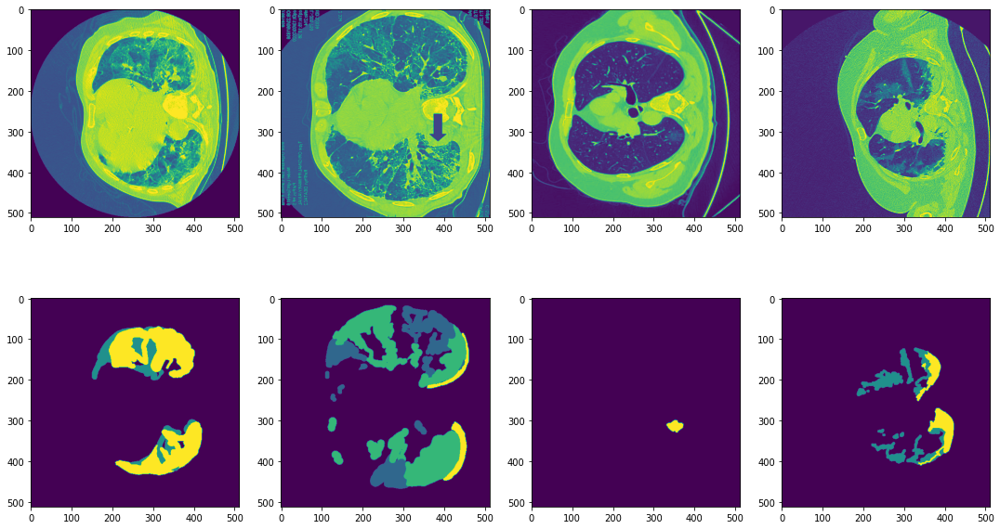

In [ ]:
fig, ((ax1, ax2, ax3, ax4), (ax5, ax6, ax7, ax8)) = plt.subplots(2, 4)
im, mask = explore_data[0]
im1, mask1 = explore_data[1]
im2, mask2 = explore_data[2]
im3, mask3 = explore_data[3]

# squeeze the channel dimension so we can better visualize the images
im = im.squeeze()
im1 = im1.squeeze()
im2 = im2.squeeze()
im3 = im3.squeeze()

mask = mask.squeeze()
mask1 = mask1.squeeze()
mask2 = mask2.squeeze()
mask3 = mask3.squeeze()

ax1.imshow(im)
ax2.imshow(im1)
ax3.imshow(im2)
ax4.imshow(im3)

ax5.imshow(mask)
ax6.imshow(mask1)
ax7.imshow(mask2)
ax8.imshow(mask3)
fig.set_size_inches(18.5, 10.5)
plt.show()

Before we begin, a quick test to make sure the binarization process worked correctly

In [ ]:
explore_data = ImageDataset(train = True, shuffle= False, normalize = False, mask_type = 'binary')

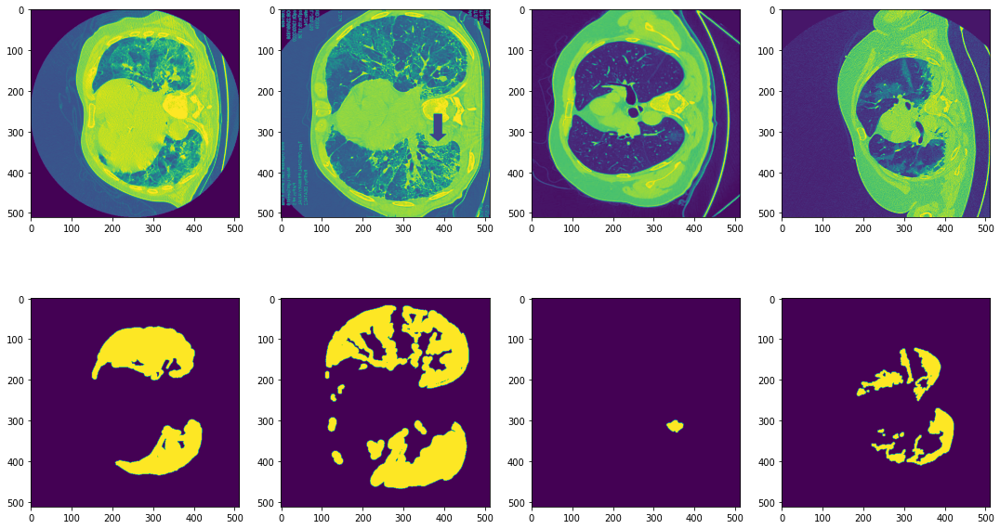

In [ ]:
fig, ((ax1, ax2, ax3, ax4), (ax5, ax6, ax7, ax8)) = plt.subplots(2, 4)
im, mask = explore_data[0]
im1, mask1 = explore_data[1]
im2, mask2 = explore_data[2]
im3, mask3 = explore_data[3]

# squeeze the channel dimension so we can better visualize the images
im = im.squeeze()
im1 = im1.squeeze()
im2 = im2.squeeze()
im3 = im3.squeeze()

mask = mask.squeeze().argmax(0)
mask1 = mask1.squeeze().argmax(0)
mask2 = mask2.squeeze().argmax(0)
mask3 = mask3.squeeze().argmax(0)

ax1.imshow(im)
ax2.imshow(im1)
ax3.imshow(im2)
ax4.imshow(im3)

ax5.imshow(mask)
ax6.imshow(mask1)
ax7.imshow(mask2)
ax8.imshow(mask3)
fig.set_size_inches(18.5, 10.5)
plt.show()

In [ ]:
explore_data = ImageDataset(train = True, shuffle= False, normalize = False)

First, we want to verify that all of our images are in fact either 512x512 (some papers mentioned certain datasets having one oddly wrongly-sized CT). We see that fortunately they are!

In [ ]:
#First, let's just make sure all of our images are in fact 512x512.
size_list = []
for idx in range(len(explore_data)):
  # get sizes of each image and mask, stored in a list
  im_size = [explore_data[idx][0].squeeze().shape[0], explore_data[idx][0].shape[1]]
  mask_size = [explore_data[idx][1].squeeze().shape[0], explore_data[idx][1].shape[1]]
  sizes = im_size + mask_size
  size_list.append(sizes)

np.unique(np.array(size_list))


array([512])

Now let's ensure that our masks only have values of 0-3

In [ ]:
mask_tensor = torch.tensor(masks.get_fdata())
torch.unique(mask_tensor)

tensor([0., 1., 2., 3.], dtype=torch.float64)

We can also graph the values of all of our images to see how they were normalized to Hounsfield units. We should see peaks around -1000 and -100

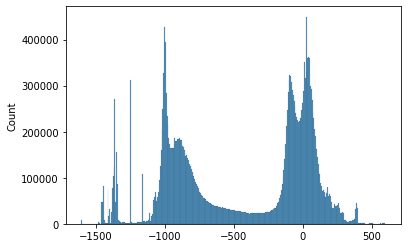

In [ ]:
image_tensor = torch.tensor(images.get_fdata()).flatten().numpy()
sns.histplot(image_tensor)

The peak around +100 might be a little weird, but could be a factor of infected areas of lung potentially manifesting at higher HU than regular fat.

We can also look at the proportions of each class across our dataset

In [ ]:
background_list = []
ground_glass_list = []
consolidation_list = []
pleural_effusion_list = []

for idx in range(len(explore_data)):
  mask = explore_data[idx][1]
  background = (mask == 0).sum()
  ground_glass = (mask == 1).sum()
  consolidation = (mask == 2).sum()
  pleural_effusion = (mask == 3).sum()

  background_list.append(background)
  ground_glass_list.append(ground_glass)
  consolidation_list.append(consolidation)
  pleural_effusion_list.append(pleural_effusion)

print('Average number of pixels for each class:\n')
print(f'background: {np.mean(background_list)}')
print(f'ground_glass: {np.mean(ground_glass_list)}')
print(f'consolidation: {np.mean(consolidation_list)}')
print(f'pleural_effusion: {np.mean(pleural_effusion_list)}')

Average number of pixels for each class:

background: 243712.65277777778
ground_glass: 11936.125
consolidation: 6185.666666666667
pleural_effusion: 309.55555555555554


Text(0.5, 1.0, 'Average number of Pixels Represented in Mask by Class')

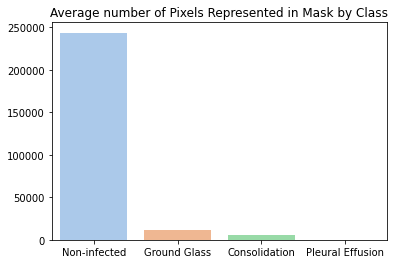

In [ ]:
#plotting above because plots are neat
class_avgs = pd.DataFrame({'Non-infected': [np.mean(background_list)],'Ground Glass': [np.mean(ground_glass_list)],'Consolidation': [np.mean(consolidation_list)], 'Pleural Effusion': [np.mean(pleural_effusion_list)]})
sns.barplot(data=class_avgs, palette = 'pastel')
plt.title('Average number of Pixels Represented in Mask by Class')

In [ ]:
print('proportion of covid vs non-covid:\n')                 

proportion of covid vs non-covid:



We can see that, as we thought, our dataset is quite imbalanced, with non-covid and background class pixels dominating infection pixels. It is important to note that the background class also includes the surrounding lung tissue, in addition to non-infected lung.

This is part of the reason why segnet might be useful for this particular case- as it was designed to segment highly imbalanced environments.

## Testing preprocessing

Now, let's make sure some of our preprocessing steps are working as intended.

We can first visualize the normalized, clipped and resized data.

In [ ]:
explore_data = ImageDataset(train = True, shuffle = False, normalize= True, clipping = True, resize = 256)

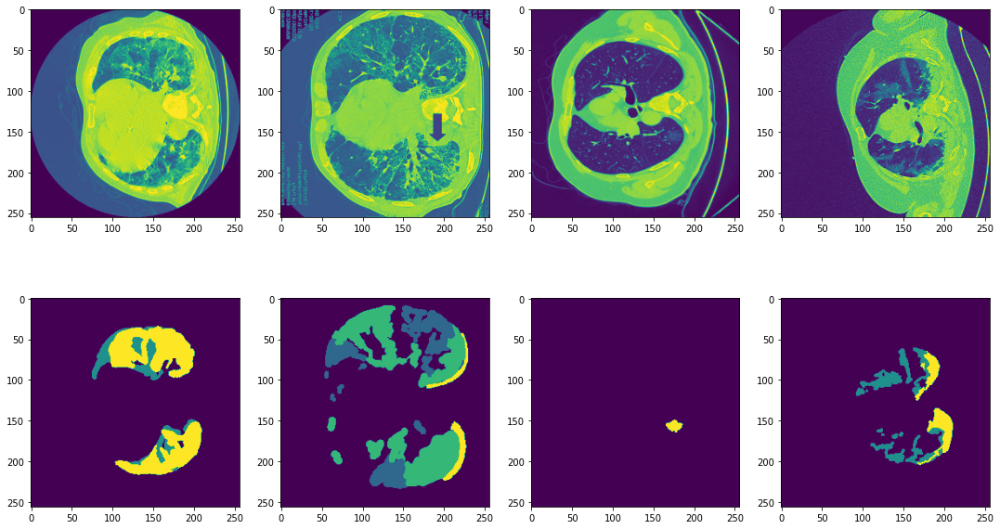

In [ ]:
fig, ((ax1, ax2, ax3, ax4), (ax5, ax6, ax7, ax8)) = plt.subplots(2, 4)
im, mask = explore_data[0]
im1, mask1 = explore_data[1]
im2, mask2 = explore_data[2]
im3, mask3 = explore_data[3]

# squeeze the channel dimension so we can better visualize the images
im = im.squeeze()
im1 = im1.squeeze()
im2 = im2.squeeze()
im3 = im3.squeeze()

mask = mask.squeeze()
mask1 = mask1.squeeze()
mask2 = mask2.squeeze()
mask3 = mask3.squeeze()

ax1.imshow(im)
ax2.imshow(im1)
ax3.imshow(im2)
ax4.imshow(im3)

ax5.imshow(mask)
ax6.imshow(mask1)
ax7.imshow(mask2)
ax8.imshow(mask3)
fig.set_size_inches(18.5, 10.5)
plt.show()

Verify the resizing was done correctly

In [ ]:
#make sure all of our images are 256x256.
size_list = []
for idx in range(len(explore_data)):
  # get sizes of each image and mask, stored in a list
  im_size = [explore_data[idx][0].shape[0], explore_data[idx][0].shape[1]]
  mask_size = [explore_data[idx][1].shape[0], explore_data[idx][1].shape[1]]
  sizes = im_size + mask_size
  size_list.append(sizes)

np.unique(np.array(size_list))


array([  1, 256])

In [ ]:
explore_data = ImageDataset(train = True, normalize= True, shuffle = False, clipping = True, crop = (20,20), resize = 256)

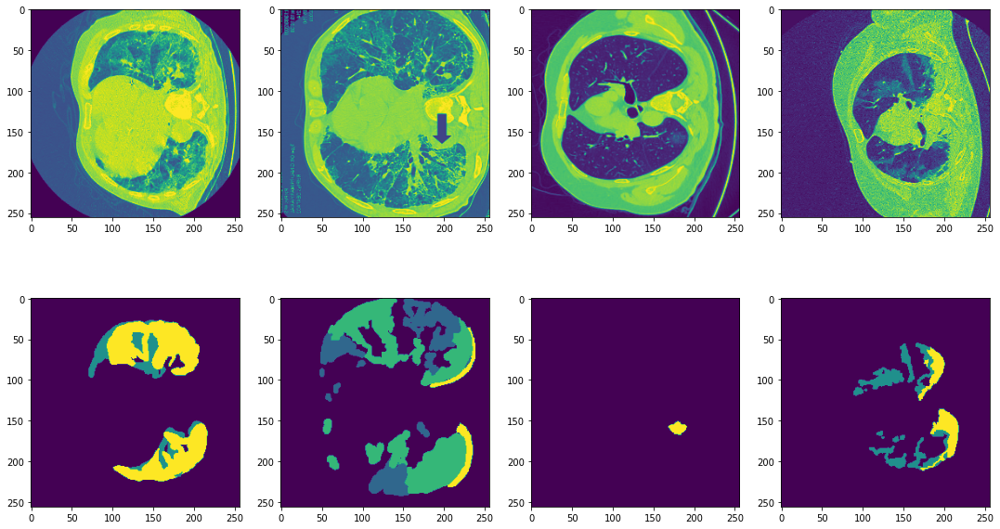

In [ ]:
fig, ((ax1, ax2, ax3, ax4), (ax5, ax6, ax7, ax8)) = plt.subplots(2, 4)
im, mask = explore_data[0]
im1, mask1 = explore_data[1]
im2, mask2 = explore_data[2]
im3, mask3 = explore_data[3]

# squeeze the channel dimension so we can better visualize the images
im = im.squeeze()
im1 = im1.squeeze()
im2 = im2.squeeze()
im3 = im3.squeeze()

mask = mask.squeeze()
mask1 = mask1.squeeze()
mask2 = mask2.squeeze()
mask3 = mask3.squeeze()

ax1.imshow(im)
ax2.imshow(im1)
ax3.imshow(im2)
ax4.imshow(im3)

ax5.imshow(mask)
ax6.imshow(mask1)
ax7.imshow(mask2)
ax8.imshow(mask3)
fig.set_size_inches(18.5, 10.5)
plt.show()

Verify the resizing was done correctly

In [ ]:
#make sure all of our images are 256x256.
size_list = []
for idx in range(len(explore_data)):
  # get sizes of each image and mask, stored in a list
  im_size = [explore_data[idx][0].shape[0], explore_data[idx][0].shape[1]]
  mask_size = [explore_data[idx][1].shape[0], explore_data[idx][1].shape[1]]
  sizes = im_size + mask_size
  size_list.append(sizes)

np.unique(np.array(size_list))


array([  1, 256])

Now let's ensure that our masks only have values of 0-3. In other words, that we didn't fundamentally alter our labels.

In [ ]:
mask_tensor = torch.tensor(masks.get_fdata())
torch.unique(mask_tensor)

tensor([0., 1., 2., 3.], dtype=torch.float64)

Graph the values of an image to make sure they are normalized between 0 and 1

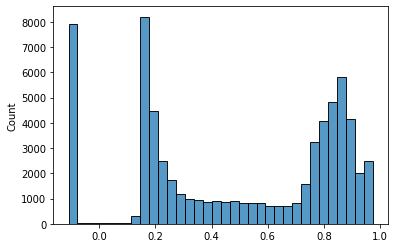

In [ ]:
image_tensor = explore_data[0][0].flatten().numpy()
sns.histplot(image_tensor)

## Testing Augmentations

In a similar way to testing preprocessing, lets examine the affect of our augmentation process.

In [ ]:
explore_data = ImageDataset(train = True, shuffle= False, normalize= True, clipping = True, resize = 256, spatial_transform= spatial_transform, nonspatial_transform = nonspatial_transform)

/usr/local/lib/python3.7/dist-packages/torchio/transforms/augmentation/spatial/random_elastic_deformation.py:263: RuntimeWarning: The maximum displacement is larger than the coarse grid spacing for dimensions: [2], so folding may occur. Choose fewer control points or a smaller maximum displacement
  warnings.warn(message, RuntimeWarning)


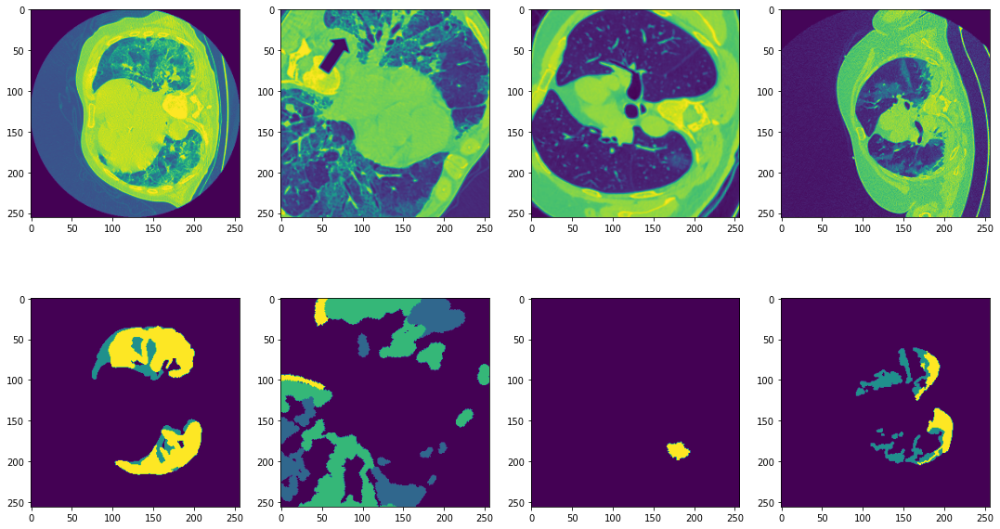

In [ ]:
fig, ((ax1, ax2, ax3, ax4), (ax5, ax6, ax7, ax8)) = plt.subplots(2, 4)
im, mask = explore_data[0]
im1, mask1 = explore_data[1]
im2, mask2 = explore_data[2]
im3, mask3 = explore_data[3]

# squeeze the channel dimension so we can better visualize the images
im = im.squeeze()
im1 = im1.squeeze()
im2 = im2.squeeze()
im3 = im3.squeeze()

mask = mask.squeeze()
mask1 = mask1.squeeze()
mask2 = mask2.squeeze()
mask3 = mask3.squeeze()

ax1.imshow(im)
ax2.imshow(im1)
ax3.imshow(im2)
ax4.imshow(im3)

ax5.imshow(mask)
ax6.imshow(mask1)
ax7.imshow(mask2)
ax8.imshow(mask3)
fig.set_size_inches(18.5, 10.5)
plt.show()

We can clearly see the varying effects of our augmentations, and it also looks like the masks are being correspondingly transformed. But just to make sure, let's look at a side-by-side of the same CT both transformed and ot transformed.

In [ ]:
explore_data = ImageDataset(train = True, shuffle= False, normalize= True, clipping = True, resize = 256, spatial_transform= spatial_transform, nonspatial_transform = nonspatial_transform)

In [ ]:
explore_data2 = ImageDataset(train = True, shuffle=False, all_data = True, normalize= True, clipping = True,  resize = 256)

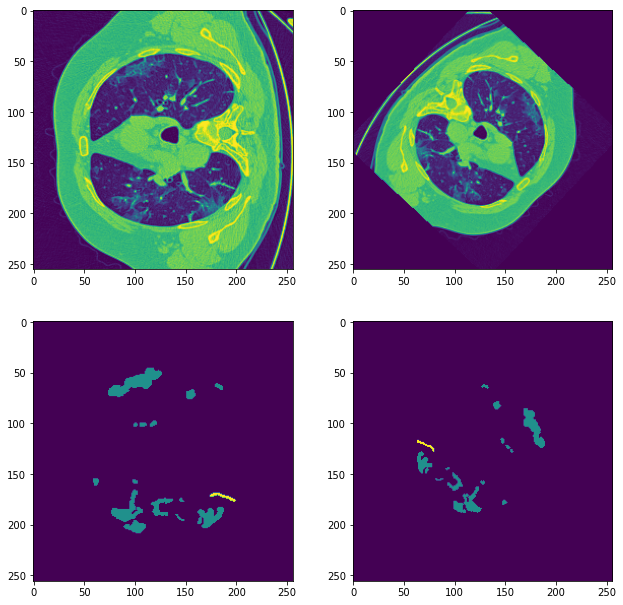

In [ ]:
sample = 20
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2)

im, mask = explore_data[sample]
im2, mask2 = explore_data2[sample]

# squeeze the channel dimension so we can better visualize the images
im = im.squeeze()
im2 = im2.squeeze()

mask = mask.squeeze()
mask2 = mask2.squeeze()


ax1.imshow(im2)
ax2.imshow(im)

ax3.imshow(mask2)
ax4.imshow(mask)
fig.set_size_inches(10.5, 10.5)

plt.show()

As we expected, the mask was correspondingly rotated and scaled up!

The following does the same thing, but for our other dataset scheme using Albumentations

In [ ]:
explore_data_A = ImageDataset_A(train = True, shuffle= False, normalize= True, clipping = True, resize = 256, spatial_transform= spatial_transform_A, nonspatial_transform = nonspatial_transform_A)

In [ ]:
explore_data2A = ImageDataset_A(train = True, shuffle=False, all_data = True, normalize= True, clipping = True,  resize = 256)

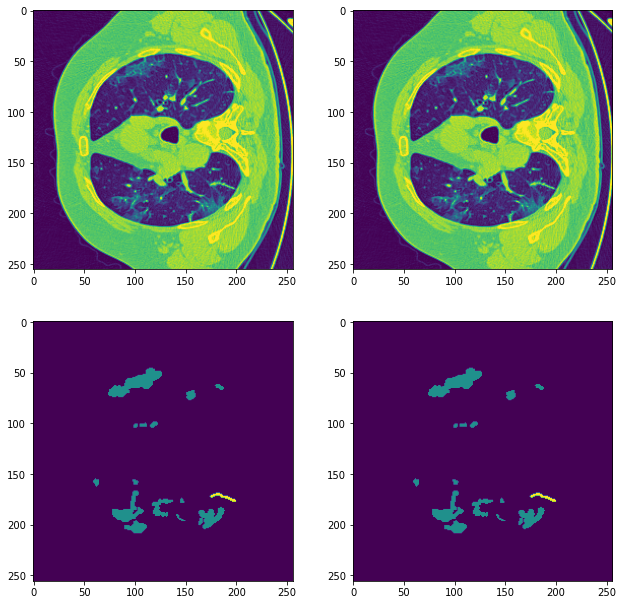

In [ ]:
sample = 20
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2)

im, mask = explore_data_A[sample]
im2, mask2 = explore_data2A[sample]

# squeeze the channel dimension so we can better visualize the images
im = im.squeeze()
im2 = im2.squeeze()

mask = mask.squeeze()
mask2 = mask2.squeeze()


ax1.imshow(im2)
ax2.imshow(im)

ax3.imshow(mask2)
ax4.imshow(mask)
fig.set_size_inches(10.5, 10.5)

plt.show()

As we expected, the mask was correspondingly rotated and scaled up!

Now we recheck the things we did for preprocessing to make sure augmentation didn't break anything.

Verify the resizing was done correctly

In [ ]:
#make sure all of our images are 256x256.
size_list = []
for idx in range(len(explore_data)):
  # get sizes of each image and mask, stored in a list
  im_size = [explore_data[idx][0].shape[0], explore_data[idx][0].shape[1]]
  mask_size = [explore_data[idx][1].shape[0], explore_data[idx][1].shape[1]]
  sizes = im_size + mask_size
  size_list.append(sizes)

np.unique(np.array(size_list))


/usr/local/lib/python3.7/dist-packages/torchio/transforms/augmentation/spatial/random_elastic_deformation.py:263: RuntimeWarning: The maximum displacement is larger than the coarse grid spacing for dimensions: [2], so folding may occur. Choose fewer control points or a smaller maximum displacement
  warnings.warn(message, RuntimeWarning)


array([  1, 256])

Ensure that our masks only have values of 0-3. In other words, that we didn't fundamentally alter our labels.

In [ ]:
mask_tensor = torch.tensor(masks.get_fdata())
torch.unique(mask_tensor)

tensor([0., 1., 2., 3.], dtype=torch.float64)

Graph the values of an image to make sure they are normalized between 0 and 1

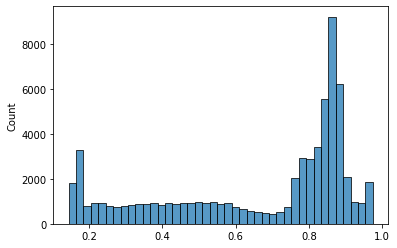

In [ ]:
image_tensor = explore_data[0][0].flatten().numpy()
sns.histplot(image_tensor)

It may be smart to view every image, since our dataset is relatively small and we want to get a comprehensive view of if our preprocessing breaks anything. We'll also use this as a timing test to compare our two dataset schema.

Note: The timing procedure goes through 5 loops, and the same images will actually be different in each of the 5 loops, since our augmentation is applied on-the-fly.

In [ ]:
%%timeit
explore_data = ImageDataset(train = True, shuffle=False, all_data = True, normalize= True, clipping = True,  resize = 256, spatial_transform = spatial_transform, nonspatial_transform = nonspatial_transform)

1 loop, best of 5: 3.99 s per loop


/usr/local/lib/python3.7/dist-packages/torchio/transforms/augmentation/spatial/random_elastic_deformation.py:263: RuntimeWarning: The maximum displacement is larger than the coarse grid spacing for dimensions: [2], so folding may occur. Choose fewer control points or a smaller maximum displacement
  warnings.warn(message, RuntimeWarning)


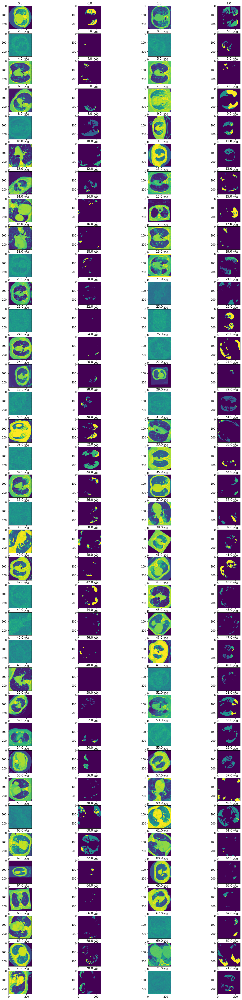

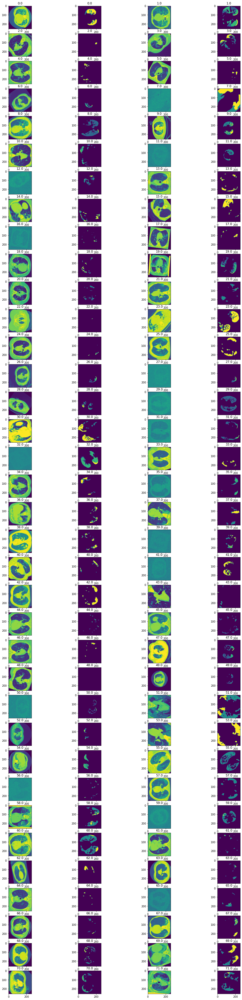

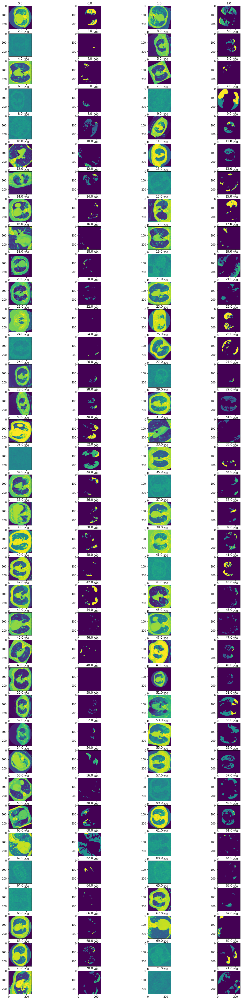

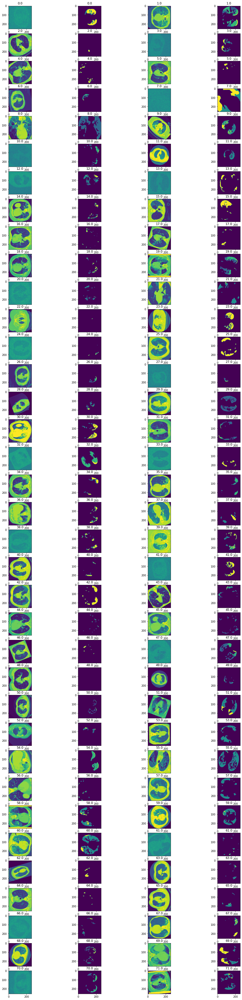

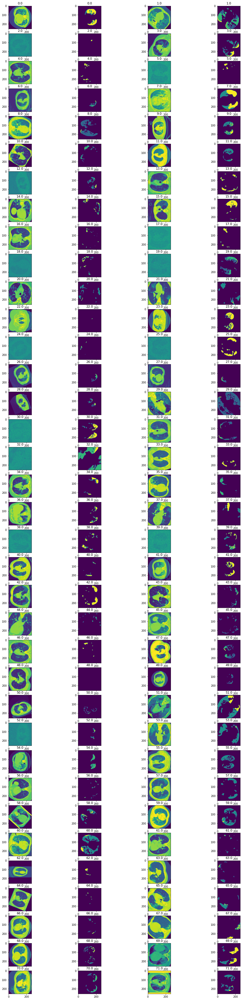

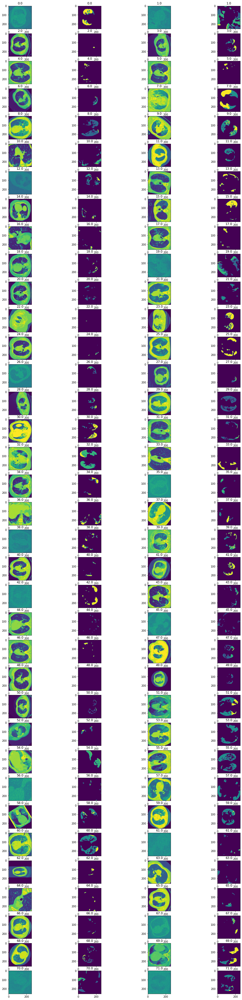

1 loop, best of 5: 17.2 s per loop


In [ ]:
%%timeit
fig = plt.figure(1)
tot = 2*len(explore_data)
cols = 4
rows = tot/cols
position = range(1,tot + 1)
i = 0
while i < tot:
  im, mask = explore_data[int(i/2)]

  # squeeze the channel dimension so we can better visualize the images
  im = im.squeeze()
  mask = mask.squeeze()

  ax = fig.add_subplot(rows, cols, position[i])
  ax.imshow(im)
  ax.title.set_text(i/2)
  i += 1

  ax2 = fig.add_subplot(rows, cols, position[i])
  ax2.imshow(mask)
  ax2.title.set_text((i-1)/2)
  i += 1

fig.set_size_inches(18.5, 70)
plt.show()

Albumentations Dataset

In [ ]:
%%timeit
explore_data = ImageDataset_A(train = True, shuffle=False, all_data = True, normalize= True, clipping = True,  resize = 256, spatial_transform = spatial_transform_A, nonspatial_transform = nonspatial_transform_A)

1 loop, best of 5: 2.45 s per loop


/usr/local/lib/python3.7/dist-packages/torchio/transforms/augmentation/spatial/random_elastic_deformation.py:263: RuntimeWarning: The maximum displacement is larger than the coarse grid spacing for dimensions: [2], so folding may occur. Choose fewer control points or a smaller maximum displacement
  warnings.warn(message, RuntimeWarning)


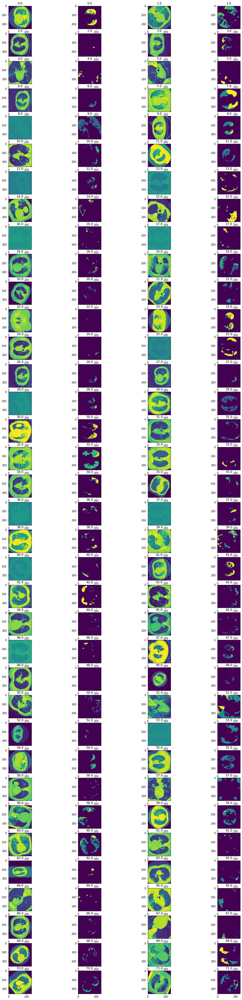

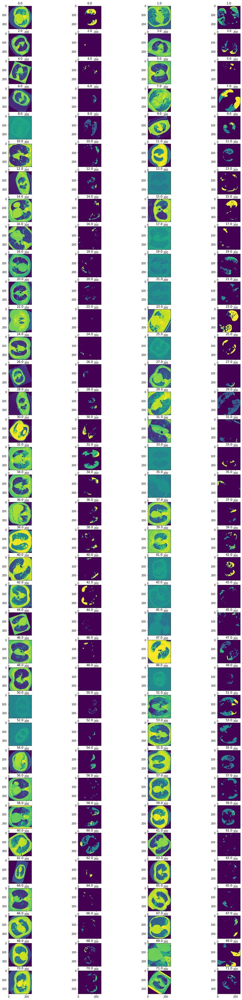

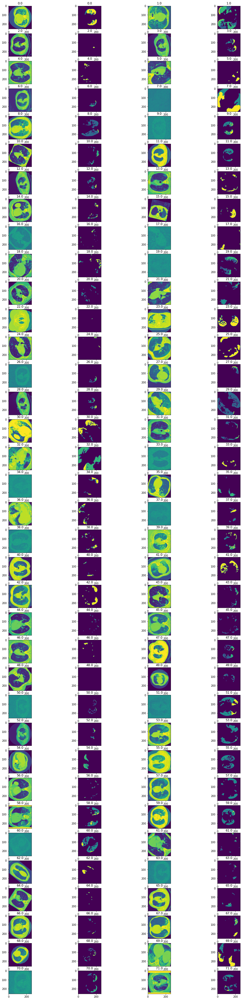

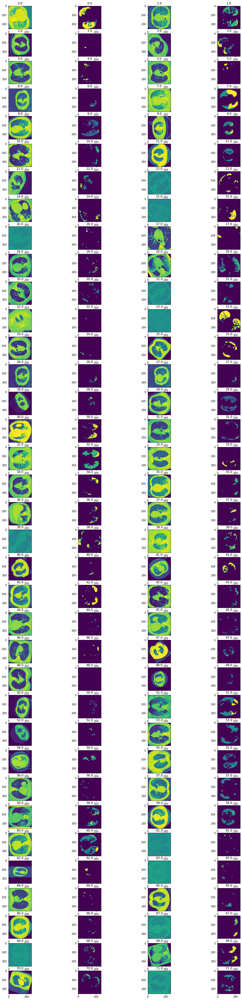

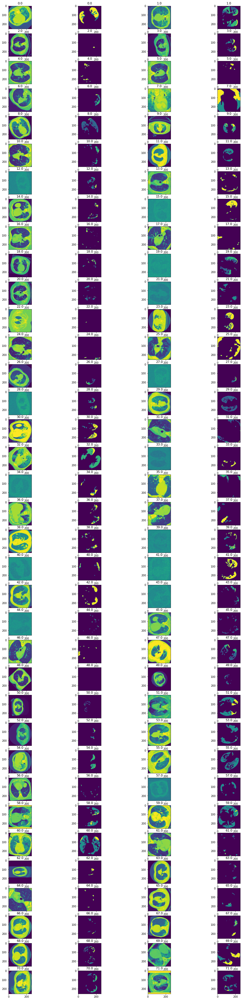

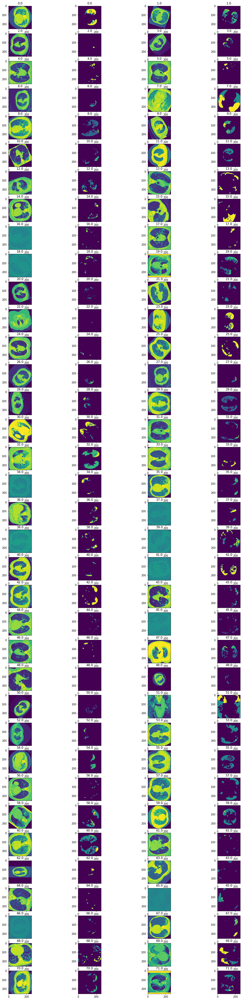

1 loop, best of 5: 17.7 s per loop


In [ ]:
%%timeit
fig = plt.figure(1)
tot = 2*len(explore_data)
cols = 4
rows = tot/cols
position = range(1,tot + 1)
i = 0
while i < tot:
  im, mask = explore_data[int(i/2)]
  # squeeze the channel dimension so we can better visualize the images
  im = im.squeeze()
  mask = mask.squeeze()

  ax = fig.add_subplot(rows, cols, position[i])
  ax.imshow(im)
  ax.title.set_text(i/2)
  i += 1

  ax2 = fig.add_subplot(rows, cols, position[i])
  ax2.imshow(mask)
  ax2.title.set_text((i-1)/2)
  i += 1

fig.set_size_inches(18.5, 70)
plt.show()

# K-Means Clustering

In [ ]:
import numpy as np
import matplotlib.pyplot as plt


def euclidean_distance(x1, x2):
    return np.sqrt(np.sum((x1 - x2)**2))
class KMeans():
    def __init__(self, K=5, max_iters=100, plot_steps=False):
        self.K = K
        self.max_iters = max_iters
        self.plot_steps = plot_steps
        # list of sample indices for each cluster
        self.clusters = [[] for _ in range(self.K)]
        # the centers (mean feature vector) for each cluster
        self.centroids = []
    def predict(self, X):
        self.X = X
        self.n_samples, self.n_features = X.shape
        
        # initialize 
        random_sample_idxs = np.random.choice(self.n_samples, self.K, replace=False)
        self.centroids = [self.X[idx] for idx in random_sample_idxs]
        # Optimize clusters
        for _ in range(self.max_iters):
            # Assign samples to closest centroids (create clusters)
            self.clusters = self._create_clusters(self.centroids)
            if self.plot_steps:
                self.plot()
            # Calculate new centroids from the clusters
            centroids_old = self.centroids
            self.centroids = self._get_centroids(self.clusters)
            
            # check if clusters have changed
            if self._is_converged(centroids_old, self.centroids):
                break
            if self.plot_steps:
                self.plot()
        # Classify samples as the index of their clusters
        return self._get_cluster_labels(self.clusters)
    def _get_cluster_labels(self, clusters):
        # each sample will get the label of the cluster it was assigned to
        labels = np.empty(self.n_samples)
        for cluster_idx, cluster in enumerate(clusters):
            for sample_index in cluster:
                labels[sample_index] = cluster_idx
        return labels
    def _create_clusters(self, centroids):
        # Assign the samples to the closest centroids to create clusters
        clusters = [[] for _ in range(self.K)]
        for idx, sample in enumerate(self.X):
            centroid_idx = self._closest_centroid(sample, centroids)
            clusters[centroid_idx].append(idx)
        return clusters
    def _closest_centroid(self, sample, centroids):
        # distance of the current sample to each centroid
        distances = [euclidean_distance(sample, point) for point in centroids]
        closest_index = np.argmin(distances)
        return closest_index
    def _get_centroids(self, clusters):
        # assign mean value of clusters to centroids
        centroids = np.zeros((self.K, self.n_features))
        for cluster_idx, cluster in enumerate(clusters):
            cluster_mean = np.mean(self.X[cluster], axis=0)
            centroids[cluster_idx] = cluster_mean
        return centroids
    def _is_converged(self, centroids_old, centroids):
        # distances between each old and new centroids, fol all centroids
        distances = [euclidean_distance(centroids_old[i], centroids[i]) for i in range(self.K)]
        return sum(distances) == 0
    def plot(self):
        fig, ax = plt.subplots(figsize=(12, 8))
        for i, index in enumerate(self.clusters):
            point = self.X[index].T
            ax.scatter(*point)
        for point in self.centroids:
            ax.scatter(*point, marker="x", color='black', linewidth=2)
        plt.show()
    def cent(self):
        return self.centroids
import cv2
from google.colab.patches import cv2_imshow
#image = cv2.imread("demo_image.png")
#plt.figure(figsize=(6, 6))
plt.imshow(im)
plt.show()

pixel_values = torch.reshape(im, (-1,))
pixel_values = np.float32(im)
#print(pixel_values.shape)

k = KMeans(K=250, max_iters=100)  
y_pred = k.predict(pixel_values) 
#print(k.cent())

centers = np.uint8(k.cent())

y_pred = y_pred.astype(int)

labels = y_pred.flatten()
segmented_image = centers[labels.flatten()]
segmented_image = segmented_image.reshape(im.shape)
plt.imshow(segmented_image)
plt.show()

plt.imshow(mask)
plt.show()

def dice_no_threshold(
    outputs: torch.Tensor,
    targets: torch.Tensor,
    eps: float = 1e-7,
    threshold: float = None,
):
    """
    Reference:
    https://catalyst-team.github.io/catalyst/_modules/catalyst/dl/utils/criterion/dice.html
    """
    if threshold is not None:
        outputs = (outputs > threshold).float()

    intersection = torch.sum(targets * outputs)
    union = torch.sum(targets) + torch.sum(outputs)
    dice = 2 * intersection / (union + eps)

    return dice

print(dice_no_threshold(torch.tensor(segmented_image),mask))

## Test

In [ ]:
import tqdm
from tqdm.auto import tqdm as tq

class AverageMeter:
    def __init__(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0

    def reset(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0

    def update(self, val, n=1):
        self.val = val
        self.sum += val * n
        self.count += n
        self.avg = self.sum / self.count

def test(test_score, k, metric=dice_no_threshold):
    losses = AverageMeter()
    #model = model.to(device)
    #model.eval()
    #tk0 = tqdm(valid_loader, total=len(valid_loader))
    with torch.no_grad():
        for i, batch in enumerate(tq(test_score)):
            #for key, value in data.items():
            #    data[key] = value.to(device)
            images, mask_target = batch
            pixel_values = torch.reshape(images, (-1,))
            pixel_values = np.float32(images)
            
            y_pred = k.predict(pixel_values) 
            centers = np.uint8(k.cent())

            y_pred = y_pred.astype(int)

            labels = y_pred.flatten()
            segmented_image = centers[labels.flatten()]
            segmented_image = segmented_image.reshape(images.shape)

            
            #batch_preds = batch_preds.squeeze()#.argmax(0)
            #mask_target = mask_target.squeeze()#.argmax(0)
            
            dice  = metric(torch.tensor(segmented_image),mask_target)
            losses.update(dice.mean().item(), test_score.batch_size)
            #tk0.set_postfix(dice_score=losses.avg)
    return losses.avg

test_score = test(test_loader, k, metric=dice_no_threshold)
print(f"Test dice score: {test_score}")

Now to the deep models (note, the models trained here were trained as tests before hyperparameter tuning, and don't represent the final saved models used in the report).

# UNet

## Data Splitting & Data Loaders

In [ ]:
device =  torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

cuda


Set random seeds for reproducability

In [ ]:
torch.manual_seed(522)
np.random.seed(522)

In [ ]:
train_data = ImageDataset(train = True, train_size=72, resize = 256, clipping = True, normalize= True, mask_type = "one_hot", spatial_transform= spatial_transform, nonspatial_transform = nonspatial_transform)
test_data = ImageDataset(train = False, train_size=72, resize = 256, clipping = True, normalize = True, mask_type = "one_hot")

#split validation data and test data
validation_data, test_data = torch.utils.data.random_split(test_data, [10, 18])

In [ ]:
train_loader = DataLoader(train_data, batch_size= 12,
                         shuffle=True, num_workers=0)
validation_loader = DataLoader(validation_data, batch_size=5,
                         shuffle=True, num_workers=0)
test_loader = DataLoader(test_data, batch_size=1,
                         shuffle=True, num_workers=0)

## Model Definition

In [ ]:
class double_conv(nn.Module):
    """(conv => BN => ReLU) * 2"""

    def __init__(self, in_ch, out_ch):
        super(double_conv, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_ch, out_ch, 3, padding=1),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True),
        )

    def forward(self, x):
        x = self.conv(x)
        return x


class inconv(nn.Module):
    def __init__(self, in_ch, out_ch):
        super(inconv, self).__init__()
        self.conv = double_conv(in_ch, out_ch)

    def forward(self, x):
        x = self.conv(x)
        return x


class down(nn.Module):
    def __init__(self, in_ch, out_ch):
        super(down, self).__init__()
        self.mpconv = nn.Sequential(nn.MaxPool2d(2), double_conv(in_ch, out_ch))

    def forward(self, x):
        x = self.mpconv(x)
        return x


class up(nn.Module):
    def __init__(self, in_ch, out_ch, bilinear=True):
        super(up, self).__init__()

        if bilinear:
            self.up = nn.Upsample(scale_factor=2, mode="bilinear", align_corners=True)
        else:
            self.up = nn.ConvTranspose2d(in_ch // 2, in_ch // 2, 2, stride=2)

        self.conv = double_conv(in_ch, out_ch)

    def forward(self, x1, x2):
        x1 = self.up(x1)

        # input is CHW
        diffY = x2.size()[2] - x1.size()[2]
        diffX = x2.size()[3] - x1.size()[3]

        x1 = F.pad(x1, (diffX // 2, diffX - diffX // 2, diffY // 2, diffY - diffY // 2))
        
        x = torch.cat([x2, x1], dim=1)
        return self.conv(x)


class outconv(nn.Module):
    def __init__(self, in_ch, out_ch):
        super(outconv, self).__init__()
        self.conv = nn.Conv2d(in_ch, out_ch, 1)

    def forward(self, x):
        x = self.conv(x)
        return x


class UNet(nn.Module):
    def __init__(self, n_channels, n_classes):
        super(UNet, self).__init__()
        self.inc = inconv(n_channels, 36)
        self.down1 = down(36, 128)
        self.down2 = down(128, 256)
        self.down3 = down(256, 512)
        self.down4 = down(512, 512)
        self.up1 = up(1024, 256, False)
        self.up2 = up(512, 128, False)
        self.up3 = up(256, 36, False)
        self.up4 = up(72, 36, False)
        self.outc = outconv(36, n_classes)

    def forward(self, x):
        #x = x.unsqueeze(1)
        x1 = self.inc(x)
        x2 = self.down1(x1)
        x3 = self.down2(x2)
        x4 = self.down3(x3)
        x5 = self.down4(x4)
        x = self.up1(x5, x4)
        x = self.up2(x, x3)
        x = self.up3(x, x2)
        x = self.up4(x, x1)
        x = self.outc(x)
        return torch.sigmoid(x)

In [ ]:
model = UNet(n_channels=1, n_classes=4).float()
model.to(device)

model # print Model

UNet(
  (inc): inconv(
    (conv): double_conv(
      (conv): Sequential(
        (0): Conv2d(1, 36, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): BatchNorm2d(36, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
        (3): Conv2d(36, 36, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (4): BatchNorm2d(36, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (5): ReLU(inplace=True)
      )
    )
  )
  (down1): down(
    (mpconv): Sequential(
      (0): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (1): double_conv(
        (conv): Sequential(
          (0): Conv2d(36, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): ReLU(inplace=True)
          (3): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (4): BatchNorm2

## Loss Functions

In [ ]:
# Loss Function

def f_score(pr, gt, beta=1, eps=1e-7, threshold=None, activation='sigmoid'):
    """
    Args:
        pr (torch.Tensor): A list of predicted elements
        gt (torch.Tensor):  A list of elements that are to be predicted
        eps (float): epsilon to avoid zero division
        threshold: threshold for outputs binarization
    Returns:
        float: IoU (Jaccard) score
    """

    if activation is None or activation == "none":
        activation_fn = lambda x: x
    elif activation == "sigmoid":
        activation_fn = torch.nn.Sigmoid()
    elif activation == "softmax2d":
        activation_fn = torch.nn.Softmax2d()
    else:
        raise NotImplementedError(
            "Activation implemented for sigmoid and softmax2d"
        )

    pr = activation_fn(pr)

    if threshold is not None:
        pr = (pr > threshold).float()


    tp = torch.sum(gt * pr)
    fp = torch.sum(pr) - tp
    fn = torch.sum(gt) - tp

    score = ((1 + beta ** 2) * tp + eps) \
            / ((1 + beta ** 2) * tp + beta ** 2 * fn + fp + eps)

    return score


class DiceLoss(nn.Module):
    __name__ = 'dice_loss'

    def __init__(self, eps=1e-7, activation='sigmoid'):
        super().__init__()
        self.activation = activation
        self.eps = eps

    def forward(self, y_pr, y_gt):
        return 1 - f_score(y_pr, y_gt, beta=1., 
                           eps=self.eps, threshold=None, 
                           activation=self.activation)


class BCEDiceLoss(DiceLoss):
    __name__ = 'bce_dice_loss'

    def __init__(self, eps=1e-7, activation='sigmoid', lambda_dice=1.0, lambda_bce=1.0):
        super().__init__(eps, activation)
        if activation == None:
            self.bce = nn.BCELoss(reduction='mean')
        else:
            self.bce = nn.BCEWithLogitsLoss(reduction='mean')
        self.lambda_dice=lambda_dice
        self.lambda_bce=lambda_bce

    def forward(self, y_pr, y_gt):
        dice = super().forward(y_pr, y_gt)
        bce = self.bce(y_pr, y_gt)
        return (self.lambda_dice*dice) + (self.lambda_bce* bce)



Focal Tversky Loss is designed to better capture minority classes in imbalanced datasets. By setting alpha > beta (in our case > .5 as alpha + beta should equal 1), we can penalize false negatives more strictly, which should hopefully help prevent our model from learning to simply classify everything as non-infected.

However, when applying this loss to the multiclass case, we noticed that, while we saw marked improvements in our models' sensitivty toward at least one infection class, it would still often fail to classify multiple types of infection classes. In an attempt to be able to further distinguish how we weighted each class, we attempted a relatively simple modification: calculate a Tversky loss for each class separately as a binary problem with its own alpha weight, then average the losses together. This allows us to set separate penalties on false negatives for each class, which could hopefully give us a greater sense of control in steering our model to predict minority classes.

In [ ]:
class FocalTverskyLoss(nn.Module):
    def __init__(self, weight=None, size_average=True, alpha = .5, gamma = 1):
        super(FocalTverskyLoss, self).__init__()
        self.alpha = alpha
        self.beta = 1 - self.alpha
        self.gamma = gamma

    def forward(self, inputs, targets, smooth=1):
                
        #flatten label and prediction tensors
        inputs = inputs.view(-1)
        targets = targets.view(-1)
        
        #True Positives, False Positives & False Negatives
        TP = (inputs * targets).sum()    
        FP = ((1-targets) * inputs).sum()
        FN = (targets * (1-inputs)).sum()
        
        Tversky = (TP + smooth) / (TP + self.beta*FP +  self.alpha*FN + smooth)  
        FocalTversky = (1 - Tversky)** self.gamma
                       
        return FocalTversky

class MultiFocalTverskyLoss(nn.Module):
    def __init__(self, weight=None, size_average=True, alpha=.5, gamma=1):
        super(MultiFocalTverskyLoss, self).__init__()
        self.alpha = alpha
        self.beta = 1 - self.alpha
        self.gamma = gamma

    def forward(self, inputs, targets, smooth=1):
                
        #flatten label and prediction tensors
        inputs = inputs.permute(1,0,2,3).reshape(4, -1)
        targets = targets.permute(1,0,2,3).reshape(4, -1)
        
        #True Positives, False Positives & False Negatives
        TP = torch.sum((inputs * targets), 1) 
        FP = torch.sum(((1-targets) * inputs), 1)
        FN = torch.sum((targets * (1-inputs)), 1)
        
        Tversky = (TP + smooth) / (TP + self.beta*FP +  self.alpha*FN + smooth)  
        FocalTversky = (1 - Tversky)** self.gamma
        avg_FocalTversky = torch.mean(FocalTversky)
                       
        return avg_FocalTversky



## RAdam Optimizer

In [ ]:
import math
import torch
from torch.optim.optimizer import Optimizer, required

class RAdam(Optimizer):

    def __init__(self, params, lr=1e-3, betas=(0.9, 0.999), eps=1e-8, weight_decay=0):
        if not 0.0 <= lr:
            raise ValueError("Invalid learning rate: {}".format(lr))
        if not 0.0 <= eps:
            raise ValueError("Invalid epsilon value: {}".format(eps))
        if not 0.0 <= betas[0] < 1.0:
            raise ValueError("Invalid beta parameter at index 0: {}".format(betas[0]))
        if not 0.0 <= betas[1] < 1.0:
            raise ValueError("Invalid beta parameter at index 1: {}".format(betas[1]))
            
        defaults = dict(lr=lr, betas=betas, eps=eps, weight_decay=weight_decay)
        self.buffer = [[None, None, None] for ind in range(10)]
        super(RAdam, self).__init__(params, defaults)

    def __setstate__(self, state):
        super(RAdam, self).__setstate__(state)

    def step(self, closure=None):

        loss = None
        if closure is not None:
            loss = closure()

        for group in self.param_groups:

            for p in group['params']:
                if p.grad is None:
                    continue
                grad = p.grad.data.float()
                if grad.is_sparse:
                    raise RuntimeError('RAdam does not support sparse gradients')

                p_data_fp32 = p.data.float()

                state = self.state[p]

                if len(state) == 0:
                    state['step'] = 0
                    state['exp_avg'] = torch.zeros_like(p_data_fp32)
                    state['exp_avg_sq'] = torch.zeros_like(p_data_fp32)
                else:
                    state['exp_avg'] = state['exp_avg'].type_as(p_data_fp32)
                    state['exp_avg_sq'] = state['exp_avg_sq'].type_as(p_data_fp32)

                exp_avg, exp_avg_sq = state['exp_avg'], state['exp_avg_sq']
                beta1, beta2 = group['betas']

                exp_avg_sq.mul_(beta2).addcmul_(1 - beta2, grad, grad)
                exp_avg.mul_(beta1).add_(1 - beta1, grad)

                state['step'] += 1
                buffered = self.buffer[int(state['step'] % 10)]
                if state['step'] == buffered[0]:
                    N_sma, step_size = buffered[1], buffered[2]
                else:
                    buffered[0] = state['step']
                    beta2_t = beta2 ** state['step']
                    N_sma_max = 2 / (1 - beta2) - 1
                    N_sma = N_sma_max - 2 * state['step'] * beta2_t / (1 - beta2_t)
                    buffered[1] = N_sma

                    # more conservative since it's an approximated value
                    if N_sma >= 5:
                        step_size = math.sqrt((1 - beta2_t) * (N_sma - 4) / (N_sma_max - 4) * (N_sma - 2) / N_sma * N_sma_max / (N_sma_max - 2)) / (1 - beta1 ** state['step'])
                    else:
                        step_size = 1.0 / (1 - beta1 ** state['step'])
                    buffered[2] = step_size

                if group['weight_decay'] != 0:
                    p_data_fp32.add_(-group['weight_decay'] * group['lr'], p_data_fp32)

                # more conservative since it's an approximated value
                if N_sma >= 5:            
                    denom = exp_avg_sq.sqrt().add_(group['eps'])
                    p_data_fp32.addcdiv_(-step_size * group['lr'], exp_avg, denom)
                else:
                    p_data_fp32.add_(-step_size * group['lr'], exp_avg)

                p.data.copy_(p_data_fp32)

        return loss


## Training

In [ ]:
#criterion = BCEDiceLoss(eps=1.0, activation=None)
#criterion = FocalTverskyLoss(alpha = .7, gamma = 1)
criterion = MultiFocalTverskyLoss(alpha = torch.tensor([.5, .6, .7, .8]).to(device), gamma = .75)
optimizer = RAdam(model.parameters(), lr = 5e-2)
current_lr = [param_group['lr'] for param_group in optimizer.param_groups][0]
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, factor=0.2, patience=2, cooldown=2)

In [ ]:
import tqdm
from tqdm.auto import tqdm as tq

def dice_no_threshold(
    outputs: torch.Tensor,
    targets: torch.Tensor,
    eps: float = 1e-7,
    threshold: float = None,
):
    """
    Reference:
    https://catalyst-team.github.io/catalyst/_modules/catalyst/dl/utils/criterion/dice.html
    """
    if threshold is not None:
        outputs = (outputs > threshold).float()

    intersection = torch.sum(targets * outputs)
    union = torch.sum(targets) + torch.sum(outputs)
    dice = 2 * intersection / (union + eps)

    return dice

In [ ]:
# number of epochs to train the model
n_epochs = 50#32
train_loss_list = []
valid_loss_list = []
dice_score_list = []
lr_rate_list = []
valid_loss_min = np.Inf # track change in validation loss
for epoch in range(1, n_epochs+1):

    # keep track of training and validation loss
    train_loss = 0.0
    valid_loss = 0.0
    dice_score = 0.0
    ###################
    # train the model #
    ###################
    model.train()
    bar = tq(train_loader, postfix={"train_loss":0.0})
    for data, target in bar:
        # move tensors to GPU if CUDA is available
        
        data, target = data.to(device), target.to(device)
        # clear the gradients of all optimized variables
        optimizer.zero_grad()
        # forward pass: compute predicted outputs by passing inputs to the model
        output = model(data)
        # calculate the batch loss
        # print(output.size())
        # print(target.size())
        loss = criterion(output, target)
        #print(loss)
        # backward pass: compute gradient of the loss with respect to model parameters
        loss.backward()
        # perform a single optimization step (parameter update)
        optimizer.step()
        # update training loss
        train_loss += loss.item()*data.size(0)
        bar.set_postfix(ordered_dict={"train_loss":loss.item()})
    ######################    
    # validate the model #
    ######################
    model.eval()
    del data, target
    with torch.no_grad():
        bar = tq(validation_loader, postfix={"valid_loss":0.0, "dice_score":0.0})
        for data, target in bar:
            # move tensors to GPU if CUDA is available
            
            data, target = data.to(device), target.to(device)
            # forward pass: compute predicted outputs by passing inputs to the model
            output = model(data)
            # calculate the batch loss
            loss = criterion(output, target)
            # update average validation loss 
            valid_loss += loss.item()*data.size(0)
            dice_cof = dice_no_threshold(output.cpu(), target.cpu()).item()
            dice_score +=  dice_cof * data.size(0)
            bar.set_postfix(ordered_dict={"valid_loss":loss.item(), "dice_score":dice_cof})
    
    # calculate average losses
    train_loss = train_loss/len(train_loader.dataset)
    valid_loss = valid_loss/len(validation_loader.dataset)
    dice_score = dice_score/len(validation_loader.dataset)
    train_loss_list.append(train_loss)
    valid_loss_list.append(valid_loss)
    dice_score_list.append(dice_score)
    lr_rate_list.append([param_group['lr'] for param_group in optimizer.param_groups])
    
    # print training/validation statistics 
    print('Epoch: {}  Training Loss: {:.6f}  Validation Loss: {:.6f} Dice Score: {:.6f}'.format(
        epoch, train_loss, valid_loss, dice_score))
    
    # save model if validation loss has decreased
    if valid_loss <= valid_loss_min:
        print('Validation loss decreased ({:.6f} --> {:.6f}).  Saving model ...'.format(
        valid_loss_min,
        valid_loss))
        torch.save(model.state_dict(), 'model_cifar.pt')
        valid_loss_min = valid_loss
    
    scheduler.step(valid_loss)


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

/usr/local/lib/python3.7/dist-packages/torchio/transforms/augmentation/spatial/random_elastic_deformation.py:263: RuntimeWarning: The maximum displacement is larger than the coarse grid spacing for dimensions: [2], so folding may occur. Choose fewer control points or a smaller maximum displacement
  warnings.warn(message, RuntimeWarning)


  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 1  Training Loss: 0.822657  Validation Loss: 0.834256 Dice Score: 0.330112
Validation loss decreased (inf --> 0.834256).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 2  Training Loss: 0.793936  Validation Loss: 0.835351 Dice Score: 0.279411


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 3  Training Loss: 0.760830  Validation Loss: 0.807410 Dice Score: 0.289814
Validation loss decreased (0.834256 --> 0.807410).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 4  Training Loss: 0.745371  Validation Loss: 0.744033 Dice Score: 0.397987
Validation loss decreased (0.807410 --> 0.744033).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 5  Training Loss: 0.715391  Validation Loss: 0.739058 Dice Score: 0.554891
Validation loss decreased (0.744033 --> 0.739058).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 6  Training Loss: 0.714193  Validation Loss: 0.666019 Dice Score: 0.638462
Validation loss decreased (0.739058 --> 0.666019).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 7  Training Loss: 0.692337  Validation Loss: 0.681882 Dice Score: 0.611120


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 8  Training Loss: 0.684165  Validation Loss: 0.689628 Dice Score: 0.585800


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 9  Training Loss: 0.639624  Validation Loss: 0.701655 Dice Score: 0.546250


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 10  Training Loss: 0.628118  Validation Loss: 0.663891 Dice Score: 0.647830
Validation loss decreased (0.666019 --> 0.663891).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 11  Training Loss: 0.623480  Validation Loss: 0.640722 Dice Score: 0.688244
Validation loss decreased (0.663891 --> 0.640722).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 12  Training Loss: 0.630424  Validation Loss: 0.629658 Dice Score: 0.714790
Validation loss decreased (0.640722 --> 0.629658).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 13  Training Loss: 0.637740  Validation Loss: 0.585705 Dice Score: 0.780066
Validation loss decreased (0.629658 --> 0.585705).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 14  Training Loss: 0.622295  Validation Loss: 0.600556 Dice Score: 0.748895


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 15  Training Loss: 0.592767  Validation Loss: 0.629871 Dice Score: 0.721729


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 16  Training Loss: 0.623768  Validation Loss: 0.687068 Dice Score: 0.607982


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 17  Training Loss: 0.613544  Validation Loss: 0.646035 Dice Score: 0.687673


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 18  Training Loss: 0.619848  Validation Loss: 0.601720 Dice Score: 0.765195


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 19  Training Loss: 0.613135  Validation Loss: 0.571216 Dice Score: 0.818803
Validation loss decreased (0.585705 --> 0.571216).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 20  Training Loss: 0.624986  Validation Loss: 0.607908 Dice Score: 0.808043


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 21  Training Loss: 0.590265  Validation Loss: 0.580225 Dice Score: 0.823232


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 22  Training Loss: 0.599047  Validation Loss: 0.569039 Dice Score: 0.837574
Validation loss decreased (0.571216 --> 0.569039).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 23  Training Loss: 0.619054  Validation Loss: 0.580456 Dice Score: 0.834723


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 24  Training Loss: 0.593966  Validation Loss: 0.579878 Dice Score: 0.846155


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 25  Training Loss: 0.602708  Validation Loss: 0.557851 Dice Score: 0.858909
Validation loss decreased (0.569039 --> 0.557851).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 26  Training Loss: 0.606980  Validation Loss: 0.582815 Dice Score: 0.851861


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 27  Training Loss: 0.590160  Validation Loss: 0.578794 Dice Score: 0.856448


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 28  Training Loss: 0.634568  Validation Loss: 0.573302 Dice Score: 0.853833


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 29  Training Loss: 0.626210  Validation Loss: 0.598794 Dice Score: 0.799137


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 30  Training Loss: 0.610642  Validation Loss: 0.595203 Dice Score: 0.823892


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 31  Training Loss: 0.591129  Validation Loss: 0.569180 Dice Score: 0.850140


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 32  Training Loss: 0.602764  Validation Loss: 0.582366 Dice Score: 0.852745


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 33  Training Loss: 0.601261  Validation Loss: 0.580881 Dice Score: 0.855937


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 34  Training Loss: 0.599989  Validation Loss: 0.565446 Dice Score: 0.861304


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 35  Training Loss: 0.577814  Validation Loss: 0.560517 Dice Score: 0.869632


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 36  Training Loss: 0.626618  Validation Loss: 0.595202 Dice Score: 0.815955


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 37  Training Loss: 0.622397  Validation Loss: 0.653912 Dice Score: 0.718550


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 38  Training Loss: 0.597890  Validation Loss: 0.644367 Dice Score: 0.735020


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 39  Training Loss: 0.582466  Validation Loss: 0.585592 Dice Score: 0.822753


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 40  Training Loss: 0.608457  Validation Loss: 0.590685 Dice Score: 0.845307


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 41  Training Loss: 0.606306  Validation Loss: 0.584462 Dice Score: 0.846274


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 42  Training Loss: 0.603465  Validation Loss: 0.575031 Dice Score: 0.843487


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 43  Training Loss: 0.595008  Validation Loss: 0.561692 Dice Score: 0.854154


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 44  Training Loss: 0.606969  Validation Loss: 0.588163 Dice Score: 0.836548


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 45  Training Loss: 0.611069  Validation Loss: 0.582787 Dice Score: 0.822431


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 46  Training Loss: 0.615191  Validation Loss: 0.570324 Dice Score: 0.841827


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 47  Training Loss: 0.613542  Validation Loss: 0.579748 Dice Score: 0.850873


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 48  Training Loss: 0.613948  Validation Loss: 0.579814 Dice Score: 0.842501


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 49  Training Loss: 0.601541  Validation Loss: 0.579808 Dice Score: 0.852871


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 50  Training Loss: 0.632881  Validation Loss: 0.617207 Dice Score: 0.794530


## Plotting Metrics

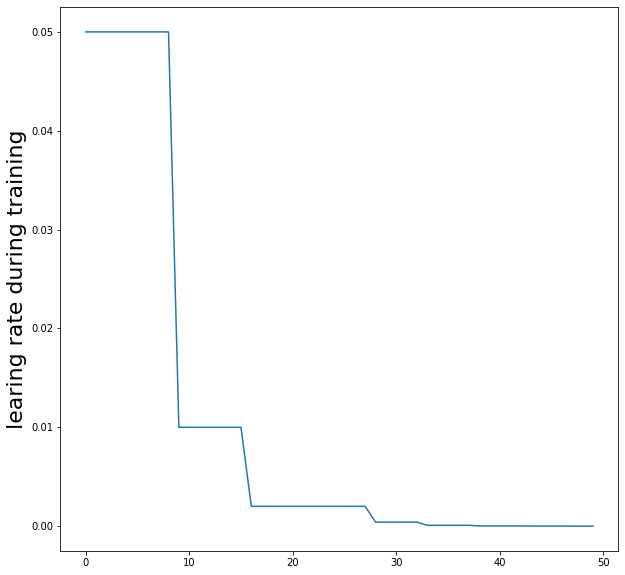

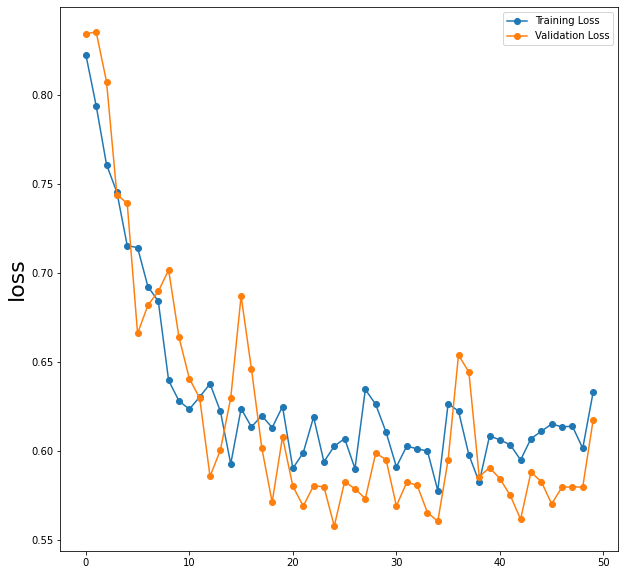

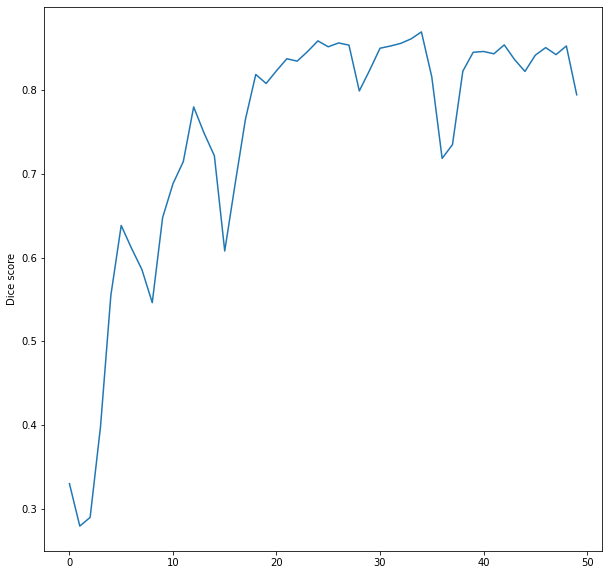

In [ ]:
plt.figure(figsize=(10,10))
plt.plot([i[0] for i in lr_rate_list])
plt.ylabel('learing rate during training', fontsize=22)
plt.show()

plt.figure(figsize=(10,10))
plt.plot(train_loss_list,  marker='o', label="Training Loss")
plt.plot(valid_loss_list,  marker='o', label="Validation Loss")
plt.ylabel('loss', fontsize=22)
plt.legend()
plt.show()

plt.figure(figsize=(10,10))
plt.plot(dice_score_list)
plt.ylabel('Dice score')
plt.show()

## Plotting predictions

In [ ]:
def plot_predictions(model, data):
  
  model.eval()
  
  # try to plot prediction vs target to see how we did
  predictions = []
  masks = []
  fig, ((ax1, ax2, ax3, ax4), (ax5, ax6, ax7, ax8)) = plt.subplots(2, 4)

  fig.set_size_inches(18.5, 10.5)
  fig.suptitle('predicted_masks (top) vs. original_masks (bottom)')

  for k in range(4):
 
      image = data[k][0]
      mask_target = data[k][1]
      batch_preds = model(image.unsqueeze(1).to(device))
      batch_preds = batch_preds.squeeze().argmax(0)
      mask_target = mask_target.squeeze().argmax(0)
      batch_preds = batch_preds.detach().cpu().numpy()
      mask_target = mask_target.detach().cpu().numpy()

      # We need to create our own color map, as otherwise we found the colors for each label
      # do not necessarily remain consistent

      color_map = {0: np.array([75,0,130]), # purple
                1: np.array([255,255,102]), # yellow
              2: np.array([32,178,170]), # sea green
              3: np.array([0,100,0])} # dark green

      # make a 3d numpy array that has a color channel dimension   
      preds_3d = np.ndarray(shape=(batch_preds.shape[0], batch_preds.shape[1], 3), dtype=int)
      for i in range(0, batch_preds.shape[0]):
          for j in range(0, batch_preds.shape[1]):
              preds_3d[i][j] = color_map[batch_preds[i][j]]
      
      mask_3d = np.ndarray(shape=(mask_target.shape[0], mask_target.shape[1], 3), dtype=int)
      for i in range(0, mask_target.shape[0]):
          for j in range(0, mask_target.shape[1]):
              mask_3d[i][j] = color_map[mask_target[i][j]]

      predictions.append(preds_3d)
      masks.append(mask_3d)


    
  ax1.imshow(predictions[0])
  ax2.imshow(predictions[1])
  ax3.imshow(predictions[2])
  ax4.imshow(predictions[3])

  ax5.imshow(masks[0])
  ax6.imshow(masks[1])
  ax7.imshow(masks[2])
  ax8.imshow(masks[3])

## Evaluate

In [ ]:
class AverageMeter:
    def __init__(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0

    def reset(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0

    def update(self, val, n=1):
        self.val = val
        self.sum += val * n
        self.count += n
        self.avg = self.sum / self.count


def evaluate(valid_loader, model, metric=dice_no_threshold):
    losses = AverageMeter()
    model = model.to(device)
    model.eval()
    #tk0 = tqdm(valid_loader, total=len(valid_loader))
    with torch.no_grad():
        for i, batch in enumerate(tq(valid_loader)):
            #for key, value in data.items():
            #    data[key] = value.to(device)
            images, mask_target = batch
            batch_preds = model(images.to(device))
            
            #batch_preds = batch_preds.squeeze()#.argmax(0)
            #mask_target = mask_target.squeeze()#.argmax(0)
            
            dice  = metric(batch_preds.to(device),mask_target.to(device))
            losses.update(dice.mean().item(), valid_loader.batch_size)
            #tk0.set_postfix(dice_score=losses.avg)
    return losses.avg

valid_score = evaluate(validation_loader, model, metric=dice_no_threshold)
print(f"Valid dice score: {valid_score}")

  0%|          | 0/2 [00:00<?, ?it/s]

Valid dice score: 0.3295719772577286


Though using the total dice score is an easy (and commonly used) metric to evaluate the performance of our segmentaion models, it is important to also calculate several scores, such as sensitivity, for each individual class. While sensitivity is what we are most interested in (as we want to evaluate how our models handle the imbalanced environment), we opted to calculate a variety of widely used metrics to display.

In [ ]:
def calc_Dice(truth, pred, classes):
    dice_scores = []
    # Iterate over each class
    for i in range(classes):
        try:
            gt = np.equal(truth, i)
            pd = np.equal(pred, i)
            # Calculate Dice
            dice = 2*np.logical_and(pd, gt).sum() / (pd.sum() + gt.sum())
            dice_scores.append(dice)
        except ZeroDivisionError:
            dice_scores.append(0.0)
    # Return computed Dice Similarity Coefficients
    return dice_scores

def calc_IoU(truth, pred, classes):
    iou_scores = []
    # Iterate over each class
    for i in range(classes):
        try:
            gt = np.equal(truth, i)
            pd = np.equal(pred, i)
            # Calculate iou
            iou = np.logical_and(pd, gt).sum() / (pd.sum() + gt.sum() - np.logical_and(pd, gt).sum())
            iou_scores.append(iou)
        except ZeroDivisionError:
            iou_scores.append(0.0)
    # Return computed IoU
    return iou_scores

def calc_Sensitivity(truth, pred, classes):
    sens_scores = []
    # Iterate over each class
    for i in range(classes):
        try:
            gt = np.equal(truth, i)
            pd = np.equal(pred, i)
            # Calculate sensitivity
            sens = np.logical_and(pd, gt).sum() / gt.sum()
            sens_scores.append(sens)
        except ZeroDivisionError:
            sens_scores.append(0.0)
    # Return computed sensitivity scores
    return sens_scores

def calc_Specificity(truth, pred, classes):
    spec_scores = []
    # Iterate over each class
    for i in range(classes):
        try:
            not_gt = np.logical_not(np.equal(truth, i))
            not_pd = np.logical_not(np.equal(pred, i))
            # Calculate specificity
            spec = np.logical_and(not_pd, not_gt).sum() / (not_gt).sum()
            spec_scores.append(spec)
        except ZeroDivisionError:
            spec_scores.append(0.0)
    # Return computed specificity scores
    return spec_scores

def calc_Accuracy(truth, pred, classes):
    acc_scores = []
    # Iterate over each class
    for i in range(classes):
        try:
            gt = np.equal(truth, i)
            pd = np.equal(pred, i)
            not_gt = np.logical_not(np.equal(truth, i))
            not_pd = np.logical_not(np.equal(pred, i))
            # Calculate accuracy
            acc = (np.logical_and(pd, gt).sum() + \
                   np.logical_and(not_pd, not_gt).sum()) /  gt.size
            acc_scores.append(acc)
        except ZeroDivisionError:
            acc_scores.append(0.0)
    # Return computed accuracy scores
    return acc_scores

def calc_Precision(truth, pred, classes):
    prec_scores = []
    # Iterate over each class
    for i in range(classes):
        try:
            gt = np.equal(truth, i)
            pd = np.equal(pred, i)
            # Calculate precision
            prec = np.logical_and(pd, gt).sum() / pd.sum()
            prec_scores.append(prec)
        except ZeroDivisionError:
            prec_scores.append(0.0)
    # Return computed precision scores
    return prec_scores

def calc_ns(truth, classes):
    ns = []
    for i in range(classes):
      gt = np.equal(truth, i)
      # Calculate precision
      n = gt.sum()
      ns.append(n)
    return ns

## Test

In [ ]:
def test(test_score, model, metric=dice_no_threshold):
    losses = AverageMeter()
    model = model.to(device)
    model.eval()
    #tk0 = tqdm(valid_loader, total=len(valid_loader))
    with torch.no_grad():
        for i, batch in enumerate(tq(test_score)):
            #for key, value in data.items():
            #    data[key] = value.to(device)
            images, mask_target = batch
            batch_preds = model(images.to(device))
            
            #batch_preds = batch_preds.squeeze()#.argmax(0)
            #mask_target = mask_target.squeeze()#.argmax(0)
            
            dice  = metric(batch_preds.to(device),mask_target.to(device))
            losses.update(dice.mean().item(), test_score.batch_size)
            #tk0.set_postfix(dice_score=losses.avg)
    return losses.avg


In [ ]:
n_classes = 4

def PerClassMetrics(model, n_classes = 4):
  model = model.to(device)
  model.eval()
  if n_classes == 4:
    cols = ["index", "score", "background", "ground glass", "consolidation", "pleural effusion"]
  else:
    cols = ["index", "score", "background", "infection"]

  scores = pd.DataFrame(data=[], dtype=np.float64, columns=cols)

  with torch.no_grad():
    for i, batch in enumerate(tq(test_loader)):
        images, mask_target = batch
        batch_preds = model(images.to(device))
        batch_preds = batch_preds.squeeze().argmax(0).float()
        mask_target = mask_target.squeeze().argmax(0).float()
        batch_preds = batch_preds.detach().cpu().numpy()
        mask_target = mask_target.detach().cpu().numpy()

        #loop through each image in the batch and get the individual scores for each class of each image
        #Then average together
        for b in range(images.shape[0]):
          dice = calc_Dice(mask_target, batch_preds, n_classes)
          iou = calc_IoU(mask_target, batch_preds, n_classes)
          sensitivity = calc_Sensitivity(mask_target, batch_preds, n_classes)
          specificity = calc_Specificity(mask_target, batch_preds, n_classes)
          accuracy = calc_Accuracy(mask_target, batch_preds, n_classes)
          precision = calc_Precision(mask_target, batch_preds, n_classes)

          ns = calc_ns(mask_target, n_classes)
          ns = ns/np.sum(ns)

  
          index = i + b

          #We originally calculated the average and weighted average across classes,
          #but given the nature of some of these metrics in a multi-class environment,
          #ultimately decided doing so was misleading

          # dice_avg = np.nanmean(dice)
          # iou_avg = np.nanmean(iou)
          # sens_avg = np.nanmean(sensitivity)
          # spec_avg = np.nanmean(specificity)
          # acc_avg = np.nanmean(accuracy)
          # prec_avg = np.nanmean(precision)

          # masked_dice = np.ma.masked_array(dice, np.isnan(dice))
          # masked_iou = np.ma.masked_array(iou, np.isnan(iou))
          # masked_sens = np.ma.masked_array(sensitivity, np.isnan(sensitivity))
          # masked_spec = np.ma.masked_array(specificity, np.isnan(specificity))
          # masked_acc = np.ma.masked_array(accuracy, np.isnan(accuracy))
          # masked_prec = np.ma.masked_array(precision, np.isnan(precision))

          # dice_wavg = np.average(masked_dice, weights = ns)
          # iou_wavg = np.average(masked_iou, weights = ns)
          # sens_wavg = np.average(masked_sens, weights = ns)
          # spec_wavg = np.average(masked_spec, weights = ns)
          # acc_wavg = np.average(masked_acc, weights = ns)
          # prec_wavg = np.average(masked_prec, weights = ns)


          # dice.append(dice_avg)
          # iou.append(iou_avg)
          # sensitivity.append(sens_avg)
          # specificity.append(spec_avg)
          # accuracy.append(acc_avg)
          # precision.append(prec_avg)

          
          # dice.append(dice_wavg)
          # iou.append(iou_wavg)
          # sensitivity.append(sens_wavg)
          # specificity.append(spec_wavg)
          # accuracy.append(acc_wavg)
          # precision.append(prec_wavg)

          scores = scores.append(pd.Series([index, "Dice"] + dice, index=cols),
                        ignore_index=True)
          scores = scores.append(pd.Series([index, "IoU"] + iou, index=cols),
                        ignore_index=True)
          scores = scores.append(pd.Series([index, "Sens"] + sensitivity, index=cols),
                        ignore_index=True)
          scores = scores.append(pd.Series([index, "Spec"] + specificity, index=cols),
                        ignore_index=True)
          scores = scores.append(pd.Series([index, "Prec"] + precision, index=cols),
                        ignore_index=True)
          scores = scores.append(pd.Series([index, "Acc"] + accuracy, index=cols),
                        ignore_index=True)
              
  return scores

Calculate test Dice

In [ ]:

test_score = test(test_loader, model, metric=dice_no_threshold)
print(f"Test dice score: {test_score}")

Calculate Per Class Metrics and save table

In [ ]:
model2.eval()
pcscores = PerClassMetrics(model = model2, n_classes = 4)

  0%|          | 0/18 [00:00<?, ?it/s]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:86: RuntimeWarning: invalid value encountered in long_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: RuntimeWarning: invalid value encountered in long_scalars
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:24: RuntimeWarning: invalid value encountered in long_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:39: RuntimeWarning: invalid value encountered in long_scalars


In [ ]:
pcscores

In [ ]:
avgs = pcscores.groupby(by="score").mean().drop("index", axis = 1, inplace = False)
avgs

In [ ]:
pcscores.to_csv('/content/drive/Shareddrives/CIS 522 Final Project/Models/Metrics/Unet_baseline_unaugmented/single_image_per_class_scores.csv')
avgs.to_csv('/content/drive/Shareddrives/CIS 522 Final Project/Models/Metrics/Unet_baseline_unaugmented/average_per_class_scores.csv')

## Deeper UNet

In [ ]:
torch.cuda.empty_cache()

In [ ]:
class UNet2(nn.Module):
    def __init__(self, n_channels, n_classes):
        super(UNet2, self).__init__()
        self.inc = inconv(n_channels, 36)
        self.down1 = down(36, 128)
        self.down2 = down(128, 256)
        self.down3 = down(256, 512)
        self.down4 = down(512, 1024)
        self.down5 = down(1024, 1024)
        self.up1 = up(2048, 512, False)
        self.up2 = up(1024, 256, False)
        self.up3 = up(512, 128, False)
        self.up4 = up(256, 36, False)
        self.up5 = up(72, 36, False)
        self.outc = outconv(36, n_classes)

    def forward(self, x):
        #x = x.unsqueeze(1)
        x1 = self.inc(x)
        x2 = self.down1(x1)
        x3 = self.down2(x2)
        x4 = self.down3(x3)
        x5 = self.down4(x4)
        x6 = self.down5(x5)
        x = self.up1(x6, x5)
        x = self.up2(x, x4)
        x = self.up3(x, x3)
        x = self.up4(x, x2)
        x = self.up5(x, x1)
        x = self.outc(x)
        return torch.sigmoid(x)

In [ ]:
model2 = UNet2(n_channels=1, n_classes=4).float()
model2.to(device)

model2 # print Model

UNet2(
  (inc): inconv(
    (conv): double_conv(
      (conv): Sequential(
        (0): Conv2d(1, 36, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): BatchNorm2d(36, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
        (3): Conv2d(36, 36, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (4): BatchNorm2d(36, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (5): ReLU(inplace=True)
      )
    )
  )
  (down1): down(
    (mpconv): Sequential(
      (0): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (1): double_conv(
        (conv): Sequential(
          (0): Conv2d(36, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): ReLU(inplace=True)
          (3): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (4): BatchNorm

In [ ]:
optimizer = RAdam(model2.parameters(), lr = 5e-2)
current_lr = [param_group['lr'] for param_group in optimizer.param_groups][0]
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, factor=0.2, patience=2, cooldown=2)

In [ ]:
import tqdm
from tqdm.auto import tqdm as tq

def dice_no_threshold(
    outputs: torch.Tensor,
    targets: torch.Tensor,
    eps: float = 1e-7,
    threshold: float = None,
):
    """
    Reference:
    https://catalyst-team.github.io/catalyst/_modules/catalyst/dl/utils/criterion/dice.html
    """
    if threshold is not None:
        outputs = (outputs > threshold).float()

    intersection = torch.sum(targets * outputs)
    union = torch.sum(targets) + torch.sum(outputs)
    dice = 2 * intersection / (union + eps)

    return dice

# number of epochs to train the model
n_epochs = 50
train_loss_list = []
valid_loss_list = []
dice_score_list = []
lr_rate_list = []
valid_loss_min = np.Inf # track change in validation loss
for epoch in range(1, n_epochs+1):

    # keep track of training and validation loss
    train_loss = 0.0
    valid_loss = 0.0
    dice_score = 0.0
    ###################
    # train the model #
    ###################
    model2.train()
    bar = tq(train_loader, postfix={"train_loss":0.0})
    for data, target in bar:
        # move tensors to GPU if CUDA is available
        data, target = data.to(device), target.to(device)
        # clear the gradients of all optimized variables
        optimizer.zero_grad()
        # forward pass: compute predicted outputs by passing inputs to the model
        output = model2(data)
        # calculate the batch loss
        # print(output.size())
        # print(target.size())
        loss = criterion(output, target)
        #print(loss)
        # backward pass: compute gradient of the loss with respect to model parameters
        loss.backward()
        # perform a single optimization step (parameter update)
        optimizer.step()
        # update training loss
        train_loss += loss.item()*data.size(0)
        bar.set_postfix(ordered_dict={"train_loss":loss.item()})
    ######################
    # validate the model #
    ######################
    model2.eval()
    del data, target
    with torch.no_grad():
        bar = tq(validation_loader, postfix={"valid_loss":0.0, "dice_score":0.0})
        for data, target in bar:
            # move tensors to GPU if CUDA is available
            data, target = data.to(device), target.to(device)
            # forward pass: compute predicted outputs by passing inputs to the model
            output = model2(data)
            # calculate the batch loss
            loss = criterion(output, target)
            # update average validation loss 
            valid_loss += loss.item()*data.size(0)
            dice_cof = dice_no_threshold(output.cpu(), target.cpu()).item()
            dice_score +=  dice_cof * data.size(0)
            bar.set_postfix(ordered_dict={"valid_loss":loss.item(), "dice_score":dice_cof})
    
    # calculate average losses
    train_loss = train_loss/len(train_loader.dataset)
    valid_loss = valid_loss/len(validation_loader.dataset)
    dice_score = dice_score/len(validation_loader.dataset)
    train_loss_list.append(train_loss)
    valid_loss_list.append(valid_loss)
    dice_score_list.append(dice_score)
    lr_rate_list.append([param_group['lr'] for param_group in optimizer.param_groups])
    
    # print training/validation statistics 
    print('Epoch: {}  Training Loss: {:.6f}  Validation Loss: {:.6f} Dice Score: {:.6f}'.format(
        epoch, train_loss, valid_loss, dice_score))
    
    # save model if validation loss has decreased
    if valid_loss <= valid_loss_min:
        print('Validation loss decreased ({:.6f} --> {:.6f}).  Saving model ...'.format(
        valid_loss_min,
        valid_loss))
        torch.save(model.state_dict(), 'model_cifar.pt')
        valid_loss_min = valid_loss
    
    scheduler.step(valid_loss)

  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

/usr/local/lib/python3.7/dist-packages/torchio/transforms/augmentation/spatial/random_elastic_deformation.py:263: RuntimeWarning: The maximum displacement is larger than the coarse grid spacing for dimensions: [2], so folding may occur. Choose fewer control points or a smaller maximum displacement
  warnings.warn(message, RuntimeWarning)


  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 1  Training Loss: 0.804634  Validation Loss: 0.814770 Dice Score: 0.357915
Validation loss decreased (inf --> 0.814770).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 2  Training Loss: 0.781706  Validation Loss: 0.820597 Dice Score: 0.312327


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 3  Training Loss: 0.764988  Validation Loss: 0.731038 Dice Score: 0.499021
Validation loss decreased (0.814770 --> 0.731038).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 4  Training Loss: 0.741135  Validation Loss: 0.732530 Dice Score: 0.498993


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 5  Training Loss: 0.719723  Validation Loss: 0.732679 Dice Score: 0.502298


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 6  Training Loss: 0.706674  Validation Loss: 0.722525 Dice Score: 0.552304
Validation loss decreased (0.731038 --> 0.722525).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 7  Training Loss: 0.671498  Validation Loss: 0.696730 Dice Score: 0.587574
Validation loss decreased (0.722525 --> 0.696730).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 8  Training Loss: 0.652423  Validation Loss: 0.695015 Dice Score: 0.608852
Validation loss decreased (0.696730 --> 0.695015).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 9  Training Loss: 0.635339  Validation Loss: 0.674312 Dice Score: 0.654221
Validation loss decreased (0.695015 --> 0.674312).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 10  Training Loss: 0.645567  Validation Loss: 0.695540 Dice Score: 0.651624


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 11  Training Loss: 0.628464  Validation Loss: 0.678998 Dice Score: 0.686534


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 12  Training Loss: 0.642177  Validation Loss: 0.711078 Dice Score: 0.597905


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 13  Training Loss: 0.617242  Validation Loss: 0.648570 Dice Score: 0.726412
Validation loss decreased (0.674312 --> 0.648570).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 14  Training Loss: 0.597141  Validation Loss: 0.609414 Dice Score: 0.784287
Validation loss decreased (0.648570 --> 0.609414).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 15  Training Loss: 0.631758  Validation Loss: 0.605333 Dice Score: 0.787824
Validation loss decreased (0.609414 --> 0.605333).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 16  Training Loss: 0.609217  Validation Loss: 0.594095 Dice Score: 0.821326
Validation loss decreased (0.605333 --> 0.594095).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 17  Training Loss: 0.604819  Validation Loss: 0.615171 Dice Score: 0.828048


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 18  Training Loss: 0.608805  Validation Loss: 0.592263 Dice Score: 0.829320
Validation loss decreased (0.594095 --> 0.592263).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 19  Training Loss: 0.596295  Validation Loss: 0.602435 Dice Score: 0.838453


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 20  Training Loss: 0.590220  Validation Loss: 0.609964 Dice Score: 0.856692


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 21  Training Loss: 0.612272  Validation Loss: 0.610572 Dice Score: 0.850369


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 22  Training Loss: 0.579277  Validation Loss: 0.662205 Dice Score: 0.704106


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 23  Training Loss: 0.591895  Validation Loss: 0.605222 Dice Score: 0.817700


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 24  Training Loss: 0.615739  Validation Loss: 0.581338 Dice Score: 0.853233
Validation loss decreased (0.592263 --> 0.581338).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 25  Training Loss: 0.588224  Validation Loss: 0.590449 Dice Score: 0.855016


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 26  Training Loss: 0.604248  Validation Loss: 0.576177 Dice Score: 0.862324
Validation loss decreased (0.581338 --> 0.576177).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 27  Training Loss: 0.616297  Validation Loss: 0.566025 Dice Score: 0.869354
Validation loss decreased (0.576177 --> 0.566025).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 28  Training Loss: 0.567999  Validation Loss: 0.580385 Dice Score: 0.876203


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 29  Training Loss: 0.610566  Validation Loss: 0.584759 Dice Score: 0.852622


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 30  Training Loss: 0.583528  Validation Loss: 0.597535 Dice Score: 0.838733


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 31  Training Loss: 0.610096  Validation Loss: 0.578145 Dice Score: 0.859209


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 32  Training Loss: 0.594384  Validation Loss: 0.578551 Dice Score: 0.862106


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 33  Training Loss: 0.584557  Validation Loss: 0.578872 Dice Score: 0.856676


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 34  Training Loss: 0.599332  Validation Loss: 0.572272 Dice Score: 0.872490


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 35  Training Loss: 0.630053  Validation Loss: 0.574041 Dice Score: 0.867236


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 36  Training Loss: 0.599253  Validation Loss: 0.573471 Dice Score: 0.866572


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 37  Training Loss: 0.587595  Validation Loss: 0.573630 Dice Score: 0.865024


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 38  Training Loss: 0.585439  Validation Loss: 0.576914 Dice Score: 0.864935


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 39  Training Loss: 0.609498  Validation Loss: 0.574131 Dice Score: 0.871128


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 40  Training Loss: 0.570495  Validation Loss: 0.583708 Dice Score: 0.862180


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 41  Training Loss: 0.594381  Validation Loss: 0.582104 Dice Score: 0.860542


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 42  Training Loss: 0.586914  Validation Loss: 0.578758 Dice Score: 0.868355


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 43  Training Loss: 0.588295  Validation Loss: 0.567029 Dice Score: 0.874688


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 44  Training Loss: 0.567419  Validation Loss: 0.574747 Dice Score: 0.875053


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 45  Training Loss: 0.587290  Validation Loss: 0.571440 Dice Score: 0.870602


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 46  Training Loss: 0.595284  Validation Loss: 0.569308 Dice Score: 0.875603


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 47  Training Loss: 0.571034  Validation Loss: 0.568095 Dice Score: 0.874509


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 48  Training Loss: 0.576852  Validation Loss: 0.570930 Dice Score: 0.863143


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 49  Training Loss: 0.599757  Validation Loss: 0.557902 Dice Score: 0.879973
Validation loss decreased (0.566025 --> 0.557902).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 50  Training Loss: 0.566394  Validation Loss: 0.575277 Dice Score: 0.875393


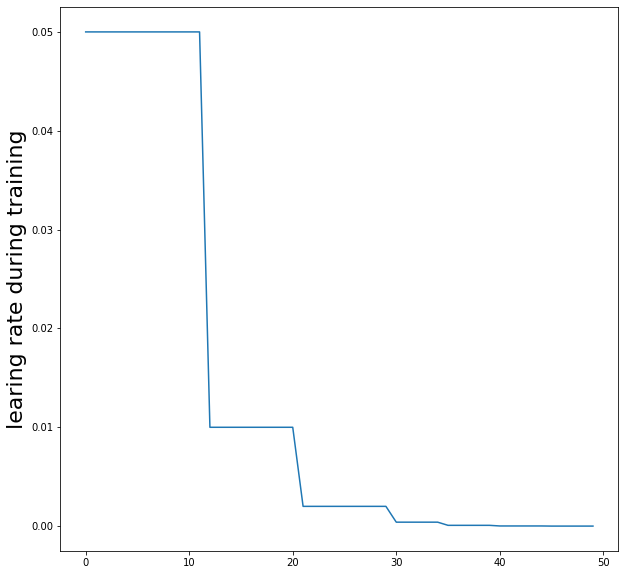

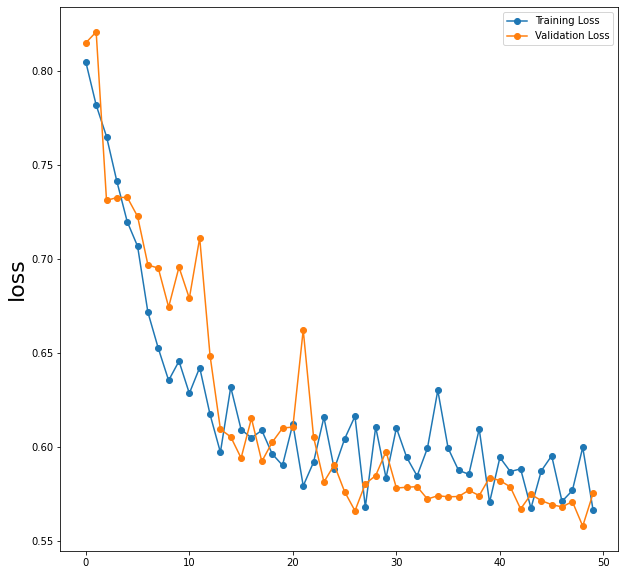

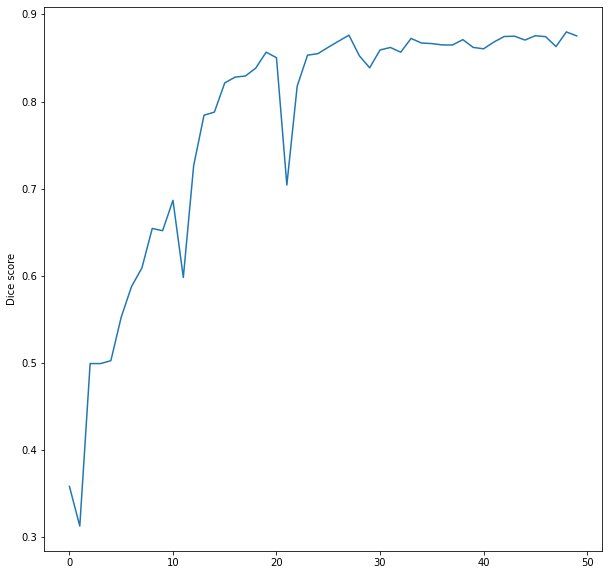

In [ ]:
plt.figure(figsize=(10,10))
plt.plot([i[0] for i in lr_rate_list])
plt.ylabel('learing rate during training', fontsize=22)
plt.show()

plt.figure(figsize=(10,10))
plt.plot(train_loss_list,  marker='o', label="Training Loss")
plt.plot(valid_loss_list,  marker='o', label="Validation Loss")
plt.ylabel('loss', fontsize=22)
plt.legend()
plt.show()

plt.figure(figsize=(10,10))
plt.plot(dice_score_list)
plt.ylabel('Dice score')
plt.show()

In [ ]:
class AverageMeter:
    def __init__(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0

    def reset(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0

    def update(self, val, n=1):
        self.val = val
        self.sum += val * n
        self.count += n
        self.avg = self.sum / self.count


def evaluate(valid_loader, model, metric=dice_no_threshold):
    losses = AverageMeter()
    model = model.to(device)
    model.eval()
    #tk0 = tqdm(valid_loader, total=len(valid_loader))
    with torch.no_grad():
        for i, batch in enumerate(tq(valid_loader)):
            #for key, value in data.items():
            #    data[key] = value.to(device)
            images, mask_target = batch
            batch_preds = model(images.to(device))
            
            #batch_preds = batch_preds.squeeze()#.argmax(0)
            #mask_target = mask_target.squeeze()#.argmax(0)
            
            dice  = metric(batch_preds.to(device),mask_target.to(device))
            losses.update(dice.mean().item(), valid_loader.batch_size)
            #tk0.set_postfix(dice_score=losses.avg)
    return losses.avg

def test(test_score, model, metric=dice_no_threshold):
    losses = AverageMeter()
    model = model.to(device)
    model.eval()
    #tk0 = tqdm(valid_loader, total=len(valid_loader))
    with torch.no_grad():
        for i, batch in enumerate(tq(test_score)):
            #for key, value in data.items():
            #    data[key] = value.to(device)
            images, mask_target = batch
            batch_preds = model(images.to(device))
            
            #batch_preds = batch_preds.squeeze()#.argmax(0)
            #mask_target = mask_target.squeeze()#.argmax(0)
            
            dice  = metric(batch_preds.to(device),mask_target.to(device))
            losses.update(dice.mean().item(), test_score.batch_size)
            #tk0.set_postfix(dice_score=losses.avg)
    return losses.avg

In [ ]:
valid_score = evaluate(validation_loader, model2, metric=dice_no_threshold)
print(f"Valid dice score: {valid_score}")

In [ ]:
test_score = test(test_loader, model2, metric=dice_no_threshold)
print(f"Test dice score: {test_score}")

## Even Deeper UNet

In [ ]:
torch.cuda.empty_cache()

In [ ]:
class UNet3(nn.Module):
    def __init__(self, n_channels, n_classes):
        super(UNet3, self).__init__()
        self.inc = inconv(n_channels, 36)
        self.down1 = down(36, 128)
        self.down2 = down(128, 256)
        self.down3 = down(256, 512)
        self.down4 = down(512, 1024)
        self.down5 = down(1024, 2048)
        self.down6 = down(2048, 2048)
        self.up1 = up(4096, 1024, False)
        self.up2 = up(2048, 512, False)
        self.up3 = up(1024, 256, False)
        self.up4 = up(512, 128, False)
        self.up5 = up(256, 36, False)
        self.up6 = up(72, 36, False)
        self.outc = outconv(36, n_classes)

    def forward(self, x):
        #x = x.unsqueeze(1)
        x1 = self.inc(x)
        x2 = self.down1(x1)
        x3 = self.down2(x2)
        x4 = self.down3(x3)
        x5 = self.down4(x4)
        x6 = self.down5(x5)
        x7 = self.down6(x6)
        x = self.up1(x7, x6)
        x = self.up2(x, x5)
        x = self.up3(x, x4)
        x = self.up4(x, x3)
        x = self.up5(x, x2)
        x = self.up6(x, x1)
        x = self.outc(x)
        return torch.sigmoid(x)

In [ ]:
model3 = UNet3(n_channels=1, n_classes=4).float()
model3.to(device)

model3 # print Model

UNet3(
  (inc): inconv(
    (conv): double_conv(
      (conv): Sequential(
        (0): Conv2d(1, 36, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): BatchNorm2d(36, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
        (3): Conv2d(36, 36, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (4): BatchNorm2d(36, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (5): ReLU(inplace=True)
      )
    )
  )
  (down1): down(
    (mpconv): Sequential(
      (0): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (1): double_conv(
        (conv): Sequential(
          (0): Conv2d(36, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): ReLU(inplace=True)
          (3): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (4): BatchNorm

In [ ]:
optimizer = RAdam(model3.parameters(), lr = 5e-2)
current_lr = [param_group['lr'] for param_group in optimizer.param_groups][0]
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, factor=0.2, patience=2, cooldown=2)

In [ ]:
import tqdm
from tqdm.auto import tqdm as tq

def dice_no_threshold(
    outputs: torch.Tensor,
    targets: torch.Tensor,
    eps: float = 1e-7,
    threshold: float = None,
):
    """
    Reference:
    https://catalyst-team.github.io/catalyst/_modules/catalyst/dl/utils/criterion/dice.html
    """
    if threshold is not None:
        outputs = (outputs > threshold).float()

    intersection = torch.sum(targets * outputs)
    union = torch.sum(targets) + torch.sum(outputs)
    dice = 2 * intersection / (union + eps)

    return dice

# number of epochs to train the model
n_epochs = 50
train_loss_list = []
valid_loss_list = []
dice_score_list = []
lr_rate_list = []
valid_loss_min = np.Inf # track change in validation loss
for epoch in range(1, n_epochs+1):
    # keep track of training and validation loss
    train_loss = 0.0
    valid_loss = 0.0
    dice_score = 0.0
    ###################
    # train the model #
    ###################
    model3.train()
    bar = tq(train_loader, postfix={"train_loss":0.0})
    for data, target in bar:
        # move tensors to GPU if CUDA is available
        data, target = data.to(device), target.to(device)
        # clear the gradients of all optimized variables
        optimizer.zero_grad()
        # forward pass: compute predicted outputs by passing inputs to the model
        output = model3(data)
        # calculate the batch loss
        # print(output.size())
        # print(target.size())
        loss = criterion(output, target)
        #print(loss)
        # backward pass: compute gradient of the loss with respect to model parameters
        loss.backward()
        # perform a single optimization step (parameter update)
        optimizer.step()
        # update training loss
        train_loss += loss.item()*data.size(0)
        bar.set_postfix(ordered_dict={"train_loss":loss.item()})
    ######################
    # validate the model #
    ######################
    model3.eval()
    del data, target
    with torch.no_grad():
        bar = tq(validation_loader, postfix={"valid_loss":0.0, "dice_score":0.0})
        for data, target in bar:
            # move tensors to GPU if CUDA is available
            data, target = data.to(device), target.to(device)
            # forward pass: compute predicted outputs by passing inputs to the model
            output = model3(data)
            # calculate the batch loss
            loss = criterion(output, target)
            # update average validation loss 
            valid_loss += loss.item()*data.size(0)
            dice_cof = dice_no_threshold(output.cpu(), target.cpu()).item()
            dice_score +=  dice_cof * data.size(0)
            bar.set_postfix(ordered_dict={"valid_loss":loss.item(), "dice_score":dice_cof})
    
    # calculate average losses
    train_loss = train_loss/len(train_loader.dataset)
    valid_loss = valid_loss/len(validation_loader.dataset)
    dice_score = dice_score/len(validation_loader.dataset)
    train_loss_list.append(train_loss)
    valid_loss_list.append(valid_loss)
    dice_score_list.append(dice_score)
    lr_rate_list.append([param_group['lr'] for param_group in optimizer.param_groups])
    
    # print training/validation statistics 
    print('Epoch: {}  Training Loss: {:.6f}  Validation Loss: {:.6f} Dice Score: {:.6f}'.format(
        epoch, train_loss, valid_loss, dice_score))
    
    # save model if validation loss has decreased
    if valid_loss <= valid_loss_min:
        print('Validation loss decreased ({:.6f} --> {:.6f}).  Saving model ...'.format(
        valid_loss_min,
        valid_loss))
        torch.save(model.state_dict(), 'model_cifar.pt')
        valid_loss_min = valid_loss
    
    scheduler.step(valid_loss)

  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

/usr/local/lib/python3.7/dist-packages/torchio/transforms/augmentation/spatial/random_elastic_deformation.py:263: RuntimeWarning: The maximum displacement is larger than the coarse grid spacing for dimensions: [2], so folding may occur. Choose fewer control points or a smaller maximum displacement
  warnings.warn(message, RuntimeWarning)


  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 1  Training Loss: 0.811780  Validation Loss: 0.815033 Dice Score: 0.362556
Validation loss decreased (inf --> 0.815033).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 2  Training Loss: 0.791386  Validation Loss: 0.794253 Dice Score: 0.420522
Validation loss decreased (0.815033 --> 0.794253).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 3  Training Loss: 0.757902  Validation Loss: 0.731815 Dice Score: 0.498867
Validation loss decreased (0.794253 --> 0.731815).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 4  Training Loss: 0.742239  Validation Loss: 0.731068 Dice Score: 0.499011
Validation loss decreased (0.731815 --> 0.731068).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 5  Training Loss: 0.717958  Validation Loss: 0.720209 Dice Score: 0.607452
Validation loss decreased (0.731068 --> 0.720209).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 6  Training Loss: 0.695066  Validation Loss: 0.731057 Dice Score: 0.499023


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 7  Training Loss: 0.683097  Validation Loss: 0.731560 Dice Score: 0.501237


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 8  Training Loss: 0.649415  Validation Loss: 0.759226 Dice Score: 0.803933


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 9  Training Loss: 0.655763  Validation Loss: 0.709506 Dice Score: 0.609901
Validation loss decreased (0.720209 --> 0.709506).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 10  Training Loss: 0.626005  Validation Loss: 0.710355 Dice Score: 0.589222


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 11  Training Loss: 0.653886  Validation Loss: 0.639711 Dice Score: 0.684469
Validation loss decreased (0.709506 --> 0.639711).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 12  Training Loss: 0.616576  Validation Loss: 0.599710 Dice Score: 0.728966
Validation loss decreased (0.639711 --> 0.599710).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 13  Training Loss: 0.616449  Validation Loss: 0.594789 Dice Score: 0.728732
Validation loss decreased (0.599710 --> 0.594789).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 14  Training Loss: 0.613472  Validation Loss: 0.599879 Dice Score: 0.736443


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 15  Training Loss: 0.630151  Validation Loss: 0.594108 Dice Score: 0.746643
Validation loss decreased (0.594789 --> 0.594108).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 16  Training Loss: 0.626275  Validation Loss: 0.588833 Dice Score: 0.751843
Validation loss decreased (0.594108 --> 0.588833).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 17  Training Loss: 0.593860  Validation Loss: 0.619268 Dice Score: 0.727198


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 18  Training Loss: 0.624324  Validation Loss: 0.591188 Dice Score: 0.756960


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 19  Training Loss: 0.610593  Validation Loss: 0.599829 Dice Score: 0.773843


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 20  Training Loss: 0.638385  Validation Loss: 0.599895 Dice Score: 0.783110


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 21  Training Loss: 0.589491  Validation Loss: 0.598878 Dice Score: 0.794570


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 22  Training Loss: 0.616553  Validation Loss: 0.598781 Dice Score: 0.791661


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 23  Training Loss: 0.599245  Validation Loss: 0.595217 Dice Score: 0.795414


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 24  Training Loss: 0.615276  Validation Loss: 0.603333 Dice Score: 0.808295


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 25  Training Loss: 0.587530  Validation Loss: 0.595296 Dice Score: 0.808877


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 26  Training Loss: 0.623576  Validation Loss: 0.599779 Dice Score: 0.811558


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 27  Training Loss: 0.595911  Validation Loss: 0.594267 Dice Score: 0.807579


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 28  Training Loss: 0.600018  Validation Loss: 0.587139 Dice Score: 0.807862
Validation loss decreased (0.588833 --> 0.587139).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 29  Training Loss: 0.588575  Validation Loss: 0.592609 Dice Score: 0.809306


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 30  Training Loss: 0.578026  Validation Loss: 0.597946 Dice Score: 0.809212


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 31  Training Loss: 0.639717  Validation Loss: 0.608509 Dice Score: 0.798295


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 32  Training Loss: 0.572616  Validation Loss: 0.594824 Dice Score: 0.803728


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 33  Training Loss: 0.597928  Validation Loss: 0.598927 Dice Score: 0.808427


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 34  Training Loss: 0.611256  Validation Loss: 0.589935 Dice Score: 0.810448


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 35  Training Loss: 0.590649  Validation Loss: 0.594518 Dice Score: 0.806968


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 36  Training Loss: 0.619565  Validation Loss: 0.586756 Dice Score: 0.811737
Validation loss decreased (0.587139 --> 0.586756).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 37  Training Loss: 0.567598  Validation Loss: 0.593437 Dice Score: 0.810793


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 38  Training Loss: 0.601487  Validation Loss: 0.598304 Dice Score: 0.807837


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 39  Training Loss: 0.609483  Validation Loss: 0.591213 Dice Score: 0.807938


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 40  Training Loss: 0.583272  Validation Loss: 0.594874 Dice Score: 0.812386


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 41  Training Loss: 0.594386  Validation Loss: 0.594065 Dice Score: 0.809859


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 42  Training Loss: 0.594099  Validation Loss: 0.596384 Dice Score: 0.807776


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 43  Training Loss: 0.591968  Validation Loss: 0.596162 Dice Score: 0.811404


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 44  Training Loss: 0.590165  Validation Loss: 0.589266 Dice Score: 0.811183


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 45  Training Loss: 0.585697  Validation Loss: 0.597667 Dice Score: 0.812543


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 46  Training Loss: 0.597916  Validation Loss: 0.596938 Dice Score: 0.805641


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 47  Training Loss: 0.632544  Validation Loss: 0.598167 Dice Score: 0.808614


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 48  Training Loss: 0.599687  Validation Loss: 0.601763 Dice Score: 0.804483


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 49  Training Loss: 0.600871  Validation Loss: 0.597090 Dice Score: 0.803704


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 50  Training Loss: 0.602284  Validation Loss: 0.594564 Dice Score: 0.810881


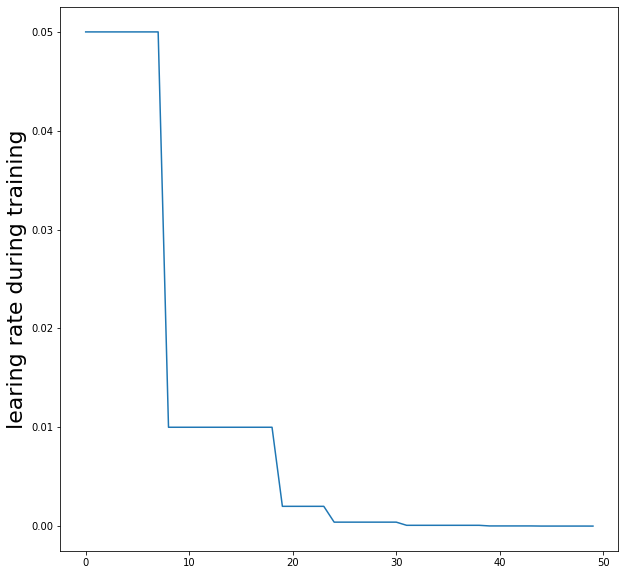

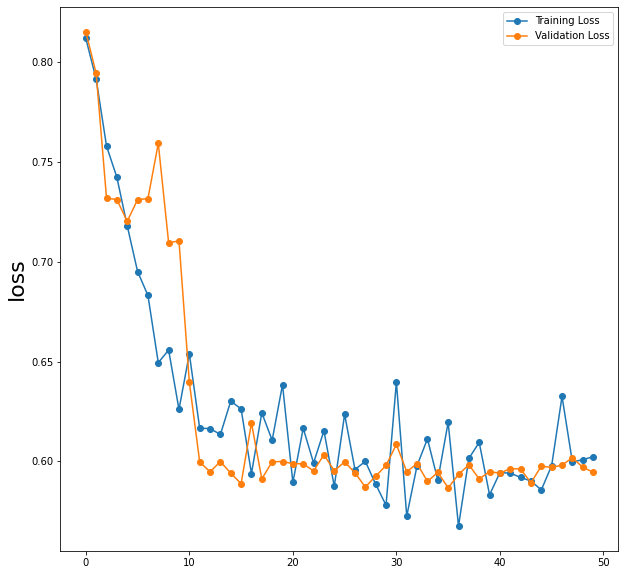

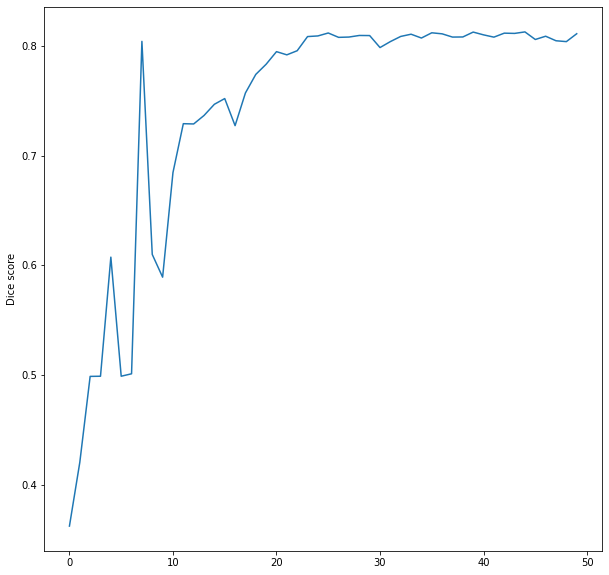

In [ ]:
plt.figure(figsize=(10,10))
plt.plot([i[0] for i in lr_rate_list])
plt.ylabel('learing rate during training', fontsize=22)
plt.show()

plt.figure(figsize=(10,10))
plt.plot(train_loss_list,  marker='o', label="Training Loss")
plt.plot(valid_loss_list,  marker='o', label="Validation Loss")
plt.ylabel('loss', fontsize=22)
plt.legend()
plt.show()

plt.figure(figsize=(10,10))
plt.plot(dice_score_list)
plt.ylabel('Dice score')
plt.show()

In [ ]:
class AverageMeter:
    def __init__(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0

    def reset(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0

    def update(self, val, n=1):
        self.val = val
        self.sum += val * n
        self.count += n
        self.avg = self.sum / self.count


def evaluate(valid_loader, model, metric=dice_no_threshold):
    losses = AverageMeter()
    model = model.to(device)
    model.eval()
    #tk0 = tqdm(valid_loader, total=len(valid_loader))
    with torch.no_grad():
        for i, batch in enumerate(tq(valid_loader)):
            #for key, value in data.items():
            #    data[key] = value.to(device)
            images, mask_target = batch
            batch_preds = model(images.to(device))
            
            #batch_preds = batch_preds.squeeze()#.argmax(0)
            #mask_target = mask_target.squeeze()#.argmax(0)
            
            dice  = metric(batch_preds.to(device),mask_target.to(device))
            losses.update(dice.mean().item(), valid_loader.batch_size)
            #tk0.set_postfix(dice_score=losses.avg)
    return losses.avg

def test(test_score, model, metric=dice_no_threshold):
    losses = AverageMeter()
    model = model.to(device)
    model.eval()
    #tk0 = tqdm(valid_loader, total=len(valid_loader))
    with torch.no_grad():
        for i, batch in enumerate(tq(test_score)):
            #for key, value in data.items():
            #    data[key] = value.to(device)
            images, mask_target = batch
            batch_preds = model(images.to(device))
            
            #batch_preds = batch_preds.squeeze()#.argmax(0)
            #mask_target = mask_target.squeeze()#.argmax(0)
            
            dice  = metric(batch_preds.to(device),mask_target.to(device))
            losses.update(dice.mean().item(), test_score.batch_size)
            #tk0.set_postfix(dice_score=losses.avg)
    return losses.avg

In [ ]:
valid_score = evaluate(validation_loader, model3, metric=dice_no_threshold)
print(f"Valid dice score: {valid_score}")

  0%|          | 0/2 [00:00<?, ?it/s]

Valid dice score: 0.8108626008033752


In [ ]:
test_score = test(test_loader, model3, metric=dice_no_threshold)
print(f"Test dice score: {test_score}")

  0%|          | 0/18 [00:00<?, ?it/s]

Test dice score: 0.8603686160511441


# SegNet

In [ ]:
import random
import pathlib

import torch
import numpy as np
import matplotlib.pyplot as plt

import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import torchvision.transforms as transforms
from torchvision.datasets import ImageFolder
import torchvision.datasets as datasets
from torch.utils.data import DataLoader, TensorDataset
from torchvision.utils import make_grid
from IPython.display import HTML, display

import tqdm
from tqdm.auto import tqdm as tq
from tqdm.notebook import tqdm, trange
from time import sleep
%matplotlib inline 

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

In [ ]:
torch.manual_seed(522)
np.random.seed(522)

Data Splitting & Data Loading

In [ ]:
train_data = ImageDataset(train = True, train_size=72, resize = 256, clipping = True, normalize= True, mask_type = "one_hot", spatial_transform= spatial_transform, nonspatial_transform = nonspatial_transform)
test_data = ImageDataset(train = False, train_size=72, resize = 256, clipping = True, normalize = True, mask_type = "one_hot")

#split validation data and test data
validation_data, test_data = torch.utils.data.random_split(test_data, [10, 18])

In [ ]:
train_loader = DataLoader(train_data, batch_size= 12,
                         shuffle=True, num_workers=0)
validation_loader = DataLoader(validation_data, batch_size=5,
                         shuffle=True, num_workers=0)
test_loader = DataLoader(test_data, batch_size=1,
                         shuffle=True, num_workers=0)

In [ ]:
class Segnet(nn.Module):
    def __init__(self):
        super(Segnet, self).__init__()
        momentum = 0.1

        self.conv11 = nn.Conv2d(1, 64, kernel_size=3, padding=1)
        self.bn11 = nn.BatchNorm2d(64, momentum=momentum)
        self.conv12 = nn.Conv2d(64, 64, kernel_size=3, padding=1)
        self.bn12 = nn.BatchNorm2d(64, momentum=momentum)

        self.conv21 = nn.Conv2d(64, 128, kernel_size=3, padding=1)
        self.bn21 = nn.BatchNorm2d(128, momentum=momentum)
        self.conv22 = nn.Conv2d(128, 128, kernel_size=3, padding=1)
        self.bn22 = nn.BatchNorm2d(128, momentum=momentum)

        self.conv31 = nn.Conv2d(128, 256, kernel_size=3, padding=1)
        self.bn31 = nn.BatchNorm2d(256, momentum=momentum)
        self.conv32 = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.bn32 = nn.BatchNorm2d(256, momentum=momentum)
        self.conv33 = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.bn33 = nn.BatchNorm2d(256, momentum=momentum)

        self.conv41 = nn.Conv2d(256, 512, kernel_size=3, padding=1)
        self.bn41 = nn.BatchNorm2d(512, momentum=momentum)
        self.conv42 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.bn42 = nn.BatchNorm2d(512, momentum=momentum)
        self.conv43 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.bn43 = nn.BatchNorm2d(512, momentum=momentum)

        self.conv51 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.bn51 = nn.BatchNorm2d(512, momentum=momentum)
        self.conv52 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.bn52 = nn.BatchNorm2d(512, momentum=momentum)
        self.conv53 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.bn53 = nn.BatchNorm2d(512, momentum=momentum)

        self.conv53d = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.bn53d = nn.BatchNorm2d(512, momentum=momentum)
        self.conv52d = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.bn52d = nn.BatchNorm2d(512, momentum=momentum)
        self.conv51d = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.bn51d = nn.BatchNorm2d(512, momentum=momentum)

        self.conv43d = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.bn43d = nn.BatchNorm2d(512, momentum=momentum)
        self.conv42d = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.bn42d = nn.BatchNorm2d(512, momentum=momentum)
        self.conv41d = nn.Conv2d(512, 256, kernel_size=3, padding=1)
        self.bn41d = nn.BatchNorm2d(256, momentum=momentum)

        self.conv33d = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.bn33d = nn.BatchNorm2d(256, momentum=momentum)
        self.conv32d = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.bn32d = nn.BatchNorm2d(256, momentum=momentum)
        self.conv31d = nn.Conv2d(256,  128, kernel_size=3, padding=1)
        self.bn31d = nn.BatchNorm2d(128, momentum=momentum)

        self.conv22d = nn.Conv2d(128, 128, kernel_size=3, padding=1)
        self.bn22d = nn.BatchNorm2d(128, momentum=momentum)
        self.conv21d = nn.Conv2d(128, 64, kernel_size=3, padding=1)
        self.bn21d = nn.BatchNorm2d(64, momentum=momentum)

        self.conv12d = nn.Conv2d(64, 64, kernel_size=3, padding=1)
        self.bn12d = nn.BatchNorm2d(64, momentum=momentum)
        self.conv11d = nn.Conv2d(64, 4, kernel_size=3, padding=1)

    def forward(self, x):
        # Stage 1
        x11 = F.relu(self.bn11(self.conv11(x)))
        x12 = F.relu(self.bn12(self.conv12(x11)))
        x1p, id1 = F.max_pool2d(x12,kernel_size=2, stride=2,return_indices=True)

        # Stage 2
        x21 = F.relu(self.bn21(self.conv21(x1p)))
        x22 = F.relu(self.bn22(self.conv22(x21)))
        x2p, id2 = F.max_pool2d(x22,kernel_size=2, stride=2,return_indices=True)

        # Stage 3
        x31 = F.relu(self.bn31(self.conv31(x2p)))
        x32 = F.relu(self.bn32(self.conv32(x31)))
        x33 = F.relu(self.bn33(self.conv33(x32)))
        x3p, id3 = F.max_pool2d(x33,kernel_size=2, stride=2,return_indices=True)

        # Stage 4
        x41 = F.relu(self.bn41(self.conv41(x3p)))
        x42 = F.relu(self.bn42(self.conv42(x41)))
        x43 = F.relu(self.bn43(self.conv43(x42)))
        x4p, id4 = F.max_pool2d(x43,kernel_size=2, stride=2,return_indices=True)

        # Stage 5
        x51 = F.relu(self.bn51(self.conv51(x4p)))
        x52 = F.relu(self.bn52(self.conv52(x51)))
        x53 = F.relu(self.bn53(self.conv53(x52)))
        x5p, id5 = F.max_pool2d(x53,kernel_size=2, stride=2,return_indices=True)


        # Stage 5d
        x5d = F.max_unpool2d(x5p, id5, kernel_size=2, stride=2)
        x53d = F.relu(self.bn53d(self.conv53d(x5d)))
        x52d = F.relu(self.bn52d(self.conv52d(x53d)))
        x51d = F.relu(self.bn51d(self.conv51d(x52d)))

        # Stage 4d
        x4d = F.max_unpool2d(x51d, id4, kernel_size=2, stride=2)
        x43d = F.relu(self.bn43d(self.conv43d(x4d)))
        x42d = F.relu(self.bn42d(self.conv42d(x43d)))
        x41d = F.relu(self.bn41d(self.conv41d(x42d)))

        # Stage 3d
        x3d = F.max_unpool2d(x41d, id3, kernel_size=2, stride=2)
        x33d = F.relu(self.bn33d(self.conv33d(x3d)))
        x32d = F.relu(self.bn32d(self.conv32d(x33d)))
        x31d = F.relu(self.bn31d(self.conv31d(x32d)))

        # Stage 2d
        x2d = F.max_unpool2d(x31d, id2, kernel_size=2, stride=2)
        x22d = F.relu(self.bn22d(self.conv22d(x2d)))
        x21d = F.relu(self.bn21d(self.conv21d(x22d)))

        # Stage 1d
        x1d = F.max_unpool2d(x21d, id1, kernel_size=2, stride=2)
        x12d = F.relu(self.bn12d(self.conv12d(x1d)))
        x11d = self.conv11d(x12d)

        return torch.sigmoid(x11d)

In [ ]:
torch.cuda.empty_cache()

In [ ]:
model = Segnet().float()
model.to(device)
print(model)

## Base Segnet Model

## Training

In [ ]:
criterion = MultiFocalTverskyLoss(alpha = torch.tensor([.5, .6, .7, .8]).to(device), gamma = .75)
optimizer = RAdam(model.parameters(), lr = 5e-2)
current_lr = [param_group['lr'] for param_group in optimizer.param_groups][0]
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, factor=0.2, patience=2, cooldown=2)

In [ ]:
import tqdm
from tqdm.auto import tqdm as tq

def dice_no_threshold(
    outputs: torch.Tensor,
    targets: torch.Tensor,
    eps: float = 1e-7,
    threshold: float = None,
):
    """
    Reference:
    https://catalyst-team.github.io/catalyst/_modules/catalyst/dl/utils/criterion/dice.html
    """
    if threshold is not None:
        outputs = (outputs > threshold).float()

    intersection = torch.sum(targets * outputs)
    union = torch.sum(targets) + torch.sum(outputs)
    dice = 2 * intersection / (union + eps)

    return dice

n_epochs = 50#32
train_loss_list = []
valid_loss_list = []
dice_score_list = []
lr_rate_list = []
valid_loss_min = np.Inf # track change in validation loss
for epoch in range(1, n_epochs+1):

    # keep track of training and validation loss
    train_loss = 0.0
    valid_loss = 0.0
    dice_score = 0.0
    ###################
    # train the model #
    ###################
    model.train()
    bar = tq(train_loader, postfix={"train_loss":0.0})
    for data, target in bar:
        # move tensors to GPU if CUDA is available
        data, target = data.to(device), target.to(device)
        # clear the gradients of all optimized variables
        optimizer.zero_grad()
        # forward pass: compute predicted outputs by passing inputs to the model
        output = model(data)
        # calculate the batch loss
        # print(output.size())
        # print(target.size())
        loss = criterion(output, target)
        #print(loss)
        # backward pass: compute gradient of the loss with respect to model parameters
        loss.backward()
        # perform a single optimization step (parameter update)
        optimizer.step()
        # update training loss
        train_loss += loss.item()*data.size(0)
        bar.set_postfix(ordered_dict={"train_loss":loss.item()})
    ######################    
    # validate the model #
    ######################
    model.eval()
    del data, target
    with torch.no_grad():
        bar = tq(validation_loader, postfix={"valid_loss":0.0, "dice_score":0.0})
        for data, target in bar:
            # move tensors to GPU if CUDA is available
            
            data, target = data.to(device), target.to(device)
            # forward pass: compute predicted outputs by passing inputs to the model
            output = model(data)
            # calculate the batch loss
            loss = criterion(output, target)
            # update average validation loss 
            valid_loss += loss.item()*data.size(0)
            dice_cof = dice_no_threshold(output.cpu(), target.cpu()).item()
            dice_score +=  dice_cof * data.size(0)
            bar.set_postfix(ordered_dict={"valid_loss":loss.item(), "dice_score":dice_cof})
    
    # calculate average losses
    train_loss = train_loss/len(train_loader.dataset)
    valid_loss = valid_loss/len(validation_loader.dataset)
    dice_score = dice_score/len(validation_loader.dataset)
    train_loss_list.append(train_loss)
    valid_loss_list.append(valid_loss)
    dice_score_list.append(dice_score)
    lr_rate_list.append([param_group['lr'] for param_group in optimizer.param_groups])
    
    # print training/validation statistics 
    print('Epoch: {}  Training Loss: {:.6f}  Validation Loss: {:.6f} Dice Score: {:.6f}'.format(
        epoch, train_loss, valid_loss, dice_score))
    
    # save model if validation loss has decreased
    if valid_loss <= valid_loss_min:
        print('Validation loss decreased ({:.6f} --> {:.6f}).  Saving model ...'.format(
        valid_loss_min,
        valid_loss))
        torch.save(model.state_dict(), 'model_cifar.pt')
        valid_loss_min = valid_loss
    
    scheduler.step(valid_loss)

## Plotting

In [ ]:
model.eval()

# try to plot prediction vs target to see how we did
predictions = []
fig, (ax1,ax2)=plt.subplots(1,2,figsize=(15,15))
fig.suptitle('predicted_mask//original_mask')
for i, batch in enumerate(tq(test_loader)):
    images,mask_target = batch
    batch_preds = model(images.to(device))
    print(batch_preds.size())
    print(mask_target.size())
    batch_preds = batch_preds.squeeze().argmax(0)
    mask_target = mask_target.squeeze().argmax(0)
    batch_preds = batch_preds.detach().cpu().numpy()

    ax1.imshow(batch_preds)
    ax2.imshow(mask_target)
    break

In [ ]:
model.eval()

# try to plot prediction vs target to see how we did
predictions = []
fig, (ax1,ax2)=plt.subplots(1,2,figsize=(15,15))
fig.suptitle('predicted_mask//original_mask')
for i, batch in enumerate(tq(test_loader)):
    images, mask_target = batch
    batch_preds = model(images.to(device))
    # print(batch_preds.size())
    # print(mask_target.size())
    batch_preds = batch_preds.squeeze().argmax(0)
    mask_target = mask_target.squeeze().argmax(0)
    batch_preds = batch_preds.detach().cpu().numpy()
    mask_target = mask_target.detach().cpu().numpy()

    color_map = {0: np.array([75,0,130]), # purple
              1: np.array([255,255,102]), # yellow
             2: np.array([32,178,170]), # sea green
             3: np.array([0,100,0])} # dark green

    # make a 3d numpy array that has a color channel dimension   
    preds_3d = np.ndarray(shape=(batch_preds.shape[0], batch_preds.shape[1], 3), dtype=int)
    for i in range(0, batch_preds.shape[0]):
        for j in range(0, batch_preds.shape[1]):
            preds_3d[i][j] = color_map[batch_preds[i][j]]
    
    mask_3d = np.ndarray(shape=(mask_target.shape[0], mask_target.shape[1], 3), dtype=int)
    for i in range(0, mask_target.shape[0]):
        for j in range(0, mask_target.shape[1]):
            mask_3d[i][j] = color_map[mask_target[i][j]]

    ax1.imshow(preds_3d)
    ax2.imshow(mask_3d)
    break

## Testing

In [ ]:
class AverageMeter:
    def __init__(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0

    def reset(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0

    def update(self, val, n=1):
        self.val = val
        self.sum += val * n
        self.count += n
        self.avg = self.sum / self.count


def evaluate(valid_loader, model, metric=dice_no_threshold):
    losses = AverageMeter()
    model = model.to(device)
    model.eval()
    #tk0 = tqdm(valid_loader, total=len(valid_loader))
    with torch.no_grad():
        for i, batch in enumerate(tq(valid_loader)):
            #for key, value in data.items():
            #    data[key] = value.to(device)
            images, mask_target = batch
            batch_preds = model(images.to(device))
            
            #batch_preds = batch_preds.squeeze()#.argmax(0)
            #mask_target = mask_target.squeeze()#.argmax(0)
            
            dice  = metric(batch_preds.to(device),mask_target.to(device))
            losses.update(dice.mean().item(), valid_loader.batch_size)
            #tk0.set_postfix(dice_score=losses.avg)
    return losses.avg

def test(test_score, model, metric=dice_no_threshold):
    losses = AverageMeter()
    model = model.to(device)
    model.eval()
    #tk0 = tqdm(valid_loader, total=len(valid_loader))
    with torch.no_grad():
        for i, batch in enumerate(tq(test_score)):
            #for key, value in data.items():
            #    data[key] = value.to(device)
            images, mask_target = batch
            batch_preds = model(images.to(device))
            
            #batch_preds = batch_preds.squeeze()#.argmax(0)
            #mask_target = mask_target.squeeze()#.argmax(0)
            
            dice  = metric(batch_preds.to(device),mask_target.to(device))
            losses.update(dice.mean().item(), test_score.batch_size)
            #tk0.set_postfix(dice_score=losses.avg)
    return losses.avg

In [ ]:
valid_score = evaluate(validation_loader, net, metric=dice_no_threshold)
print(f"Valid dice score: {valid_score}")

In [ ]:
test_score = test(test_loader, net, metric=dice_no_threshold)
print(f"Test dice score: {test_score}")

## Deeper Segnet

In [ ]:
class Segnet2(nn.Module):
    def __init__(self):
        super(Segnet2, self).__init__()
        momentum = 0.1

        # Stage 1
        self.conv11 = nn.Conv2d(1, 64, kernel_size=3, padding=1)
        self.bn11 = nn.BatchNorm2d(64, momentum=momentum)
        self.conv12 = nn.Conv2d(64, 64, kernel_size=3, padding=1)
        self.bn12 = nn.BatchNorm2d(64, momentum=momentum)

        # Stage 2
        self.conv21 = nn.Conv2d(64, 128, kernel_size=3, padding=1)
        self.bn21 = nn.BatchNorm2d(128, momentum=momentum)
        self.conv22 = nn.Conv2d(128, 128, kernel_size=3, padding=1)
        self.bn22 = nn.BatchNorm2d(128, momentum=momentum)

        # Stage 3
        self.conv31 = nn.Conv2d(128, 256, kernel_size=3, padding=1)
        self.bn31 = nn.BatchNorm2d(256, momentum=momentum)
        self.conv32 = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.bn32 = nn.BatchNorm2d(256, momentum=momentum)
        self.conv33 = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.bn33 = nn.BatchNorm2d(256, momentum=momentum)

        # Stage 4
        self.conv41 = nn.Conv2d(256, 512, kernel_size=3, padding=1)
        self.bn41 = nn.BatchNorm2d(512, momentum=momentum)
        self.conv42 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.bn42 = nn.BatchNorm2d(512, momentum=momentum)
        self.conv43 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.bn43 = nn.BatchNorm2d(512, momentum=momentum)

        # Stage 5
        self.conv51 = nn.Conv2d(512, 1024, kernel_size=3, padding=1)
        self.bn51 = nn.BatchNorm2d(1024, momentum=momentum)
        self.conv52 = nn.Conv2d(1024, 1024, kernel_size=3, padding=1)
        self.bn52 = nn.BatchNorm2d(1024, momentum=momentum)
        self.conv53 = nn.Conv2d(1024, 1024, kernel_size=3, padding=1)
        self.bn53 = nn.BatchNorm2d(1024, momentum=momentum)

        # Stage 6
        self.conv61 = nn.Conv2d(1024, 1024, kernel_size=3, padding=1)
        self.bn61 = nn.BatchNorm2d(1024, momentum=momentum)
        self.conv62 = nn.Conv2d(1024, 1024, kernel_size=3, padding=1)
        self.bn62 = nn.BatchNorm2d(1024, momentum=momentum)
        self.conv63 = nn.Conv2d(1024, 1024, kernel_size=3, padding=1)
        self.bn63 = nn.BatchNorm2d(1024, momentum=momentum)

        # Stage 6d
        self.conv63d = nn.Conv2d(1024, 1024, kernel_size=3, padding=1)
        self.bn63d = nn.BatchNorm2d(1024, momentum=momentum)
        self.conv62d = nn.Conv2d(1024, 1024, kernel_size=3, padding=1)
        self.bn62d = nn.BatchNorm2d(1024, momentum=momentum)
        self.conv61d = nn.Conv2d(1024, 1024, kernel_size=3, padding=1)
        self.bn61d = nn.BatchNorm2d(1024, momentum=momentum)

        # Stage 5d
        self.conv53d = nn.Conv2d(1024, 1024, kernel_size=3, padding=1)
        self.bn53d = nn.BatchNorm2d(1024, momentum=momentum)
        self.conv52d = nn.Conv2d(1024, 1024, kernel_size=3, padding=1)
        self.bn52d = nn.BatchNorm2d(1024, momentum=momentum)
        self.conv51d = nn.Conv2d(1024, 512, kernel_size=3, padding=1)
        self.bn51d = nn.BatchNorm2d(512, momentum=momentum)

        # Stage 4d
        self.conv43d = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.bn43d = nn.BatchNorm2d(512, momentum=momentum)
        self.conv42d = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.bn42d = nn.BatchNorm2d(512, momentum=momentum)
        self.conv41d = nn.Conv2d(512, 256, kernel_size=3, padding=1)
        self.bn41d = nn.BatchNorm2d(256, momentum=momentum)

        # Stage 3d
        self.conv33d = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.bn33d = nn.BatchNorm2d(256, momentum=momentum)
        self.conv32d = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.bn32d = nn.BatchNorm2d(256, momentum=momentum)
        self.conv31d = nn.Conv2d(256,  128, kernel_size=3, padding=1)
        self.bn31d = nn.BatchNorm2d(128, momentum=momentum)

        # Stage 2d
        self.conv22d = nn.Conv2d(128, 128, kernel_size=3, padding=1)
        self.bn22d = nn.BatchNorm2d(128, momentum=momentum)
        self.conv21d = nn.Conv2d(128, 64, kernel_size=3, padding=1)
        self.bn21d = nn.BatchNorm2d(64, momentum=momentum)

        # Stage 1d
        self.conv12d = nn.Conv2d(64, 64, kernel_size=3, padding=1)
        self.bn12d = nn.BatchNorm2d(64, momentum=momentum)
        self.conv11d = nn.Conv2d(64, 4, kernel_size=3, padding=1)

    def forward(self, x):
        # Stage 1
        x11 = F.relu(self.bn11(self.conv11(x)))
        x12 = F.relu(self.bn12(self.conv12(x11)))
        x1p, id1 = F.max_pool2d(x12,kernel_size=2, stride=2,return_indices=True)

        # Stage 2
        x21 = F.relu(self.bn21(self.conv21(x1p)))
        x22 = F.relu(self.bn22(self.conv22(x21)))
        x2p, id2 = F.max_pool2d(x22,kernel_size=2, stride=2,return_indices=True)

        # Stage 3
        x31 = F.relu(self.bn31(self.conv31(x2p)))
        x32 = F.relu(self.bn32(self.conv32(x31)))
        x33 = F.relu(self.bn33(self.conv33(x32)))
        x3p, id3 = F.max_pool2d(x33,kernel_size=2, stride=2,return_indices=True)

        # Stage 4
        x41 = F.relu(self.bn41(self.conv41(x3p)))
        x42 = F.relu(self.bn42(self.conv42(x41)))
        x43 = F.relu(self.bn43(self.conv43(x42)))
        x4p, id4 = F.max_pool2d(x43,kernel_size=2, stride=2,return_indices=True)

        # Stage 5
        x51 = F.relu(self.bn51(self.conv51(x4p)))
        x52 = F.relu(self.bn52(self.conv52(x51)))
        x53 = F.relu(self.bn53(self.conv53(x52)))
        x5p, id5 = F.max_pool2d(x53,kernel_size=2, stride=2,return_indices=True)

        # Stage 6
        x61 = F.relu(self.bn61(self.conv61(x5p)))
        x62 = F.relu(self.bn62(self.conv62(x61)))
        x63 = F.relu(self.bn63(self.conv63(x62)))
        x6p, id6 = F.max_pool2d(x63,kernel_size=2, stride=2,return_indices=True)

        # Stage 6d
        x6d = F.max_unpool2d(x6p, id6, kernel_size=2, stride=2)
        x63d = F.relu(self.bn63d(self.conv63d(x6d)))
        x62d = F.relu(self.bn62d(self.conv62d(x63d)))
        x61d = F.relu(self.bn61d(self.conv61d(x62d)))

        # Stage 5d
        x5d = F.max_unpool2d(x5p, id5, kernel_size=2, stride=2)
        x53d = F.relu(self.bn53d(self.conv53d(x5d)))
        x52d = F.relu(self.bn52d(self.conv52d(x53d)))
        x51d = F.relu(self.bn51d(self.conv51d(x52d)))

        # Stage 4d
        x4d = F.max_unpool2d(x51d, id4, kernel_size=2, stride=2)
        x43d = F.relu(self.bn43d(self.conv43d(x4d)))
        x42d = F.relu(self.bn42d(self.conv42d(x43d)))
        x41d = F.relu(self.bn41d(self.conv41d(x42d)))

        # Stage 3d
        x3d = F.max_unpool2d(x41d, id3, kernel_size=2, stride=2)
        x33d = F.relu(self.bn33d(self.conv33d(x3d)))
        x32d = F.relu(self.bn32d(self.conv32d(x33d)))
        x31d = F.relu(self.bn31d(self.conv31d(x32d)))

        # Stage 2d
        x2d = F.max_unpool2d(x31d, id2, kernel_size=2, stride=2)
        x22d = F.relu(self.bn22d(self.conv22d(x2d)))
        x21d = F.relu(self.bn21d(self.conv21d(x22d)))

        # Stage 1d
        x1d = F.max_unpool2d(x21d, id1, kernel_size=2, stride=2)
        x12d = F.relu(self.bn12d(self.conv12d(x1d)))
        x11d = self.conv11d(x12d)

        return torch.sigmoid(x11d)

In [ ]:
torch.cuda.empty_cache()

In [ ]:
segnet2 = Segnet2().float()
segnet2.to(device)
print(segnet2)

Segnet2(
  (conv11): Conv2d(1, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn11): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv12): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn12): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv21): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn21): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv22): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn22): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv31): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn31): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv32): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn32): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True,

### Training

In [ ]:
criterion = MultiFocalTverskyLoss(alpha = torch.tensor([.5, .6, .7, .8]).to(device), gamma = .75)
optimizer = RAdam(segnet2.parameters(), lr = 5e-2)
current_lr = [param_group['lr'] for param_group in optimizer.param_groups][0]
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, factor=0.2, patience=2, cooldown=2)

In [ ]:
import tqdm
from tqdm.auto import tqdm as tq

def dice_no_threshold(
    outputs: torch.Tensor,
    targets: torch.Tensor,
    eps: float = 1e-7,
    threshold: float = None,
):
    """
    Reference:
    https://catalyst-team.github.io/catalyst/_modules/catalyst/dl/utils/criterion/dice.html
    """
    if threshold is not None:
        outputs = (outputs > threshold).float()

    intersection = torch.sum(targets * outputs)
    union = torch.sum(targets) + torch.sum(outputs)
    dice = 2 * intersection / (union + eps)

    return dice

n_epochs = 50#32
train_loss_list = []
valid_loss_list = []
dice_score_list = []
lr_rate_list = []
valid_loss_min = np.Inf # track change in validation loss
for epoch in range(1, n_epochs+1):

    # keep track of training and validation loss
    train_loss = 0.0
    valid_loss = 0.0
    dice_score = 0.0
    ###################
    # train the model #
    ###################
    segnet2.train()
    bar = tq(train_loader, postfix={"train_loss":0.0})
    for data, target in bar:
        # move tensors to GPU if CUDA is available
        data, target = data.to(device), target.to(device)
        # clear the gradients of all optimized variables
        optimizer.zero_grad()
        # forward pass: compute predicted outputs by passing inputs to the model
        output = segnet2(data)
        # calculate the batch loss
        # print(output.size())
        # print(target.size())
        loss = criterion(output, target)
        #print(loss)
        # backward pass: compute gradient of the loss with respect to model parameters
        loss.backward()
        # perform a single optimization step (parameter update)
        optimizer.step()
        # update training loss
        train_loss += loss.item()*data.size(0)
        bar.set_postfix(ordered_dict={"train_loss":loss.item()})
    ######################    
    # validate the model #
    ######################
    segnet2.eval()
    del data, target
    with torch.no_grad():
        bar = tq(validation_loader, postfix={"valid_loss":0.0, "dice_score":0.0})
        for data, target in bar:
            # move tensors to GPU if CUDA is available
            
            data, target = data.to(device), target.to(device)
            # forward pass: compute predicted outputs by passing inputs to the model
            output = segnet2(data)
            # calculate the batch loss
            loss = criterion(output, target)
            # update average validation loss 
            valid_loss += loss.item()*data.size(0)
            dice_cof = dice_no_threshold(output.cpu(), target.cpu()).item()
            dice_score +=  dice_cof * data.size(0)
            bar.set_postfix(ordered_dict={"valid_loss":loss.item(), "dice_score":dice_cof})
    
    # calculate average losses
    train_loss = train_loss/len(train_loader.dataset)
    valid_loss = valid_loss/len(validation_loader.dataset)
    dice_score = dice_score/len(validation_loader.dataset)
    train_loss_list.append(train_loss)
    valid_loss_list.append(valid_loss)
    dice_score_list.append(dice_score)
    lr_rate_list.append([param_group['lr'] for param_group in optimizer.param_groups])
    
    # print training/validation statistics 
    print('Epoch: {}  Training Loss: {:.6f}  Validation Loss: {:.6f} Dice Score: {:.6f}'.format(
        epoch, train_loss, valid_loss, dice_score))
    
    # save model if validation loss has decreased
    if valid_loss <= valid_loss_min:
        print('Validation loss decreased ({:.6f} --> {:.6f}).  Saving model ...'.format(
        valid_loss_min,
        valid_loss))
        torch.save(model.state_dict(), 'model_cifar.pt')
        valid_loss_min = valid_loss
    
    scheduler.step(valid_loss)

  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

/usr/local/lib/python3.7/dist-packages/torchio/transforms/augmentation/spatial/random_elastic_deformation.py:263: RuntimeWarning: The maximum displacement is larger than the coarse grid spacing for dimensions: [2], so folding may occur. Choose fewer control points or a smaller maximum displacement
  warnings.warn(message, RuntimeWarning)
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:749: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool2d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 1  Training Loss: 0.823309  Validation Loss: 0.810858 Dice Score: 0.342342
Validation loss decreased (inf --> 0.810858).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 2  Training Loss: 0.765380  Validation Loss: 0.752081 Dice Score: 0.457043
Validation loss decreased (0.810858 --> 0.752081).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 3  Training Loss: 0.737017  Validation Loss: 0.733622 Dice Score: 0.478883
Validation loss decreased (0.752081 --> 0.733622).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 4  Training Loss: 0.730684  Validation Loss: 0.727408 Dice Score: 0.498720
Validation loss decreased (0.733622 --> 0.727408).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 5  Training Loss: 0.731124  Validation Loss: 0.718580 Dice Score: 0.522359
Validation loss decreased (0.727408 --> 0.718580).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 6  Training Loss: 0.720895  Validation Loss: 0.754514 Dice Score: 0.574871


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 7  Training Loss: 0.707747  Validation Loss: 0.740670 Dice Score: 0.595026


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 8  Training Loss: 0.662479  Validation Loss: 0.739849 Dice Score: 0.587434


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 9  Training Loss: 0.677638  Validation Loss: 0.719489 Dice Score: 0.520444


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 10  Training Loss: 0.635160  Validation Loss: 0.713952 Dice Score: 0.530344
Validation loss decreased (0.718580 --> 0.713952).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 11  Training Loss: 0.632531  Validation Loss: 0.708497 Dice Score: 0.538960
Validation loss decreased (0.713952 --> 0.708497).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 12  Training Loss: 0.640186  Validation Loss: 0.594771 Dice Score: 0.622220
Validation loss decreased (0.708497 --> 0.594771).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 13  Training Loss: 0.636635  Validation Loss: 0.630838 Dice Score: 0.606456


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 14  Training Loss: 0.636514  Validation Loss: 0.670194 Dice Score: 0.582931


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 15  Training Loss: 0.634114  Validation Loss: 0.682104 Dice Score: 0.573529


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 16  Training Loss: 0.636902  Validation Loss: 0.600692 Dice Score: 0.617448


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 17  Training Loss: 0.633739  Validation Loss: 0.578255 Dice Score: 0.622712
Validation loss decreased (0.594771 --> 0.578255).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 18  Training Loss: 0.617593  Validation Loss: 0.564840 Dice Score: 0.626678
Validation loss decreased (0.578255 --> 0.564840).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 19  Training Loss: 0.624233  Validation Loss: 0.563767 Dice Score: 0.626789
Validation loss decreased (0.564840 --> 0.563767).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 20  Training Loss: 0.627716  Validation Loss: 0.568109 Dice Score: 0.624647


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 21  Training Loss: 0.610036  Validation Loss: 0.562183 Dice Score: 0.626960
Validation loss decreased (0.563767 --> 0.562183).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 22  Training Loss: 0.660785  Validation Loss: 0.560335 Dice Score: 0.625280
Validation loss decreased (0.562183 --> 0.560335).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 23  Training Loss: 0.631274  Validation Loss: 0.568875 Dice Score: 0.622953


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 24  Training Loss: 0.612269  Validation Loss: 0.572136 Dice Score: 0.621440


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 25  Training Loss: 0.650943  Validation Loss: 0.569027 Dice Score: 0.622339


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 26  Training Loss: 0.616999  Validation Loss: 0.565478 Dice Score: 0.623161


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 27  Training Loss: 0.641456  Validation Loss: 0.560566 Dice Score: 0.623516


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 28  Training Loss: 0.645389  Validation Loss: 0.570629 Dice Score: 0.621647


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 29  Training Loss: 0.623515  Validation Loss: 0.555358 Dice Score: 0.624198
Validation loss decreased (0.560335 --> 0.555358).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 30  Training Loss: 0.642364  Validation Loss: 0.569371 Dice Score: 0.622498


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 31  Training Loss: 0.637093  Validation Loss: 0.569129 Dice Score: 0.622763


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 32  Training Loss: 0.623939  Validation Loss: 0.587625 Dice Score: 0.617930


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 33  Training Loss: 0.620918  Validation Loss: 0.571208 Dice Score: 0.619868


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 34  Training Loss: 0.624976  Validation Loss: 0.573765 Dice Score: 0.620666


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 35  Training Loss: 0.646808  Validation Loss: 0.569325 Dice Score: 0.620975


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 36  Training Loss: 0.622739  Validation Loss: 0.563094 Dice Score: 0.621698


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 37  Training Loss: 0.642486  Validation Loss: 0.575286 Dice Score: 0.620210


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 38  Training Loss: 0.620788  Validation Loss: 0.569164 Dice Score: 0.622283


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 39  Training Loss: 0.614422  Validation Loss: 0.565659 Dice Score: 0.622756


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 40  Training Loss: 0.641235  Validation Loss: 0.565962 Dice Score: 0.621445


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 41  Training Loss: 0.615996  Validation Loss: 0.568859 Dice Score: 0.621864


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 42  Training Loss: 0.629039  Validation Loss: 0.562431 Dice Score: 0.622000


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 43  Training Loss: 0.621589  Validation Loss: 0.561805 Dice Score: 0.622568


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 44  Training Loss: 0.633700  Validation Loss: 0.574854 Dice Score: 0.617994


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 45  Training Loss: 0.627226  Validation Loss: 0.579004 Dice Score: 0.617656


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 46  Training Loss: 0.616106  Validation Loss: 0.572426 Dice Score: 0.619630


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 47  Training Loss: 0.632534  Validation Loss: 0.578237 Dice Score: 0.619247


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 48  Training Loss: 0.617283  Validation Loss: 0.574393 Dice Score: 0.618988


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 49  Training Loss: 0.619830  Validation Loss: 0.569231 Dice Score: 0.622063


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 50  Training Loss: 0.620496  Validation Loss: 0.559455 Dice Score: 0.623339


In [ ]:
torch.save(segnet2.state_dict(), '/content/drive/Shareddrives/CIS 522 Final Project/Models/Segnet2AugmentedTverskyMulticlass')

### Plotting

  0%|          | 0/18 [00:00<?, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:749: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool2d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


torch.Size([1, 4, 256, 256])
torch.Size([1, 4, 256, 256])


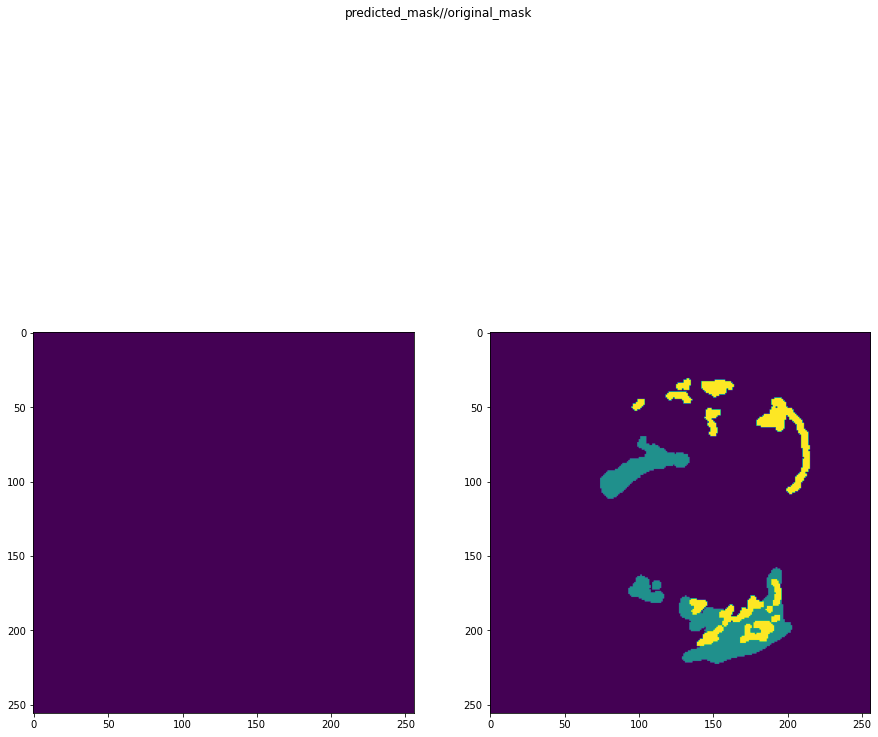

In [ ]:
segnet2.eval()

# try to plot prediction vs target to see how we did
predictions = []
fig, (ax1,ax2)=plt.subplots(1,2,figsize=(15,15))
fig.suptitle('predicted_mask//original_mask')
for i, batch in enumerate(tq(test_loader)):
    images,mask_target = batch
    batch_preds = segnet2(images.to(device))
    print(batch_preds.size())
    print(mask_target.size())
    batch_preds = batch_preds.squeeze().argmax(0)
    mask_target = mask_target.squeeze().argmax(0)
    batch_preds = batch_preds.detach().cpu().numpy()

    ax1.imshow(batch_preds)
    ax2.imshow(mask_target)
    break

  0%|          | 0/18 [00:00<?, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:749: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool2d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


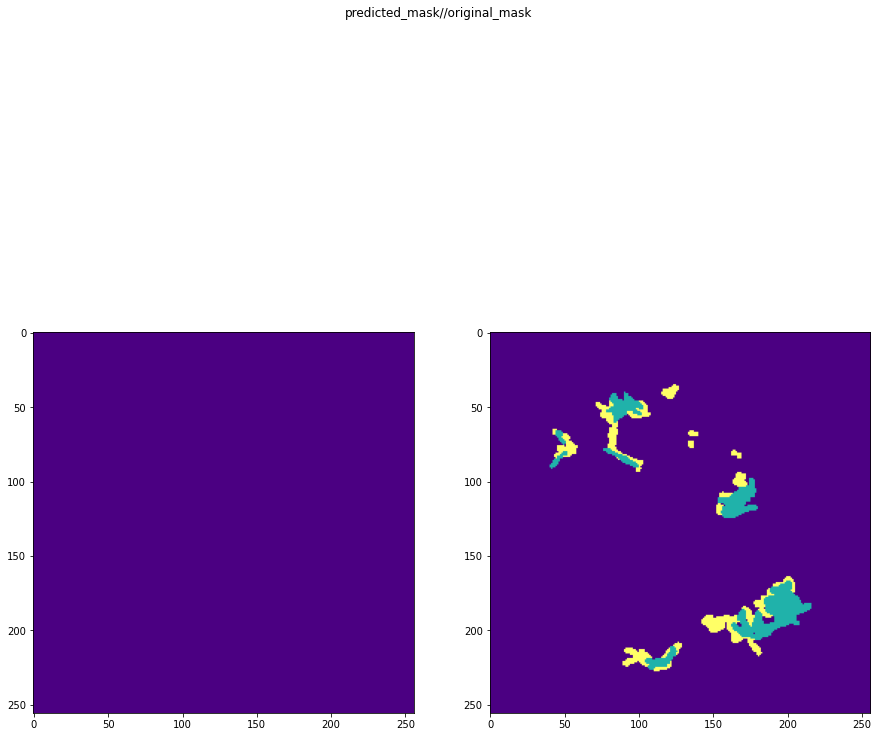

In [ ]:
segnet2.eval()

# try to plot prediction vs target to see how we did
predictions = []
fig, (ax1,ax2)=plt.subplots(1,2,figsize=(15,15))
fig.suptitle('predicted_mask//original_mask')
for i, batch in enumerate(tq(test_loader)):
    images, mask_target = batch
    batch_preds = segnet2(images.to(device))
    # print(batch_preds.size())
    # print(mask_target.size())
    batch_preds = batch_preds.squeeze().argmax(0)
    mask_target = mask_target.squeeze().argmax(0)
    batch_preds = batch_preds.detach().cpu().numpy()
    mask_target = mask_target.detach().cpu().numpy()

    color_map = {0: np.array([75,0,130]), # purple
              1: np.array([255,255,102]), # yellow
             2: np.array([32,178,170]), # sea green
             3: np.array([0,100,0])} # dark green

    # make a 3d numpy array that has a color channel dimension   
    preds_3d = np.ndarray(shape=(batch_preds.shape[0], batch_preds.shape[1], 3), dtype=int)
    for i in range(0, batch_preds.shape[0]):
        for j in range(0, batch_preds.shape[1]):
            preds_3d[i][j] = color_map[batch_preds[i][j]]
    
    mask_3d = np.ndarray(shape=(mask_target.shape[0], mask_target.shape[1], 3), dtype=int)
    for i in range(0, mask_target.shape[0]):
        for j in range(0, mask_target.shape[1]):
            mask_3d[i][j] = color_map[mask_target[i][j]]

    ax1.imshow(preds_3d)
    ax2.imshow(mask_3d)
    break

### Testing

In [ ]:
class AverageMeter:
    def __init__(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0

    def reset(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0

    def update(self, val, n=1):
        self.val = val
        self.sum += val * n
        self.count += n
        self.avg = self.sum / self.count


def evaluate(valid_loader, model, metric=dice_no_threshold):
    losses = AverageMeter()
    model = model.to(device)
    model.eval()
    #tk0 = tqdm(valid_loader, total=len(valid_loader))
    with torch.no_grad():
        for i, batch in enumerate(tq(valid_loader)):
            #for key, value in data.items():
            #    data[key] = value.to(device)
            images, mask_target = batch
            batch_preds = model(images.to(device))
            
            #batch_preds = batch_preds.squeeze()#.argmax(0)
            #mask_target = mask_target.squeeze()#.argmax(0)
            
            dice  = metric(batch_preds.to(device),mask_target.to(device))
            losses.update(dice.mean().item(), valid_loader.batch_size)
            #tk0.set_postfix(dice_score=losses.avg)
    return losses.avg

def test(test_score, model, metric=dice_no_threshold):
    losses = AverageMeter()
    model = model.to(device)
    model.eval()
    #tk0 = tqdm(valid_loader, total=len(valid_loader))
    with torch.no_grad():
        for i, batch in enumerate(tq(test_score)):
            #for key, value in data.items():
            #    data[key] = value.to(device)
            images, mask_target = batch
            batch_preds = model(images.to(device))
            
            #batch_preds = batch_preds.squeeze()#.argmax(0)
            #mask_target = mask_target.squeeze()#.argmax(0)
            
            dice  = metric(batch_preds.to(device),mask_target.to(device))
            losses.update(dice.mean().item(), test_score.batch_size)
            #tk0.set_postfix(dice_score=losses.avg)
    return losses.avg

In [ ]:
valid_score = evaluate(validation_loader, segnet2, metric=dice_no_threshold)
print(f"Valid dice score: {valid_score}")

  0%|          | 0/2 [00:00<?, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:749: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool2d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


Valid dice score: 0.6233298778533936


In [ ]:
test_score = test(test_loader, segnet2, metric=dice_no_threshold)
print(f"Test dice score: {test_score}")

  0%|          | 0/18 [00:00<?, ?it/s]

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:749: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool2d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


Test dice score: 0.633975432978736


## Even Deeper Segnet

In [ ]:
class Segnet3(nn.Module):
    def __init__(self):
        super(Segnet3, self).__init__()
        momentum = 0.1

        # Stage 1
        self.conv11 = nn.Conv2d(1, 64, kernel_size=3, padding=1)
        self.bn11 = nn.BatchNorm2d(64, momentum=momentum)
        self.conv12 = nn.Conv2d(64, 64, kernel_size=3, padding=1)
        self.bn12 = nn.BatchNorm2d(64, momentum=momentum)

        # Stage 2
        self.conv21 = nn.Conv2d(64, 128, kernel_size=3, padding=1)
        self.bn21 = nn.BatchNorm2d(128, momentum=momentum)
        self.conv22 = nn.Conv2d(128, 128, kernel_size=3, padding=1)
        self.bn22 = nn.BatchNorm2d(128, momentum=momentum)

        # Stage 3
        self.conv31 = nn.Conv2d(128, 256, kernel_size=3, padding=1)
        self.bn31 = nn.BatchNorm2d(256, momentum=momentum)
        self.conv32 = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.bn32 = nn.BatchNorm2d(256, momentum=momentum)
        self.conv33 = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.bn33 = nn.BatchNorm2d(256, momentum=momentum)

        # Stage 4
        self.conv41 = nn.Conv2d(256, 512, kernel_size=3, padding=1)
        self.bn41 = nn.BatchNorm2d(512, momentum=momentum)
        self.conv42 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.bn42 = nn.BatchNorm2d(512, momentum=momentum)
        self.conv43 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.bn43 = nn.BatchNorm2d(512, momentum=momentum)

        # Stage 5
        self.conv51 = nn.Conv2d(512, 1024, kernel_size=3, padding=1)
        self.bn51 = nn.BatchNorm2d(1024, momentum=momentum)
        self.conv52 = nn.Conv2d(1024, 1024, kernel_size=3, padding=1)
        self.bn52 = nn.BatchNorm2d(1024, momentum=momentum)
        self.conv53 = nn.Conv2d(1024, 1024, kernel_size=3, padding=1)
        self.bn53 = nn.BatchNorm2d(1024, momentum=momentum)

        # Stage 6
        self.conv61 = nn.Conv2d(1024, 2048, kernel_size=3, padding=1)
        self.bn61 = nn.BatchNorm2d(2048, momentum=momentum)
        self.conv62 = nn.Conv2d(2048, 2048, kernel_size=3, padding=1)
        self.bn62 = nn.BatchNorm2d(2048, momentum=momentum)
        self.conv63 = nn.Conv2d(2048, 2048, kernel_size=3, padding=1)
        self.bn63 = nn.BatchNorm2d(2048, momentum=momentum)
        
        # Stage 7
        self.conv71 = nn.Conv2d(2048, 2048, kernel_size=3, padding=1)
        self.bn71 = nn.BatchNorm2d(2048, momentum=momentum)
        self.conv72 = nn.Conv2d(2048, 2048, kernel_size=3, padding=1)
        self.bn72 = nn.BatchNorm2d(2048, momentum=momentum)
        self.conv73 = nn.Conv2d(2048, 2048, kernel_size=3, padding=1)
        self.bn73 = nn.BatchNorm2d(2048, momentum=momentum)

        # Stage 7d
        self.conv73d = nn.Conv2d(2048, 2048, kernel_size=3, padding=1)
        self.bn73d = nn.BatchNorm2d(2048, momentum=momentum)
        self.conv72d = nn.Conv2d(2048, 2048, kernel_size=3, padding=1)
        self.bn72d = nn.BatchNorm2d(2048, momentum=momentum)
        self.conv71d = nn.Conv2d(2048, 2048, kernel_size=3, padding=1)
        self.bn71d = nn.BatchNorm2d(2048, momentum=momentum)

        # Stage 6d
        self.conv63d = nn.Conv2d(2048, 2048, kernel_size=3, padding=1)
        self.bn63d = nn.BatchNorm2d(2048, momentum=momentum)
        self.conv62d = nn.Conv2d(2048, 2048, kernel_size=3, padding=1)
        self.bn62d = nn.BatchNorm2d(2048, momentum=momentum)
        self.conv61d = nn.Conv2d(2048, 1024, kernel_size=3, padding=1)
        self.bn61d = nn.BatchNorm2d(1024, momentum=momentum)

        # Stage 5d
        self.conv53d = nn.Conv2d(1024, 1024, kernel_size=3, padding=1)
        self.bn53d = nn.BatchNorm2d(1024, momentum=momentum)
        self.conv52d = nn.Conv2d(1024, 1024, kernel_size=3, padding=1)
        self.bn52d = nn.BatchNorm2d(1024, momentum=momentum)
        self.conv51d = nn.Conv2d(1024, 512, kernel_size=3, padding=1)
        self.bn51d = nn.BatchNorm2d(512, momentum=momentum)

        # Stage 4d
        self.conv43d = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.bn43d = nn.BatchNorm2d(512, momentum=momentum)
        self.conv42d = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.bn42d = nn.BatchNorm2d(512, momentum=momentum)
        self.conv41d = nn.Conv2d(512, 256, kernel_size=3, padding=1)
        self.bn41d = nn.BatchNorm2d(256, momentum=momentum)

        # Stage 3d
        self.conv33d = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.bn33d = nn.BatchNorm2d(256, momentum=momentum)
        self.conv32d = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.bn32d = nn.BatchNorm2d(256, momentum=momentum)
        self.conv31d = nn.Conv2d(256,  128, kernel_size=3, padding=1)
        self.bn31d = nn.BatchNorm2d(128, momentum=momentum)

        # Stage 2d
        self.conv22d = nn.Conv2d(128, 128, kernel_size=3, padding=1)
        self.bn22d = nn.BatchNorm2d(128, momentum=momentum)
        self.conv21d = nn.Conv2d(128, 64, kernel_size=3, padding=1)
        self.bn21d = nn.BatchNorm2d(64, momentum=momentum)

        # Stage 1d
        self.conv12d = nn.Conv2d(64, 64, kernel_size=3, padding=1)
        self.bn12d = nn.BatchNorm2d(64, momentum=momentum)
        self.conv11d = nn.Conv2d(64, 4, kernel_size=3, padding=1)

    def forward(self, x):
        # Stage 1
        x11 = F.relu(self.bn11(self.conv11(x)))
        x12 = F.relu(self.bn12(self.conv12(x11)))
        x1p, id1 = F.max_pool2d(x12,kernel_size=2, stride=2,return_indices=True)

        # Stage 2
        x21 = F.relu(self.bn21(self.conv21(x1p)))
        x22 = F.relu(self.bn22(self.conv22(x21)))
        x2p, id2 = F.max_pool2d(x22,kernel_size=2, stride=2,return_indices=True)

        # Stage 3
        x31 = F.relu(self.bn31(self.conv31(x2p)))
        x32 = F.relu(self.bn32(self.conv32(x31)))
        x33 = F.relu(self.bn33(self.conv33(x32)))
        x3p, id3 = F.max_pool2d(x33,kernel_size=2, stride=2,return_indices=True)

        # Stage 4
        x41 = F.relu(self.bn41(self.conv41(x3p)))
        x42 = F.relu(self.bn42(self.conv42(x41)))
        x43 = F.relu(self.bn43(self.conv43(x42)))
        x4p, id4 = F.max_pool2d(x43,kernel_size=2, stride=2,return_indices=True)

        # Stage 5
        x51 = F.relu(self.bn51(self.conv51(x4p)))
        x52 = F.relu(self.bn52(self.conv52(x51)))
        x53 = F.relu(self.bn53(self.conv53(x52)))
        x5p, id5 = F.max_pool2d(x53,kernel_size=2, stride=2,return_indices=True)

        # Stage 6
        x61 = F.relu(self.bn61(self.conv61(x5p)))
        x62 = F.relu(self.bn62(self.conv62(x61)))
        x63 = F.relu(self.bn63(self.conv63(x62)))
        x6p, id6 = F.max_pool2d(x63,kernel_size=2, stride=2,return_indices=True)

        # Stage 7
        x71 = F.relu(self.bn71(self.conv71(x6p)))
        x72 = F.relu(self.bn72(self.conv72(x71)))
        x73 = F.relu(self.bn73(self.conv73(x72)))
        x7p, id7 = F.max_pool2d(x73,kernel_size=2, stride=2,return_indices=True)

        # Stage 7d
        x7d = F.max_unpool2d(x7p, id7, kernel_size=2, stride=2)
        x73d = F.relu(self.bn73d(self.conv73d(x7d)))
        x72d = F.relu(self.bn72d(self.conv72d(x73d)))
        x71d = F.relu(self.bn71d(self.conv71d(x72d)))
        
        # Stage 6d
        x6d = F.max_unpool2d(x6p, id6, kernel_size=2, stride=2)
        x63d = F.relu(self.bn63d(self.conv63d(x6d)))
        x62d = F.relu(self.bn62d(self.conv62d(x63d)))
        x61d = F.relu(self.bn61d(self.conv61d(x62d)))

        # Stage 5d
        x5d = F.max_unpool2d(x5p, id5, kernel_size=2, stride=2)
        x53d = F.relu(self.bn53d(self.conv53d(x5d)))
        x52d = F.relu(self.bn52d(self.conv52d(x53d)))
        x51d = F.relu(self.bn51d(self.conv51d(x52d)))

        # Stage 4d
        x4d = F.max_unpool2d(x51d, id4, kernel_size=2, stride=2)
        x43d = F.relu(self.bn43d(self.conv43d(x4d)))
        x42d = F.relu(self.bn42d(self.conv42d(x43d)))
        x41d = F.relu(self.bn41d(self.conv41d(x42d)))

        # Stage 3d
        x3d = F.max_unpool2d(x41d, id3, kernel_size=2, stride=2)
        x33d = F.relu(self.bn33d(self.conv33d(x3d)))
        x32d = F.relu(self.bn32d(self.conv32d(x33d)))
        x31d = F.relu(self.bn31d(self.conv31d(x32d)))

        # Stage 2d
        x2d = F.max_unpool2d(x31d, id2, kernel_size=2, stride=2)
        x22d = F.relu(self.bn22d(self.conv22d(x2d)))
        x21d = F.relu(self.bn21d(self.conv21d(x22d)))

        # Stage 1d
        x1d = F.max_unpool2d(x21d, id1, kernel_size=2, stride=2)
        x12d = F.relu(self.bn12d(self.conv12d(x1d)))
        x11d = self.conv11d(x12d)

        return torch.sigmoid(x11d)

In [ ]:
torch.cuda.empty_cache()

In [ ]:
segnet3 = Segnet3().float()
segnet3.to(device)
print(segnet2)

RuntimeError: ignored

### Training

In [ ]:
criterion = MultiFocalTverskyLoss(alpha = torch.tensor([.5, .6, .7, .8]).to(device), gamma = .75)
optimizer = RAdam(segnet3.parameters(), lr = 5e-2)
current_lr = [param_group['lr'] for param_group in optimizer.param_groups][0]
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, factor=0.2, patience=2, cooldown=2)

In [ ]:
import tqdm
from tqdm.auto import tqdm as tq

def dice_no_threshold(
    outputs: torch.Tensor,
    targets: torch.Tensor,
    eps: float = 1e-7,
    threshold: float = None,
):
    """
    Reference:
    https://catalyst-team.github.io/catalyst/_modules/catalyst/dl/utils/criterion/dice.html
    """
    if threshold is not None:
        outputs = (outputs > threshold).float()

    intersection = torch.sum(targets * outputs)
    union = torch.sum(targets) + torch.sum(outputs)
    dice = 2 * intersection / (union + eps)

    return dice

n_epochs = 50#32
train_loss_list = []
valid_loss_list = []
dice_score_list = []
lr_rate_list = []
valid_loss_min = np.Inf # track change in validation loss
for epoch in range(1, n_epochs+1):

    # keep track of training and validation loss
    train_loss = 0.0
    valid_loss = 0.0
    dice_score = 0.0
    ###################
    # train the model #
    ###################
    segnet3.train()
    bar = tq(train_loader, postfix={"train_loss":0.0})
    for data, target in bar:
        # move tensors to GPU if CUDA is available
        data, target = data.to(device), target.to(device)
        # clear the gradients of all optimized variables
        optimizer.zero_grad()
        # forward pass: compute predicted outputs by passing inputs to the model
        output = segnet3(data)
        # calculate the batch loss
        # print(output.size())
        # print(target.size())
        loss = criterion(output, target)
        #print(loss)
        # backward pass: compute gradient of the loss with respect to model parameters
        loss.backward()
        # perform a single optimization step (parameter update)
        optimizer.step()
        # update training loss
        train_loss += loss.item()*data.size(0)
        bar.set_postfix(ordered_dict={"train_loss":loss.item()})
    ######################    
    # validate the model #
    ######################
    segnet3.eval()
    del data, target
    with torch.no_grad():
        bar = tq(validation_loader, postfix={"valid_loss":0.0, "dice_score":0.0})
        for data, target in bar:
            # move tensors to GPU if CUDA is available
            
            data, target = data.to(device), target.to(device)
            # forward pass: compute predicted outputs by passing inputs to the model
            output = segnet3(data)
            # calculate the batch loss
            loss = criterion(output, target)
            # update average validation loss 
            valid_loss += loss.item()*data.size(0)
            dice_cof = dice_no_threshold(output.cpu(), target.cpu()).item()
            dice_score +=  dice_cof * data.size(0)
            bar.set_postfix(ordered_dict={"valid_loss":loss.item(), "dice_score":dice_cof})
    
    # calculate average losses
    train_loss = train_loss/len(train_loader.dataset)
    valid_loss = valid_loss/len(validation_loader.dataset)
    dice_score = dice_score/len(validation_loader.dataset)
    train_loss_list.append(train_loss)
    valid_loss_list.append(valid_loss)
    dice_score_list.append(dice_score)
    lr_rate_list.append([param_group['lr'] for param_group in optimizer.param_groups])
    
    # print training/validation statistics 
    print('Epoch: {}  Training Loss: {:.6f}  Validation Loss: {:.6f} Dice Score: {:.6f}'.format(
        epoch, train_loss, valid_loss, dice_score))
    
    # save model if validation loss has decreased
    if valid_loss <= valid_loss_min:
        print('Validation loss decreased ({:.6f} --> {:.6f}).  Saving model ...'.format(
        valid_loss_min,
        valid_loss))
        torch.save(model.state_dict(), 'model_cifar.pt')
        valid_loss_min = valid_loss
    
    scheduler.step(valid_loss)

  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

/usr/local/lib/python3.7/dist-packages/torchio/transforms/augmentation/spatial/random_elastic_deformation.py:263: RuntimeWarning: The maximum displacement is larger than the coarse grid spacing for dimensions: [2], so folding may occur. Choose fewer control points or a smaller maximum displacement
  warnings.warn(message, RuntimeWarning)
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:749: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool2d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


RuntimeError: ignored

In [ ]:
torch.save(segnet3.state_dict(), '/content/drive/Shareddrives/CIS 522 Final Project/Models/Segnet3AugmentedTverskyMulticlass')

### Plotting

In [ ]:
segnet3.eval()

# try to plot prediction vs target to see how we did
predictions = []
fig, (ax1,ax2)=plt.subplots(1,2,figsize=(15,15))
fig.suptitle('predicted_mask//original_mask')
for i, batch in enumerate(tq(test_loader)):
    images,mask_target = batch
    batch_preds = segnet3(images.to(device))
    print(batch_preds.size())
    print(mask_target.size())
    batch_preds = batch_preds.squeeze().argmax(0)
    mask_target = mask_target.squeeze().argmax(0)
    batch_preds = batch_preds.detach().cpu().numpy()

    ax1.imshow(batch_preds)
    ax2.imshow(mask_target)
    break

In [ ]:
segnet3.eval()

# try to plot prediction vs target to see how we did
predictions = []
fig, (ax1,ax2)=plt.subplots(1,2,figsize=(15,15))
fig.suptitle('predicted_mask//original_mask')
for i, batch in enumerate(tq(test_loader)):
    images, mask_target = batch
    batch_preds = segnet3(images.to(device))
    # print(batch_preds.size())
    # print(mask_target.size())
    batch_preds = batch_preds.squeeze().argmax(0)
    mask_target = mask_target.squeeze().argmax(0)
    batch_preds = batch_preds.detach().cpu().numpy()
    mask_target = mask_target.detach().cpu().numpy()

    color_map = {0: np.array([75,0,130]), # purple
              1: np.array([255,255,102]), # yellow
             2: np.array([32,178,170]), # sea green
             3: np.array([0,100,0])} # dark green

    # make a 3d numpy array that has a color channel dimension   
    preds_3d = np.ndarray(shape=(batch_preds.shape[0], batch_preds.shape[1], 3), dtype=int)
    for i in range(0, batch_preds.shape[0]):
        for j in range(0, batch_preds.shape[1]):
            preds_3d[i][j] = color_map[batch_preds[i][j]]
    
    mask_3d = np.ndarray(shape=(mask_target.shape[0], mask_target.shape[1], 3), dtype=int)
    for i in range(0, mask_target.shape[0]):
        for j in range(0, mask_target.shape[1]):
            mask_3d[i][j] = color_map[mask_target[i][j]]

    ax1.imshow(preds_3d)
    ax2.imshow(mask_3d)
    break

### Testing

In [ ]:
class AverageMeter:
    def __init__(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0

    def reset(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0

    def update(self, val, n=1):
        self.val = val
        self.sum += val * n
        self.count += n
        self.avg = self.sum / self.count


def evaluate(valid_loader, model, metric=dice_no_threshold):
    losses = AverageMeter()
    model = model.to(device)
    model.eval()
    #tk0 = tqdm(valid_loader, total=len(valid_loader))
    with torch.no_grad():
        for i, batch in enumerate(tq(valid_loader)):
            #for key, value in data.items():
            #    data[key] = value.to(device)
            images, mask_target = batch
            batch_preds = model(images.to(device))
            
            #batch_preds = batch_preds.squeeze()#.argmax(0)
            #mask_target = mask_target.squeeze()#.argmax(0)
            
            dice  = metric(batch_preds.to(device),mask_target.to(device))
            losses.update(dice.mean().item(), valid_loader.batch_size)
            #tk0.set_postfix(dice_score=losses.avg)
    return losses.avg

def test(test_score, model, metric=dice_no_threshold):
    losses = AverageMeter()
    model = model.to(device)
    model.eval()
    #tk0 = tqdm(valid_loader, total=len(valid_loader))
    with torch.no_grad():
        for i, batch in enumerate(tq(test_score)):
            #for key, value in data.items():
            #    data[key] = value.to(device)
            images, mask_target = batch
            batch_preds = model(images.to(device))
            
            #batch_preds = batch_preds.squeeze()#.argmax(0)
            #mask_target = mask_target.squeeze()#.argmax(0)
            
            dice  = metric(batch_preds.to(device),mask_target.to(device))
            losses.update(dice.mean().item(), test_score.batch_size)
            #tk0.set_postfix(dice_score=losses.avg)
    return losses.avg

In [ ]:
valid_score = evaluate(validation_loader, segnet3, metric=dice_no_threshold)
print(f"Valid dice score: {valid_score}")

In [ ]:
test_score = test(test_loader, segnet3, metric=dice_no_threshold)
print(f"Test dice score: {test_score}")

# Bayesian hyperparameter tuning

This is where we tune our models to create final versions. Rather than grid search, we use Optuna to perform Bayesian optimization of parameters, choosing from a distibution rather than set points in an array.

In [ ]:
!pip install optuna

In [ ]:
import optuna
from optuna.trial import TrialState

import tqdm
from tqdm.auto import tqdm as tq

In [ ]:
def define_model(trial):
    # We optimize the number of layers and learning rate.
    # We give Optuna the distibution to sample from using "suggest"
    #n_layers = trial.suggest_int("n_layers", 1, 3)
    #model = UNet3(n_channels=1, n_classes=4).float()
    model = Segnet3().float()

    return model




In [ ]:
def dice_no_threshold(
    outputs: torch.Tensor,
    targets: torch.Tensor,
    eps: float = 1e-7,
    threshold: float = None,
):
    """
    Reference:
    https://catalyst-team.github.io/catalyst/_modules/catalyst/dl/utils/criterion/dice.html
    """
    if threshold is not None:
        outputs = (outputs > threshold).float()

    intersection = torch.sum(targets * outputs)
    union = torch.sum(targets) + torch.sum(outputs)
    dice = 2 * intersection / (union + eps)

    return dice

In [ ]:
torch.manual_seed(522)
np.random.seed(522)

In [ ]:
train_data = ImageDataset(train = True, train_size=72, crop = (20,20), resize = 256, clipping = True, normalize= True, mask_type = "one_hot", spatial_transform= spatial_transform, nonspatial_transform = nonspatial_transform)
test_data = ImageDataset(train = False, train_size=72, crop = (20,20), resize = 256, clipping = True, normalize = True, mask_type = "one_hot")

#split validation data and test data
validation_data, test_data = torch.utils.data.random_split(test_data, [10, 18])

In [ ]:
train_loader = DataLoader(train_data, batch_size= 12,
                         shuffle=True, num_workers=0)
validation_loader = DataLoader(validation_data, batch_size=5,
                         shuffle=True, num_workers=0)
test_loader = DataLoader(test_data, batch_size=1,
                         shuffle=True, num_workers=0)

In [ ]:
def objective(trial):

    # Generate the model.
    model = define_model(trial).to(device)

    # Use loguniform distribution for learning rate, since that is more efficient than uniform.
    lr = trial.suggest_loguniform("lr", 1e-5, 1e-1)

    #At first, we also tuned which loss function to use to examine how it impacted final dice scores

    #criterion_name = trial.suggest_categorical("criterion", ["dice", "tversky"])

    # if criterion_name == "dice":
    #   criterion = BCEDiceLoss(eps=1.0, activation=None)
    # else:
    #   criterion = MultiFocalTverskyLoss(alpha = torch.tensor([.5, .6, .7, .8]).to(device), gamma = .75)

    criterion = MultiFocalTverskyLoss(alpha = torch.tensor([.5, .6, .7, .8]).to(device), gamma = .75)

    optimizer = RAdam(model.parameters(), lr = lr)
    current_lr = [param_group['lr'] for param_group in optimizer.param_groups][0]
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, factor=0.2, patience=2, cooldown=2)

    # number of epochs to train the model
    n_epochs = 32
    train_loss_list = []
    valid_loss_list = []
    dice_score_list = []
    lr_rate_list = []
    valid_loss_min = np.Inf # track change in validation loss

    for epoch in range(1, n_epochs+1):

        # keep track of training and validation loss
        train_loss = 0.0
        valid_loss = 0.0
        dice_score = 0.0
        ###################
        # train the model #
        ###################
        model.train()
        bar = tq(train_loader, postfix={"train_loss":0.0})
        for data, target in bar:
            # move tensors to GPU if CUDA is available
            
            data, target = data.to(device), target.to(device)
            # clear the gradients of all optimized variables
            optimizer.zero_grad()
            # forward pass: compute predicted outputs by passing inputs to the model
            output = model(data)
            # calculate the batch loss
            # print(output.size())
            # print(target.size())
            loss = criterion(output, target)
            #print(loss)
            # backward pass: compute gradient of the loss with respect to model parameters
            loss.backward()
            # perform a single optimization step (parameter update)
            optimizer.step()
            # update training loss
            train_loss += loss.item()*data.size(0)
            bar.set_postfix(ordered_dict={"train_loss":loss.item()})
        ######################    
        # validate the model #
        ######################
        model.eval()
        del data, target
        with torch.no_grad():
            bar = tq(validation_loader, postfix={"valid_loss":0.0, "dice_score":0.0})
            for data, target in bar:
                # move tensors to GPU if CUDA is available
                
                data, target = data.to(device), target.to(device)
                # forward pass: compute predicted outputs by passing inputs to the model
                output = model(data)
                # calculate the batch loss
                loss = criterion(output, target)
                # update average validation loss 
                valid_loss += loss.item()*data.size(0)
                dice_cof = dice_no_threshold(output.cpu(), target.cpu()).item()
                dice_score +=  dice_cof * data.size(0)
                bar.set_postfix(ordered_dict={"valid_loss":loss.item(), "dice_score":dice_cof})
        
        # calculate average losses
        train_loss = train_loss/len(train_loader.dataset)
        valid_loss = valid_loss/len(validation_loader.dataset)
        dice_score = dice_score/len(validation_loader.dataset)
        train_loss_list.append(train_loss)
        valid_loss_list.append(valid_loss)
        dice_score_list.append(dice_score)
        lr_rate_list.append([param_group['lr'] for param_group in optimizer.param_groups])
        
        # print training/validation statistics 
        print('Epoch: {}  Training Loss: {:.6f}  Validation Loss: {:.6f} Dice Score: {:.6f}'.format(
            epoch, train_loss, valid_loss, dice_score))
        
        # save model if validation loss has decreased
        if valid_loss <= valid_loss_min:
            print('Validation loss decreased ({:.6f} --> {:.6f}).  Saving model ...'.format(
            valid_loss_min,
            valid_loss))
            torch.save(model.state_dict(), 'model_cifar.pt')
            valid_loss_min = valid_loss
        
        scheduler.step(valid_loss)


        trial.report(dice_score, epoch)

        # Handle pruning based on the intermediate value.
        # The rule used for pruning is defined in the create_study function 
        # in the next cell, where the default uses a Median pruner, which stops 
        # the trial if the trial’s best intermediate result is worse than the 
        # median of intermediate results of previous trials at the same step
        if trial.should_prune():
            raise optuna.exceptions.TrialPruned()

    #Save model from each trial
    torch.save(model.state_dict(), '/content/drive/Shareddrives/CIS 522 Final Project/Models/optuna trials/SegNet3AugmentedCrop/' + str(trial.number))
    return dice_score

In [ ]:
# We are returning dice score, so we want to maximize it
study = optuna.create_study(direction="maximize")
# Set our study to stop after either 10 trials or 10000 seconds
study.optimize(objective, n_trials=10, timeout=10000)

pruned_trials = study.get_trials(deepcopy=False, states=[TrialState.PRUNED])
complete_trials = study.get_trials(deepcopy=False, states=[TrialState.COMPLETE])

print("Study statistics: ")
print("  Number of finished trials: ", len(study.trials))
print("  Number of pruned trials: ", len(pruned_trials))
print("  Number of complete trials: ", len(complete_trials))

print("Best trial:")
trial = study.best_trial

print("  Value: ", trial.value)

print("  Params: ")
for key, value in trial.params.items():
    print("    {}: {}".format(key, value))

[I 2022-04-29 21:08:29,252] A new study created in memory with name: no-name-db0472b3-58bc-4b63-bceb-0bc73776cad8


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

/usr/local/lib/python3.7/dist-packages/torchio/transforms/augmentation/spatial/random_elastic_deformation.py:263: RuntimeWarning: The maximum displacement is larger than the coarse grid spacing for dimensions: [2], so folding may occur. Choose fewer control points or a smaller maximum displacement
  warnings.warn(message, RuntimeWarning)
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:749: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool2d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 1  Training Loss: 0.810362  Validation Loss: 0.819449 Dice Score: 0.334711
Validation loss decreased (inf --> 0.819449).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 2  Training Loss: 0.783190  Validation Loss: 0.808457 Dice Score: 0.355398
Validation loss decreased (0.819449 --> 0.808457).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 3  Training Loss: 0.754695  Validation Loss: 0.730225 Dice Score: 0.423531
Validation loss decreased (0.808457 --> 0.730225).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 4  Training Loss: 0.739233  Validation Loss: 0.729527 Dice Score: 0.413687
Validation loss decreased (0.730225 --> 0.729527).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 5  Training Loss: 0.729695  Validation Loss: 0.724531 Dice Score: 0.465147
Validation loss decreased (0.729527 --> 0.724531).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 6  Training Loss: 0.724666  Validation Loss: 0.728502 Dice Score: 0.403288


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 7  Training Loss: 0.711825  Validation Loss: 0.728988 Dice Score: 0.400712


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 8  Training Loss: 0.670707  Validation Loss: 0.717702 Dice Score: 0.448435
Validation loss decreased (0.724531 --> 0.717702).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 9  Training Loss: 0.638465  Validation Loss: 0.728903 Dice Score: 0.400916


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 10  Training Loss: 0.623354  Validation Loss: 0.709976 Dice Score: 0.472923
Validation loss decreased (0.717702 --> 0.709976).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 11  Training Loss: 0.636095  Validation Loss: 0.679946 Dice Score: 0.554953
Validation loss decreased (0.709976 --> 0.679946).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 12  Training Loss: 0.636823  Validation Loss: 0.706703 Dice Score: 0.487732


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 13  Training Loss: 0.622441  Validation Loss: 0.633663 Dice Score: 0.604543
Validation loss decreased (0.679946 --> 0.633663).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 14  Training Loss: 0.624820  Validation Loss: 0.617469 Dice Score: 0.641643
Validation loss decreased (0.633663 --> 0.617469).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 15  Training Loss: 0.623086  Validation Loss: 0.623617 Dice Score: 0.651977


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 16  Training Loss: 0.604413  Validation Loss: 0.608423 Dice Score: 0.723718
Validation loss decreased (0.617469 --> 0.608423).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 17  Training Loss: 0.609979  Validation Loss: 0.624755 Dice Score: 0.756407


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 18  Training Loss: 0.607606  Validation Loss: 0.591422 Dice Score: 0.793074
Validation loss decreased (0.608423 --> 0.591422).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 19  Training Loss: 0.612226  Validation Loss: 0.577441 Dice Score: 0.781045
Validation loss decreased (0.591422 --> 0.577441).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 20  Training Loss: 0.613721  Validation Loss: 0.569687 Dice Score: 0.838138
Validation loss decreased (0.577441 --> 0.569687).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 21  Training Loss: 0.597614  Validation Loss: 0.574260 Dice Score: 0.880785


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 22  Training Loss: 0.595855  Validation Loss: 0.566401 Dice Score: 0.860168
Validation loss decreased (0.569687 --> 0.566401).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 23  Training Loss: 0.610696  Validation Loss: 0.568223 Dice Score: 0.872504


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 24  Training Loss: 0.593058  Validation Loss: 0.566239 Dice Score: 0.875281
Validation loss decreased (0.566401 --> 0.566239).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 25  Training Loss: 0.599426  Validation Loss: 0.563102 Dice Score: 0.889942
Validation loss decreased (0.566239 --> 0.563102).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 26  Training Loss: 0.592446  Validation Loss: 0.581089 Dice Score: 0.848729


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 27  Training Loss: 0.593102  Validation Loss: 0.608947 Dice Score: 0.803409


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 28  Training Loss: 0.626437  Validation Loss: 0.599989 Dice Score: 0.842795


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 29  Training Loss: 0.600702  Validation Loss: 0.546040 Dice Score: 0.881098
Validation loss decreased (0.563102 --> 0.546040).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 30  Training Loss: 0.595582  Validation Loss: 0.548963 Dice Score: 0.887336


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 31  Training Loss: 0.593957  Validation Loss: 0.539298 Dice Score: 0.886183
Validation loss decreased (0.546040 --> 0.539298).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 32  Training Loss: 0.575713  Validation Loss: 0.529522 Dice Score: 0.889246
Validation loss decreased (0.539298 --> 0.529522).  Saving model ...


[I 2022-04-29 21:16:18,180] Trial 0 finished with value: 0.8892457783222198 and parameters: {'lr': 0.014312090084558996}. Best is trial 0 with value: 0.8892457783222198.


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

/usr/local/lib/python3.7/dist-packages/torchio/transforms/augmentation/spatial/random_elastic_deformation.py:263: RuntimeWarning: The maximum displacement is larger than the coarse grid spacing for dimensions: [2], so folding may occur. Choose fewer control points or a smaller maximum displacement
  warnings.warn(message, RuntimeWarning)
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:749: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool2d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 1  Training Loss: 0.823700  Validation Loss: 0.820189 Dice Score: 0.332817
Validation loss decreased (inf --> 0.820189).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 2  Training Loss: 0.825254  Validation Loss: 0.819299 Dice Score: 0.334701
Validation loss decreased (0.820189 --> 0.819299).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 3  Training Loss: 0.824089  Validation Loss: 0.818318 Dice Score: 0.336628
Validation loss decreased (0.819299 --> 0.818318).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 4  Training Loss: 0.824251  Validation Loss: 0.819193 Dice Score: 0.338291


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 5  Training Loss: 0.822813  Validation Loss: 0.817216 Dice Score: 0.339834
Validation loss decreased (0.818318 --> 0.817216).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 6  Training Loss: 0.824707  Validation Loss: 0.815881 Dice Score: 0.340618
Validation loss decreased (0.817216 --> 0.815881).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 7  Training Loss: 0.822485  Validation Loss: 0.815488 Dice Score: 0.340752
Validation loss decreased (0.815881 --> 0.815488).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 8  Training Loss: 0.821468  Validation Loss: 0.814986 Dice Score: 0.340586
Validation loss decreased (0.815488 --> 0.814986).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 9  Training Loss: 0.821596  Validation Loss: 0.814609 Dice Score: 0.340148
Validation loss decreased (0.814986 --> 0.814609).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 10  Training Loss: 0.823478  Validation Loss: 0.815949 Dice Score: 0.339672


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 11  Training Loss: 0.822564  Validation Loss: 0.813710 Dice Score: 0.339469
Validation loss decreased (0.814609 --> 0.813710).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 12  Training Loss: 0.820469  Validation Loss: 0.813496 Dice Score: 0.339359
Validation loss decreased (0.813710 --> 0.813496).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 13  Training Loss: 0.820310  Validation Loss: 0.813200 Dice Score: 0.339258
Validation loss decreased (0.813496 --> 0.813200).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 14  Training Loss: 0.821992  Validation Loss: 0.813505 Dice Score: 0.339552


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 15  Training Loss: 0.821031  Validation Loss: 0.812537 Dice Score: 0.339662
Validation loss decreased (0.813200 --> 0.812537).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 16  Training Loss: 0.820325  Validation Loss: 0.812108 Dice Score: 0.339600
Validation loss decreased (0.812537 --> 0.812108).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 17  Training Loss: 0.818418  Validation Loss: 0.812162 Dice Score: 0.339587


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 18  Training Loss: 0.819962  Validation Loss: 0.811739 Dice Score: 0.339656
Validation loss decreased (0.812108 --> 0.811739).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 19  Training Loss: 0.819159  Validation Loss: 0.810136 Dice Score: 0.338903
Validation loss decreased (0.811739 --> 0.810136).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 20  Training Loss: 0.817600  Validation Loss: 0.807742 Dice Score: 0.338375
Validation loss decreased (0.810136 --> 0.807742).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 21  Training Loss: 0.817170  Validation Loss: 0.805996 Dice Score: 0.335172
Validation loss decreased (0.807742 --> 0.805996).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 22  Training Loss: 0.817019  Validation Loss: 0.804127 Dice Score: 0.329820
Validation loss decreased (0.805996 --> 0.804127).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 23  Training Loss: 0.812592  Validation Loss: 0.802114 Dice Score: 0.332637
Validation loss decreased (0.804127 --> 0.802114).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 24  Training Loss: 0.814329  Validation Loss: 0.799438 Dice Score: 0.339980
Validation loss decreased (0.802114 --> 0.799438).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 25  Training Loss: 0.813003  Validation Loss: 0.798901 Dice Score: 0.348047
Validation loss decreased (0.799438 --> 0.798901).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 26  Training Loss: 0.812151  Validation Loss: 0.796390 Dice Score: 0.353565
Validation loss decreased (0.798901 --> 0.796390).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 27  Training Loss: 0.810288  Validation Loss: 0.794866 Dice Score: 0.357738
Validation loss decreased (0.796390 --> 0.794866).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 28  Training Loss: 0.810456  Validation Loss: 0.794017 Dice Score: 0.358719
Validation loss decreased (0.794866 --> 0.794017).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 29  Training Loss: 0.808669  Validation Loss: 0.790163 Dice Score: 0.361080
Validation loss decreased (0.794017 --> 0.790163).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 30  Training Loss: 0.804877  Validation Loss: 0.789612 Dice Score: 0.363596
Validation loss decreased (0.790163 --> 0.789612).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 31  Training Loss: 0.807741  Validation Loss: 0.787998 Dice Score: 0.366212
Validation loss decreased (0.789612 --> 0.787998).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 32  Training Loss: 0.804549  Validation Loss: 0.786653 Dice Score: 0.362207
Validation loss decreased (0.787998 --> 0.786653).  Saving model ...


[I 2022-04-29 21:25:20,285] Trial 1 finished with value: 0.36220675706863403 and parameters: {'lr': 1.5459934386536605e-05}. Best is trial 0 with value: 0.8892457783222198.


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

/usr/local/lib/python3.7/dist-packages/torchio/transforms/augmentation/spatial/random_elastic_deformation.py:263: RuntimeWarning: The maximum displacement is larger than the coarse grid spacing for dimensions: [2], so folding may occur. Choose fewer control points or a smaller maximum displacement
  warnings.warn(message, RuntimeWarning)
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:749: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool2d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 1  Training Loss: 0.837809  Validation Loss: 0.820803 Dice Score: 0.329857
Validation loss decreased (inf --> 0.820803).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 2  Training Loss: 0.830287  Validation Loss: 0.821309 Dice Score: 0.331255


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 3  Training Loss: 0.823753  Validation Loss: 0.817437 Dice Score: 0.337587
Validation loss decreased (0.820803 --> 0.817437).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 4  Training Loss: 0.817560  Validation Loss: 0.811900 Dice Score: 0.349587
Validation loss decreased (0.817437 --> 0.811900).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 5  Training Loss: 0.811290  Validation Loss: 0.802699 Dice Score: 0.370309
Validation loss decreased (0.811900 --> 0.802699).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 6  Training Loss: 0.802832  Validation Loss: 0.795054 Dice Score: 0.390222
Validation loss decreased (0.802699 --> 0.795054).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 7  Training Loss: 0.792880  Validation Loss: 0.778582 Dice Score: 0.420714
Validation loss decreased (0.795054 --> 0.778582).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 8  Training Loss: 0.773535  Validation Loss: 0.759459 Dice Score: 0.459440
Validation loss decreased (0.778582 --> 0.759459).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 9  Training Loss: 0.755658  Validation Loss: 0.740919 Dice Score: 0.470166
Validation loss decreased (0.759459 --> 0.740919).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 10  Training Loss: 0.735071  Validation Loss: 0.716938 Dice Score: 0.491193
Validation loss decreased (0.740919 --> 0.716938).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 11  Training Loss: 0.715955  Validation Loss: 0.718988 Dice Score: 0.610905


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 12  Training Loss: 0.702155  Validation Loss: 0.676731 Dice Score: 0.667994
Validation loss decreased (0.716938 --> 0.676731).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 13  Training Loss: 0.693882  Validation Loss: 0.645564 Dice Score: 0.649234
Validation loss decreased (0.676731 --> 0.645564).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 14  Training Loss: 0.675262  Validation Loss: 0.723780 Dice Score: 0.439613


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 15  Training Loss: 0.671524  Validation Loss: 0.634615 Dice Score: 0.747554
Validation loss decreased (0.645564 --> 0.634615).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 16  Training Loss: 0.664906  Validation Loss: 0.639560 Dice Score: 0.668724


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 17  Training Loss: 0.667969  Validation Loss: 0.610544 Dice Score: 0.746500
Validation loss decreased (0.634615 --> 0.610544).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 18  Training Loss: 0.648342  Validation Loss: 0.658127 Dice Score: 0.653397


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 19  Training Loss: 0.644105  Validation Loss: 0.585233 Dice Score: 0.759356
Validation loss decreased (0.610544 --> 0.585233).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 20  Training Loss: 0.629520  Validation Loss: 0.596867 Dice Score: 0.721789


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 21  Training Loss: 0.627815  Validation Loss: 0.609119 Dice Score: 0.715951


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 22  Training Loss: 0.609905  Validation Loss: 0.581478 Dice Score: 0.774554
Validation loss decreased (0.585233 --> 0.581478).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 23  Training Loss: 0.633128  Validation Loss: 0.583987 Dice Score: 0.730535


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 24  Training Loss: 0.634692  Validation Loss: 0.583023 Dice Score: 0.728181


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 25  Training Loss: 0.611716  Validation Loss: 0.574474 Dice Score: 0.756903
Validation loss decreased (0.581478 --> 0.574474).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 26  Training Loss: 0.603842  Validation Loss: 0.589034 Dice Score: 0.782623


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 27  Training Loss: 0.620257  Validation Loss: 0.557650 Dice Score: 0.836629
Validation loss decreased (0.574474 --> 0.557650).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 28  Training Loss: 0.604834  Validation Loss: 0.548018 Dice Score: 0.844842
Validation loss decreased (0.557650 --> 0.548018).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 29  Training Loss: 0.601538  Validation Loss: 0.558102 Dice Score: 0.871182


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 30  Training Loss: 0.607598  Validation Loss: 0.575616 Dice Score: 0.842872


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 31  Training Loss: 0.605192  Validation Loss: 0.553316 Dice Score: 0.853992


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 32  Training Loss: 0.610111  Validation Loss: 0.544013 Dice Score: 0.875657
Validation loss decreased (0.548018 --> 0.544013).  Saving model ...


[I 2022-04-29 21:33:12,029] Trial 2 finished with value: 0.8756573796272278 and parameters: {'lr': 0.0027610981496821807}. Best is trial 0 with value: 0.8892457783222198.


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

/usr/local/lib/python3.7/dist-packages/torchio/transforms/augmentation/spatial/random_elastic_deformation.py:263: RuntimeWarning: The maximum displacement is larger than the coarse grid spacing for dimensions: [2], so folding may occur. Choose fewer control points or a smaller maximum displacement
  warnings.warn(message, RuntimeWarning)
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:749: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool2d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 1  Training Loss: 0.826194  Validation Loss: 0.822252 Dice Score: 0.331782
Validation loss decreased (inf --> 0.822252).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 2  Training Loss: 0.826790  Validation Loss: 0.822434 Dice Score: 0.331901


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 3  Training Loss: 0.826503  Validation Loss: 0.821485 Dice Score: 0.332333
Validation loss decreased (0.822252 --> 0.821485).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 4  Training Loss: 0.824107  Validation Loss: 0.821201 Dice Score: 0.333123
Validation loss decreased (0.821485 --> 0.821201).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 5  Training Loss: 0.825707  Validation Loss: 0.821798 Dice Score: 0.334208


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 6  Training Loss: 0.825718  Validation Loss: 0.820527 Dice Score: 0.335456
Validation loss decreased (0.821201 --> 0.820527).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 7  Training Loss: 0.825573  Validation Loss: 0.820192 Dice Score: 0.336837
Validation loss decreased (0.820527 --> 0.820192).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 8  Training Loss: 0.825991  Validation Loss: 0.819463 Dice Score: 0.338500
Validation loss decreased (0.820192 --> 0.819463).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 9  Training Loss: 0.824271  Validation Loss: 0.818922 Dice Score: 0.340134
Validation loss decreased (0.819463 --> 0.818922).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 10  Training Loss: 0.825396  Validation Loss: 0.818355 Dice Score: 0.341412
Validation loss decreased (0.818922 --> 0.818355).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 11  Training Loss: 0.824332  Validation Loss: 0.817320 Dice Score: 0.342889
Validation loss decreased (0.818355 --> 0.817320).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 12  Training Loss: 0.823304  Validation Loss: 0.816734 Dice Score: 0.344280
Validation loss decreased (0.817320 --> 0.816734).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 13  Training Loss: 0.824603  Validation Loss: 0.816354 Dice Score: 0.344825
Validation loss decreased (0.816734 --> 0.816354).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 14  Training Loss: 0.821778  Validation Loss: 0.815576 Dice Score: 0.345693
Validation loss decreased (0.816354 --> 0.815576).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 15  Training Loss: 0.822451  Validation Loss: 0.814935 Dice Score: 0.347003
Validation loss decreased (0.815576 --> 0.814935).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 16  Training Loss: 0.820643  Validation Loss: 0.813873 Dice Score: 0.348323
Validation loss decreased (0.814935 --> 0.813873).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 17  Training Loss: 0.819599  Validation Loss: 0.813473 Dice Score: 0.349106
Validation loss decreased (0.813873 --> 0.813473).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 18  Training Loss: 0.819803  Validation Loss: 0.813165 Dice Score: 0.350403
Validation loss decreased (0.813473 --> 0.813165).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 19  Training Loss: 0.819823  Validation Loss: 0.809842 Dice Score: 0.350843
Validation loss decreased (0.813165 --> 0.809842).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 20  Training Loss: 0.815385  Validation Loss: 0.805838 Dice Score: 0.350142
Validation loss decreased (0.809842 --> 0.805838).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 21  Training Loss: 0.814298  Validation Loss: 0.802437 Dice Score: 0.344363
Validation loss decreased (0.805838 --> 0.802437).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 22  Training Loss: 0.813379  Validation Loss: 0.795867 Dice Score: 0.355697
Validation loss decreased (0.802437 --> 0.795867).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 23  Training Loss: 0.811289  Validation Loss: 0.793915 Dice Score: 0.367458
Validation loss decreased (0.795867 --> 0.793915).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 24  Training Loss: 0.808023  Validation Loss: 0.788687 Dice Score: 0.375560
Validation loss decreased (0.793915 --> 0.788687).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 25  Training Loss: 0.806438  Validation Loss: 0.789650 Dice Score: 0.380611


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 26  Training Loss: 0.805783  Validation Loss: 0.783219 Dice Score: 0.380438
Validation loss decreased (0.788687 --> 0.783219).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 27  Training Loss: 0.802175  Validation Loss: 0.780019 Dice Score: 0.375871
Validation loss decreased (0.783219 --> 0.780019).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 28  Training Loss: 0.801227  Validation Loss: 0.778894 Dice Score: 0.387307
Validation loss decreased (0.780019 --> 0.778894).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 29  Training Loss: 0.799557  Validation Loss: 0.777991 Dice Score: 0.395403
Validation loss decreased (0.778894 --> 0.777991).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 30  Training Loss: 0.794627  Validation Loss: 0.777177 Dice Score: 0.378657
Validation loss decreased (0.777991 --> 0.777177).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 31  Training Loss: 0.794285  Validation Loss: 0.772085 Dice Score: 0.393089
Validation loss decreased (0.777177 --> 0.772085).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 32  Training Loss: 0.792105  Validation Loss: 0.769163 Dice Score: 0.401787
Validation loss decreased (0.772085 --> 0.769163).  Saving model ...


[I 2022-04-29 21:42:43,437] Trial 3 finished with value: 0.40178680419921875 and parameters: {'lr': 3.1752670126280635e-05}. Best is trial 0 with value: 0.8892457783222198.


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

/usr/local/lib/python3.7/dist-packages/torchio/transforms/augmentation/spatial/random_elastic_deformation.py:263: RuntimeWarning: The maximum displacement is larger than the coarse grid spacing for dimensions: [2], so folding may occur. Choose fewer control points or a smaller maximum displacement
  warnings.warn(message, RuntimeWarning)
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:749: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool2d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 1  Training Loss: 0.835349  Validation Loss: 0.820404 Dice Score: 0.334006
Validation loss decreased (inf --> 0.820404).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 2  Training Loss: 0.835097  Validation Loss: 0.821361 Dice Score: 0.332731


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 3  Training Loss: 0.832588  Validation Loss: 0.820728 Dice Score: 0.331908


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 4  Training Loss: 0.832411  Validation Loss: 0.821042 Dice Score: 0.332110


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 5  Training Loss: 0.831219  Validation Loss: 0.820674 Dice Score: 0.333066


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 6  Training Loss: 0.830379  Validation Loss: 0.821260 Dice Score: 0.333786


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 7  Training Loss: 0.830385  Validation Loss: 0.819731 Dice Score: 0.334596
Validation loss decreased (0.820404 --> 0.819731).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 8  Training Loss: 0.830133  Validation Loss: 0.820469 Dice Score: 0.335377


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 9  Training Loss: 0.830545  Validation Loss: 0.819041 Dice Score: 0.336034
Validation loss decreased (0.819731 --> 0.819041).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 10  Training Loss: 0.829515  Validation Loss: 0.818701 Dice Score: 0.336907
Validation loss decreased (0.819041 --> 0.818701).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 11  Training Loss: 0.829331  Validation Loss: 0.819319 Dice Score: 0.337727


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 12  Training Loss: 0.827920  Validation Loss: 0.819972 Dice Score: 0.338412


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 13  Training Loss: 0.827207  Validation Loss: 0.820074 Dice Score: 0.339258


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 14  Training Loss: 0.827268  Validation Loss: 0.817530 Dice Score: 0.339743
Validation loss decreased (0.818701 --> 0.817530).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 15  Training Loss: 0.828384  Validation Loss: 0.817186 Dice Score: 0.340199
Validation loss decreased (0.817530 --> 0.817186).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 16  Training Loss: 0.826551  Validation Loss: 0.817097 Dice Score: 0.340694
Validation loss decreased (0.817186 --> 0.817097).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 17  Training Loss: 0.827839  Validation Loss: 0.817350 Dice Score: 0.341055


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 18  Training Loss: 0.827025  Validation Loss: 0.816935 Dice Score: 0.341259
Validation loss decreased (0.817097 --> 0.816935).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 19  Training Loss: 0.826847  Validation Loss: 0.817447 Dice Score: 0.341396


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 20  Training Loss: 0.829383  Validation Loss: 0.816933 Dice Score: 0.341437
Validation loss decreased (0.816935 --> 0.816933).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 21  Training Loss: 0.825451  Validation Loss: 0.816814 Dice Score: 0.341800
Validation loss decreased (0.816933 --> 0.816814).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 22  Training Loss: 0.828838  Validation Loss: 0.816961 Dice Score: 0.341687


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 23  Training Loss: 0.828434  Validation Loss: 0.816381 Dice Score: 0.342218
Validation loss decreased (0.816814 --> 0.816381).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 24  Training Loss: 0.826899  Validation Loss: 0.816819 Dice Score: 0.342389


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 25  Training Loss: 0.826841  Validation Loss: 0.816594 Dice Score: 0.342306


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 26  Training Loss: 0.827794  Validation Loss: 0.816524 Dice Score: 0.342488


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 27  Training Loss: 0.827664  Validation Loss: 0.816977 Dice Score: 0.343035


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 28  Training Loss: 0.826648  Validation Loss: 0.816516 Dice Score: 0.343144


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 29  Training Loss: 0.827114  Validation Loss: 0.815919 Dice Score: 0.343405
Validation loss decreased (0.816381 --> 0.815919).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 30  Training Loss: 0.826992  Validation Loss: 0.816061 Dice Score: 0.343108


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 31  Training Loss: 0.827322  Validation Loss: 0.816088 Dice Score: 0.343165


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 32  Training Loss: 0.827365  Validation Loss: 0.817255 Dice Score: 0.343572


[I 2022-04-29 21:50:03,661] Trial 4 finished with value: 0.3435719609260559 and parameters: {'lr': 0.00011105834871848826}. Best is trial 0 with value: 0.8892457783222198.


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

/usr/local/lib/python3.7/dist-packages/torchio/transforms/augmentation/spatial/random_elastic_deformation.py:263: RuntimeWarning: The maximum displacement is larger than the coarse grid spacing for dimensions: [2], so folding may occur. Choose fewer control points or a smaller maximum displacement
  warnings.warn(message, RuntimeWarning)
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:749: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool2d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 1  Training Loss: 0.821483  Validation Loss: 0.818827 Dice Score: 0.336781
Validation loss decreased (inf --> 0.818827).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 2  Training Loss: 0.822727  Validation Loss: 0.818311 Dice Score: 0.335702
Validation loss decreased (0.818827 --> 0.818311).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 3  Training Loss: 0.822558  Validation Loss: 0.818793 Dice Score: 0.334671


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 4  Training Loss: 0.822232  Validation Loss: 0.818030 Dice Score: 0.334044
Validation loss decreased (0.818311 --> 0.818030).  Saving model ...


[I 2022-04-29 21:51:21,045] Trial 5 pruned. 


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

/usr/local/lib/python3.7/dist-packages/torchio/transforms/augmentation/spatial/random_elastic_deformation.py:263: RuntimeWarning: The maximum displacement is larger than the coarse grid spacing for dimensions: [2], so folding may occur. Choose fewer control points or a smaller maximum displacement
  warnings.warn(message, RuntimeWarning)
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:749: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool2d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 1  Training Loss: 0.810840  Validation Loss: 0.819734 Dice Score: 0.334939
Validation loss decreased (inf --> 0.819734).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 2  Training Loss: 0.804615  Validation Loss: 0.818218 Dice Score: 0.338535
Validation loss decreased (0.819734 --> 0.818218).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 3  Training Loss: 0.802200  Validation Loss: 0.814650 Dice Score: 0.346607
Validation loss decreased (0.818218 --> 0.814650).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 4  Training Loss: 0.798236  Validation Loss: 0.809253 Dice Score: 0.361851
Validation loss decreased (0.814650 --> 0.809253).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 5  Training Loss: 0.787968  Validation Loss: 0.794987 Dice Score: 0.401656
Validation loss decreased (0.809253 --> 0.794987).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 6  Training Loss: 0.778481  Validation Loss: 0.749043 Dice Score: 0.450159
Validation loss decreased (0.794987 --> 0.749043).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 7  Training Loss: 0.767069  Validation Loss: 0.743382 Dice Score: 0.444267
Validation loss decreased (0.749043 --> 0.743382).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 8  Training Loss: 0.758271  Validation Loss: 0.721435 Dice Score: 0.514565
Validation loss decreased (0.743382 --> 0.721435).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 9  Training Loss: 0.746874  Validation Loss: 0.731637 Dice Score: 0.467932


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 10  Training Loss: 0.735879  Validation Loss: 0.714011 Dice Score: 0.504877
Validation loss decreased (0.721435 --> 0.714011).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 11  Training Loss: 0.729234  Validation Loss: 0.692947 Dice Score: 0.555704
Validation loss decreased (0.714011 --> 0.692947).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 12  Training Loss: 0.715534  Validation Loss: 0.723152 Dice Score: 0.475379


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 13  Training Loss: 0.712701  Validation Loss: 0.718769 Dice Score: 0.478125


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 14  Training Loss: 0.699261  Validation Loss: 0.701986 Dice Score: 0.508047


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 15  Training Loss: 0.694822  Validation Loss: 0.688916 Dice Score: 0.549069
Validation loss decreased (0.692947 --> 0.688916).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 16  Training Loss: 0.697706  Validation Loss: 0.666861 Dice Score: 0.590516
Validation loss decreased (0.688916 --> 0.666861).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 17  Training Loss: 0.683828  Validation Loss: 0.653182 Dice Score: 0.613651
Validation loss decreased (0.666861 --> 0.653182).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 18  Training Loss: 0.681693  Validation Loss: 0.643379 Dice Score: 0.627780
Validation loss decreased (0.653182 --> 0.643379).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 19  Training Loss: 0.682831  Validation Loss: 0.636077 Dice Score: 0.645142
Validation loss decreased (0.643379 --> 0.636077).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 20  Training Loss: 0.679690  Validation Loss: 0.639746 Dice Score: 0.641711


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 21  Training Loss: 0.680466  Validation Loss: 0.647339 Dice Score: 0.627691


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 22  Training Loss: 0.673486  Validation Loss: 0.645916 Dice Score: 0.630183


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 23  Training Loss: 0.669170  Validation Loss: 0.639022 Dice Score: 0.638321


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 24  Training Loss: 0.673596  Validation Loss: 0.634728 Dice Score: 0.650227
Validation loss decreased (0.636077 --> 0.634728).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 25  Training Loss: 0.673997  Validation Loss: 0.637344 Dice Score: 0.655695


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 26  Training Loss: 0.664304  Validation Loss: 0.631745 Dice Score: 0.650524
Validation loss decreased (0.634728 --> 0.631745).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 27  Training Loss: 0.674806  Validation Loss: 0.635272 Dice Score: 0.644512


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 28  Training Loss: 0.669172  Validation Loss: 0.653171 Dice Score: 0.642798


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 29  Training Loss: 0.665541  Validation Loss: 0.636325 Dice Score: 0.644800


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 30  Training Loss: 0.662156  Validation Loss: 0.631239 Dice Score: 0.649069
Validation loss decreased (0.631745 --> 0.631239).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 31  Training Loss: 0.674555  Validation Loss: 0.631103 Dice Score: 0.651922
Validation loss decreased (0.631239 --> 0.631103).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 32  Training Loss: 0.664701  Validation Loss: 0.630365 Dice Score: 0.655344
Validation loss decreased (0.631103 --> 0.630365).  Saving model ...


[I 2022-04-29 21:59:23,076] Trial 6 finished with value: 0.6553435325622559 and parameters: {'lr': 0.0009130426973407511}. Best is trial 0 with value: 0.8892457783222198.


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

/usr/local/lib/python3.7/dist-packages/torchio/transforms/augmentation/spatial/random_elastic_deformation.py:263: RuntimeWarning: The maximum displacement is larger than the coarse grid spacing for dimensions: [2], so folding may occur. Choose fewer control points or a smaller maximum displacement
  warnings.warn(message, RuntimeWarning)
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:749: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool2d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 1  Training Loss: 0.813288  Validation Loss: 0.817210 Dice Score: 0.338973
Validation loss decreased (inf --> 0.817210).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 2  Training Loss: 0.769010  Validation Loss: 0.740312 Dice Score: 0.423133
Validation loss decreased (0.817210 --> 0.740312).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 3  Training Loss: 0.738811  Validation Loss: 0.741197 Dice Score: 0.426414


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 4  Training Loss: 0.730610  Validation Loss: 0.732384 Dice Score: 0.453970
Validation loss decreased (0.740312 --> 0.732384).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 5  Training Loss: 0.721802  Validation Loss: 0.721616 Dice Score: 0.488011
Validation loss decreased (0.732384 --> 0.721616).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 6  Training Loss: 0.700630  Validation Loss: 0.768393 Dice Score: 0.577217


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 7  Training Loss: 0.707130  Validation Loss: 0.737194 Dice Score: 0.531511


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 8  Training Loss: 0.711329  Validation Loss: 0.660624 Dice Score: 0.572707
Validation loss decreased (0.721616 --> 0.660624).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 9  Training Loss: 0.652864  Validation Loss: 0.733995 Dice Score: 0.678300


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 10  Training Loss: 0.639141  Validation Loss: 0.731176 Dice Score: 0.619770


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 11  Training Loss: 0.641659  Validation Loss: 0.669218 Dice Score: 0.578844


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 12  Training Loss: 0.628104  Validation Loss: 0.664473 Dice Score: 0.559672


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 13  Training Loss: 0.633292  Validation Loss: 0.626881 Dice Score: 0.622539
Validation loss decreased (0.660624 --> 0.626881).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 14  Training Loss: 0.609809  Validation Loss: 0.618916 Dice Score: 0.674121
Validation loss decreased (0.626881 --> 0.618916).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 15  Training Loss: 0.600966  Validation Loss: 0.583911 Dice Score: 0.742500
Validation loss decreased (0.618916 --> 0.583911).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 16  Training Loss: 0.625215  Validation Loss: 0.563964 Dice Score: 0.787792
Validation loss decreased (0.583911 --> 0.563964).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 17  Training Loss: 0.610471  Validation Loss: 0.576646 Dice Score: 0.790829


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 18  Training Loss: 0.590682  Validation Loss: 0.563656 Dice Score: 0.800873
Validation loss decreased (0.563964 --> 0.563656).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 19  Training Loss: 0.606433  Validation Loss: 0.554667 Dice Score: 0.828121
Validation loss decreased (0.563656 --> 0.554667).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 20  Training Loss: 0.589467  Validation Loss: 0.544978 Dice Score: 0.846469
Validation loss decreased (0.554667 --> 0.544978).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 21  Training Loss: 0.593818  Validation Loss: 0.573094 Dice Score: 0.865690


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 22  Training Loss: 0.603150  Validation Loss: 0.579078 Dice Score: 0.871567


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 23  Training Loss: 0.591494  Validation Loss: 0.547339 Dice Score: 0.893342


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 24  Training Loss: 0.605320  Validation Loss: 0.549277 Dice Score: 0.886559


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 25  Training Loss: 0.588705  Validation Loss: 0.541757 Dice Score: 0.873221
Validation loss decreased (0.544978 --> 0.541757).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 26  Training Loss: 0.563401  Validation Loss: 0.536832 Dice Score: 0.871364
Validation loss decreased (0.541757 --> 0.536832).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 27  Training Loss: 0.589640  Validation Loss: 0.533586 Dice Score: 0.877025
Validation loss decreased (0.536832 --> 0.533586).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 28  Training Loss: 0.584288  Validation Loss: 0.537121 Dice Score: 0.880028


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 29  Training Loss: 0.565104  Validation Loss: 0.529982 Dice Score: 0.877928
Validation loss decreased (0.533586 --> 0.529982).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 30  Training Loss: 0.579895  Validation Loss: 0.534323 Dice Score: 0.886149


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 31  Training Loss: 0.587605  Validation Loss: 0.530638 Dice Score: 0.886141


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 32  Training Loss: 0.604889  Validation Loss: 0.511655 Dice Score: 0.889987
Validation loss decreased (0.529982 --> 0.511655).  Saving model ...


[I 2022-04-29 22:07:01,698] Trial 7 finished with value: 0.8899867236614227 and parameters: {'lr': 0.03094480018176427}. Best is trial 7 with value: 0.8899867236614227.


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

/usr/local/lib/python3.7/dist-packages/torchio/transforms/augmentation/spatial/random_elastic_deformation.py:263: RuntimeWarning: The maximum displacement is larger than the coarse grid spacing for dimensions: [2], so folding may occur. Choose fewer control points or a smaller maximum displacement
  warnings.warn(message, RuntimeWarning)
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:749: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool2d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 1  Training Loss: 0.807366  Validation Loss: 0.815602 Dice Score: 0.342928
Validation loss decreased (inf --> 0.815602).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 2  Training Loss: 0.758630  Validation Loss: 0.730876 Dice Score: 0.497060
Validation loss decreased (0.815602 --> 0.730876).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 3  Training Loss: 0.735574  Validation Loss: 0.726597 Dice Score: 0.491667
Validation loss decreased (0.730876 --> 0.726597).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 4  Training Loss: 0.735198  Validation Loss: 0.728442 Dice Score: 0.462847


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 5  Training Loss: 0.733786  Validation Loss: 0.729196 Dice Score: 0.427195


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 6  Training Loss: 0.733492  Validation Loss: 0.728372 Dice Score: 0.418054


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 7  Training Loss: 0.733190  Validation Loss: 0.729129 Dice Score: 0.425229


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 8  Training Loss: 0.732911  Validation Loss: 0.724920 Dice Score: 0.466098
Validation loss decreased (0.726597 --> 0.724920).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 9  Training Loss: 0.732508  Validation Loss: 0.726752 Dice Score: 0.482465


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 10  Training Loss: 0.732647  Validation Loss: 0.726026 Dice Score: 0.490054


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

[I 2022-04-29 22:09:29,325] Trial 8 pruned. 


Epoch: 11  Training Loss: 0.731942  Validation Loss: 0.725661 Dice Score: 0.491694


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

/usr/local/lib/python3.7/dist-packages/torchio/transforms/augmentation/spatial/random_elastic_deformation.py:263: RuntimeWarning: The maximum displacement is larger than the coarse grid spacing for dimensions: [2], so folding may occur. Choose fewer control points or a smaller maximum displacement
  warnings.warn(message, RuntimeWarning)
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:749: UserWarning: Note that order of the arguments: ceil_mode and return_indices will changeto match the args list in nn.MaxPool2d in a future release.
  warnings.warn("Note that order of the arguments: ceil_mode and return_indices will change"


  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 1  Training Loss: 0.825630  Validation Loss: 0.819703 Dice Score: 0.336850
Validation loss decreased (inf --> 0.819703).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 2  Training Loss: 0.823972  Validation Loss: 0.819153 Dice Score: 0.338677
Validation loss decreased (0.819703 --> 0.819153).  Saving model ...


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 3  Training Loss: 0.826485  Validation Loss: 0.819608 Dice Score: 0.340753


  0%|          | 0/6 [00:00<?, ?it/s, train_loss=0]

  0%|          | 0/2 [00:00<?, ?it/s, dice_score=0, valid_loss=0]

Epoch: 4  Training Loss: 0.824670  Validation Loss: 0.818162 Dice Score: 0.342749
Validation loss decreased (0.819153 --> 0.818162).  Saving model ...


[I 2022-04-29 22:10:33,815] Trial 9 pruned. 


Study statistics: 
  Number of finished trials:  10
  Number of pruned trials:  3
  Number of complete trials:  7
Best trial:
  Value:  0.8899867236614227
  Params: 
    lr: 0.03094480018176427


In [ ]:
trials_df = study.trials_dataframe()
trials_df.to_csv('/content/drive/Shareddrives/CIS 522 Final Project/Models/optuna trials/SegNet3AugmentedCrop/summary.csv')

In [ ]:
study.best_params

{'lr': 0.03094480018176427}

In [ ]:
trials_df

,number,value,datetime_start,datetime_complete,duration,params_lr,state
0,0,0.889246,2022-04-29 21:08:29.262500,2022-04-29 21:16:18.179653,0 days 00:07:48.917153,0.014312,COMPLETE
1,1,0.362207,2022-04-29 21:16:18.185157,2022-04-29 21:25:20.284523,0 days 00:09:02.099366,0.000015,COMPLETE
2,2,0.875657,2022-04-29 21:25:20.290746,2022-04-29 21:33:12.029339,0 days 00:07:51.738593,0.002761,COMPLETE
3,3,0.401787,2022-04-29 21:33:12.054998,2022-04-29 21:42:43.436857,0 days 00:09:31.381859,0.000032,COMPLETE
4,4,0.343572,2022-04-29 21:42:43.439176,2022-04-29 21:50:03.660931,0 days 00:07:20.221755,0.000111,COMPLETE
5,5,0.334044,2022-04-29 21:50:03.666936,2022-04-29 21:51:21.045471,0 days 00:01:17.378535,0.000026,PRUNED
6,6,0.655344,2022-04-29 21:51:21.053501,2022-04-29 21:59:23.075725,0 days 00:08:02.022224,0.000913,COMPLETE
7,7,0.889987,2022-04-29 21:59:23.078457,2022-04-29 22:07:01.698128,0 days 00:07:38.619671,0.030945,COMPLETE
8,8,0.491694,2022-04-29 22:07:01.702531,2022-04-29 22:09:29.325212,0 days 00:02:27.622681,0.045062,PRUNED
9,9,0.342749,2022-04-29 22:09:29.332861,2022-04-29 22:10:33.814968,0 days 00:01:04.482107,0.000056,PRUNED


# Model loading and evaluation

After training our final models, we load the parameters here to evaluate and visualize (this made it easier for us to evaluate each other's models when working from different copies of the notebook).

In [ ]:
torch.manual_seed(522)
np.random.seed(522)

In [ ]:
train_data = ImageDataset(train = True, train_size=72, resize = 256, clipping = True, normalize= True, mask_type = "one_hot", spatial_transform= spatial_transform, nonspatial_transform = nonspatial_transform)
test_data = ImageDataset(train = False, train_size=72, resize = 256, clipping = True, normalize = True, mask_type = "one_hot")

#split validation data and test data
validation_data, test_data = torch.utils.data.random_split(test_data, [10, 18])

In [ ]:
train_loader = DataLoader(train_data, batch_size= 12,
                         shuffle=True, num_workers=0)
validation_loader = DataLoader(validation_data, batch_size=5,
                         shuffle=True, num_workers=0)
test_loader = DataLoader(test_data, batch_size=1,
                         shuffle=True, num_workers=0)

In [ ]:
model = UNet(n_channels=1, n_classes=4).float()
#model = Segnet().float()
model.to(device)


UNet(
  (inc): inconv(
    (conv): double_conv(
      (conv): Sequential(
        (0): Conv2d(1, 36, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): BatchNorm2d(36, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
        (3): Conv2d(36, 36, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (4): BatchNorm2d(36, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (5): ReLU(inplace=True)
      )
    )
  )
  (down1): down(
    (mpconv): Sequential(
      (0): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (1): double_conv(
        (conv): Sequential(
          (0): Conv2d(36, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): ReLU(inplace=True)
          (3): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (4): BatchNorm2

In [ ]:
model.load_state_dict(torch.load('/content/drive/Shareddrives/CIS 522 Final Project/Models/UnetBaseAugmentTverskyMulticlass'))
model.eval()

UNet(
  (inc): inconv(
    (conv): double_conv(
      (conv): Sequential(
        (0): Conv2d(1, 36, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): BatchNorm2d(36, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
        (3): Conv2d(36, 36, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (4): BatchNorm2d(36, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (5): ReLU(inplace=True)
      )
    )
  )
  (down1): down(
    (mpconv): Sequential(
      (0): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (1): double_conv(
        (conv): Sequential(
          (0): Conv2d(36, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): ReLU(inplace=True)
          (3): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (4): BatchNorm2

In [ ]:
test_score = test(test_loader, model, metric=dice_no_threshold)
print(f"Test dice score: {test_score}")

  0%|          | 0/18 [00:00<?, ?it/s]

Test dice score: 0.9039768411053551


In [ ]:
test_score = test(validation_loader, model, metric=dice_no_threshold)
print(f"Validation dice score: {test_score}")

  0%|          | 0/2 [00:00<?, ?it/s]

Validation dice score: 0.8782960772514343


In [ ]:
pcscores = PerClassMetrics(model = model, n_classes = 4)

  0%|          | 0/18 [00:00<?, ?it/s]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: RuntimeWarning: invalid value encountered in long_scalars
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:24: RuntimeWarning: invalid value encountered in long_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:39: RuntimeWarning: invalid value encountered in long_scalars
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:86: RuntimeWarning: invalid value encountered in long_scalars


In [ ]:
avgs = pcscores.groupby(by="score").mean().drop("index", axis = 1, inplace = False)
avgs

,background,ground glass,consolidation,pleural effusion
score,,,,
Acc,0.947998,0.968597,0.968271,0.996896
Dice,0.971807,0.428684,0.146865,0.000000
IoU,0.945922,0.292679,0.089052,0.000000
Prec,0.950144,0.615112,0.573530,NaN
Sens,0.995122,0.369974,0.102729,0.000000
Spec,0.305499,0.988823,0.999273,1.000000


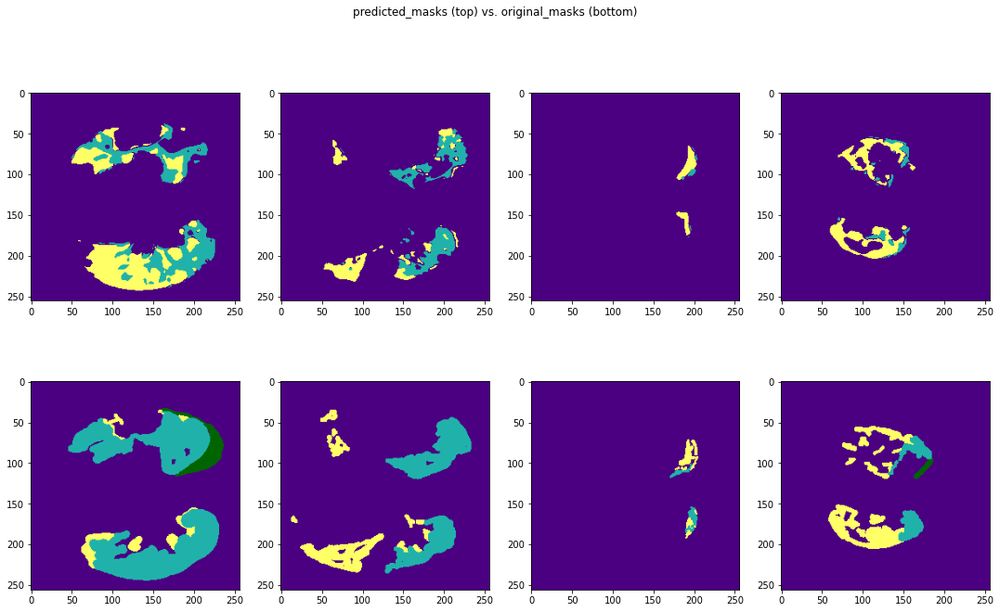

In [ ]:
plot_predictions(model, test_data)

In [ ]:
avgs.to_csv('/content/drive/Shareddrives/CIS 522 Final Project/Models/Metrics/UNet1Augment_average_per_class_scores.csv')